In [2]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns

# View max columns
pd.set_option('display.max_columns', None)

# View max rows
pd.set_option('display.max_rows', None)

# Reading in the Data

In [3]:
# Read in the data
data = pd.read_csv('final_data.csv')

# Replace the PWS_TYPE categories
data['PWS_TYPE'] = data['PWS_TYPE'].replace({'NTNCS': 'NTNCWS', 'TNCS': 'TNCWS'})

# View the data
data.head(20)

,PWS_ID,OWNER_TYPE,YEAR_FULL,COUNTY,PWS_TYPE,POPULATION,SERV_CON,SOURCE,WHOLESALER,FACILITIES,VIOLATIONS,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP,PERCENT_DEM,PERCENT_OTH,YEAR_FAC,YEAR
0,CA0103040,Private,2013,Alameda,CWS,100,19,GW,No,16,2,4,72112,0.125,5.08,59.5,0.1405,0.5643,0.2952,2013,1
1,CA0103040,Private,2014,Alameda,CWS,100,19,GW,No,8,2,5,73775,0.129,19.88,62.0,0.1372,0.5606,0.3022,2014,2
2,CA0103040,Private,2015,Alameda,CWS,100,19,GW,No,8,2,5,75619,0.125,10.39,61.1,0.1336,0.5523,0.3141,2015,3
3,CA0103040,Private,2016,Alameda,CWS,100,19,GW,No,8,2,5,79831,0.120,22.55,60.4,0.1297,0.5626,0.3077,2016,4
4,CA0103040,Private,2017,Alameda,CWS,50,19,GW,No,8,54,5,85743,0.113,24.97,60.5,0.1207,0.5760,0.3033,2017,5
5,CA0103040,Private,2018,Alameda,CWS,50,19,GW,No,8,54,6,92574,0.106,16.57,59.8,0.1173,0.5718,0.3110,2018,6
6,CA0103040,Private,2019,Alameda,CWS,50,19,GW,No,8,54,6,99406,0.099,22.29,59.7,0.1081,0.5541,0.3378,2019,7
7,CA0103040,Private,2020,Alameda,CWS,50,19,GW,No,8,54,6,104888,0.093,8.42,61.7,0.1090,0.5806,0.3104,2020,8
8,CA0103040,Private,2021,Alameda,CWS,50,19,GW,No,8,54,6,112017,0.089,17.96,60.4,0.1101,0.5959,0.2939,2021,9
9,CA0103040,Private,2022,Alameda,CWS,50,19,GW,No,8,54,7,122488,0.092,14.46,60.4,0.1088,0.6029,0.2883,2022,10


In [6]:
# Multi-index view of panel data
data_mult_idx = data.set_index(['PWS_ID', 'YEAR_FULL'])
data_mult_idx.head(20)

OWNER_TYPE   COUNTY PWS_TYPE  POPULATION  SERV_CON SOURCE  \
PWS_ID    YEAR_FULL                                                             
CA0103040 2013         Private  Alameda      CWS         100        19     GW   
          2014         Private  Alameda      CWS         100        19     GW   
          2015         Private  Alameda      CWS         100        19     GW   
          2016         Private  Alameda      CWS         100        19     GW   
          2017         Private  Alameda      CWS          50        19     GW   
          2018         Private  Alameda      CWS          50        19     GW   
          2019         Private  Alameda      CWS          50        19     GW   
          2020         Private  Alameda      CWS          50        19     GW   
          2021         Private  Alameda      CWS          50        19     GW   
          2022         Private  Alameda      CWS          50        19     GW   
CA0103041 2013         Private  Alameda      CWS         240       200     GW   
          2014         Private  Alameda      CWS         240       200     GW   
          2015         Private  Alameda      CWS         240       200     GW   
          2016         Private  Alameda      CWS         240       200     GW   
          2017         Private  Alameda      CWS         543       194     GW   
          2018         Private  Alameda      CWS         543       194     GW   
          2019         Private  Alameda      CWS         543       194     GW   
          2020         Private  Alameda      CWS         459       191     GW   
          2021         Private  Alameda      CWS         459       191     GW   
          2022         Private  Alameda      CWS         459       191     GW   

                    WHOLESALER  FACILITIES  VIOLATIONS  SITE_VISITS  \
PWS_ID    YEAR_FULL                                                   
CA0103040 2013              No          16           2            4   
          2014              No           8           2            5   
          2015              No           8           2            5   
          2016              No           8           2            5   
          2017              No           8          54            5   
          2018              No           8          54            6   
          2019              No           8          54            6   
          2020              No           8          54            6   
          2021              No           8          54            6   
          2022              No           8          54            7   
CA0103041 2013              No           7           3            5   
          2014              No           3           3            5   
          2015              No           3           3            6   
          2016              No           3           3            6   
          2017              No           3           3            6   
          2018              No           3           3            6   
          2019              No           3           3            7   
          2020              No           3           3            7   
          2021              No           3           3            7   
          2022              No           4           3            8   

                     MED_INCOME  POV_RATE  AVG_PRECIP  AVG_TEMP  PERCENT_REP  \
PWS_ID    YEAR_FULL                                                            
CA0103040 2013            72112     0.125        5.08      59.5       0.1405   
          2014            73775     0.129       19.88      62.0       0.1372   
          2015            75619     0.125       10.39      61.1       0.1336   
          2016            79831     0.120       22.55      60.4       0.1297   
          2017            85743     0.113       24.97      60.5       0.1207   
          2018            92574     0.106       16.57      59.8       0.1173   
          2019            99406   

In [8]:
# Desired orders for categorical variables
owner_type_order = ['Public', 'Private', 'PPP']
pws_type_order = ['CWS', 'NTNCWS', 'TNCWS']
primary_source_order = ['GW', 'SW', 'UNK']
is_wholesaler_order = ['No', 'Yes']

In [9]:
# Convert categorical variables to appropriate data types
data['OWNER_TYPE'] = pd.Categorical(data['OWNER_TYPE'], categories=owner_type_order, ordered=False)
data['PWS_TYPE'] = pd.Categorical(data['PWS_TYPE'], categories=pws_type_order, ordered=False)
data['SOURCE'] = pd.Categorical(data['SOURCE'], categories=primary_source_order, ordered=False)
data['WHOLESALER'] = pd.Categorical(data['WHOLESALER'], categories=is_wholesaler_order, ordered=False)
data['YEAR_FAC'] = data['YEAR_FAC'].astype('category')

# Completeness Check

In [10]:
# Double check that every water system has 10 years of data
counts = data.groupby('PWS_ID')['YEAR_FAC'].nunique()

missing_years = counts[counts != 10]

if not missing_years.empty:
    print("Water systems with missing year data:")
    print(missing_years)
else:
    print("All water systems have 10 years of data.")

All water systems have 10 years of data.


In [11]:
# Get count of missing entries for each column
missing_counts = data.isnull().sum()

print(missing_counts)

PWS_ID         0
OWNER_TYPE     0
YEAR_FULL      0
COUNTY         0
PWS_TYPE       0
POPULATION     0
SERV_CON       0
SOURCE         0
WHOLESALER     0
FACILITIES     0
VIOLATIONS     0
SITE_VISITS    0
MED_INCOME     0
POV_RATE       0
AVG_PRECIP     0
AVG_TEMP       0
PERCENT_REP    0
PERCENT_DEM    0
PERCENT_OTH    0
YEAR_FAC       0
YEAR           0
dtype: int64


# Overview of the Data

In [12]:
# Print the shape and dtypes
print(f"There are {data.shape[0]} rows and {data.shape[1]} columns.")
print(f"The data types are:\n{data.dtypes}")

There are 66770 rows and 21 columns.
The data types are:
PWS_ID           object
OWNER_TYPE     category
YEAR_FULL         int64
COUNTY           object
PWS_TYPE       category
POPULATION        int64
SERV_CON          int64
SOURCE         category
WHOLESALER     category
FACILITIES        int64
VIOLATIONS        int64
SITE_VISITS       int64
MED_INCOME        int64
POV_RATE        float64
AVG_PRECIP      float64
AVG_TEMP        float64
PERCENT_REP     float64
PERCENT_DEM     float64
PERCENT_OTH     float64
YEAR_FAC       category
YEAR              int64
dtype: object


In [13]:
# Count of unique water systems
print(f"There are {data['PWS_ID'].nunique()} unique water systems.")

There are 6677 unique water systems.


In [15]:
# Print unique values for OWNER_TYPE, PWS_TYPE, SOURCE, and WHOLESALER
print(f"Unique values for OWNER_TYPE: {data['OWNER_TYPE'].unique()}")
print(f"Unique values for PWS_TYPE: {data['PWS_TYPE'].unique()}")
print(f"Unique values for SOURCE: {data['SOURCE'].unique()}")
print(f"Unique values for WHOLESALER: {data['WHOLESALER'].unique()}")

Unique values for OWNER_TYPE: ['Private', 'Public', 'PPP']
Categories (3, object): ['Public', 'Private', 'PPP']
Unique values for PWS_TYPE: ['CWS', 'TNCWS', 'NTNCWS']
Categories (3, object): ['CWS', 'NTNCWS', 'TNCWS']
Unique values for SOURCE: ['GW', 'SW', 'UNK']
Categories (3, object): ['GW', 'SW', 'UNK']
Unique values for WHOLESALER: ['No', 'Yes']
Categories (2, object): ['No', 'Yes']


In [16]:
# Print value counts for PWS_TYPE, OWNER_TYPE, SOURCE, and WHOLESALER
print(f"Value counts for PWS_TYPE:\n{data['PWS_TYPE'].value_counts()}\n")
print(f"Value counts for OWNER_TYPE:\n{data['OWNER_TYPE'].value_counts()}\n")
print(f"Value counts for SOURCE:\n{data['SOURCE'].value_counts()}\n")
print(f"Value counts for WHOLESALER:\n{data['WHOLESALER'].value_counts()}")

Value counts for PWS_TYPE:
PWS_TYPE
CWS       28113
TNCWS     25874
NTNCWS    12783
Name: count, dtype: int64

Value counts for OWNER_TYPE:
OWNER_TYPE
Private    43493
Public     22425
PPP          852
Name: count, dtype: int64

Value counts for SOURCE:
SOURCE
GW     55668
SW     10048
UNK     1054
Name: count, dtype: int64

Value counts for WHOLESALER:
WHOLESALER
No     65872
Yes      898
Name: count, dtype: int64


In [17]:
# Print value counts for PWS_TYPE, OWNER_TYPE, SOURCE, and WHOLESALER
print(f"Value counts for PWS_TYPE:\n{data['PWS_TYPE'].value_counts(normalize=True)}\n")
print(f"Value counts for OWNER_TYPE:\n{data['OWNER_TYPE'].value_counts(normalize=True)}\n")
print(f"Value counts for SOURCE:\n{data['SOURCE'].value_counts(normalize=True)}\n")
print(f"Value counts for WHOLESALER:\n{data['WHOLESALER'].value_counts(normalize=True)}")

Value counts for PWS_TYPE:
PWS_TYPE
CWS       0.421042
TNCWS     0.387509
NTNCWS    0.191448
Name: proportion, dtype: float64

Value counts for OWNER_TYPE:
OWNER_TYPE
Private    0.651385
Public     0.335854
PPP        0.012760
Name: proportion, dtype: float64

Value counts for SOURCE:
SOURCE
GW     0.833728
SW     0.150487
UNK    0.015786
Name: proportion, dtype: float64

Value counts for WHOLESALER:
WHOLESALER
No     0.986551
Yes    0.013449
Name: proportion, dtype: float64


# Descriptive Statistics

## Overall Stats

In [18]:
# List of numeric columns for analysis
numeric_columns = ['VIOLATIONS', 'POPULATION', 'SERV_CON', 'FACILITIES', 'SITE_VISITS',
                   'MED_INCOME', 'POV_RATE', 'AVG_PRECIP', 'AVG_TEMP', 'PERCENT_REP']

In [20]:
# Overall summary statistics
print("Overall Summary Statistics:")
data[numeric_columns].describe().round(2)

Overall Summary Statistics:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
count,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00
mean,9.79,6363.81,1455.63,8.95,12.15,64089.07,0.16,21.13,60.09,0.32
std,13.11,65133.90,12534.45,23.31,14.06,17748.36,0.05,16.09,5.08,0.09
min,0.00,0.00,0.00,0.00,0.00,34974.00,0.05,2.06,43.50,0.06
25%,2.00,50.00,2.00,3.00,5.00,51457.00,0.12,9.56,57.30,0.24
50%,5.00,125.00,16.00,4.00,8.00,60704.00,0.15,16.12,60.20,0.33
75%,12.00,440.00,80.00,7.00,14.00,73518.00,0.19,28.74,63.40,0.40
max,278.00,4085000.00,727143.00,1784.00,287.00,153792.00,0.28,97.59,76.50,0.55


## By One Factor

In [21]:
# Summary statistics by OWNER_TYPE
print("Summary Statistics by Owner Type:")
data.groupby('OWNER_TYPE')[numeric_columns].describe().round(2)

Summary Statistics by Owner Type:


VIOLATIONS                                           POPULATION  \
                count   mean    std  min  25%  50%   75%    max      count   
OWNER_TYPE                                                                   
Public        22425.0   8.28  13.33  0.0  1.0  4.0   9.0  278.0    22425.0   
Private       43493.0  10.57  12.93  0.0  2.0  6.0  14.0  145.0    43493.0   
PPP             852.0  10.09  13.14  0.0  2.0  6.0  13.0   96.0      852.0   

                                                                        \
                mean        std   min    25%    50%     75%        max   
OWNER_TYPE                                                               
Public      15530.43  108451.08   0.0  100.0  370.0  3072.0  4085000.0   
Private      1757.86   19583.73   0.0   45.0  100.0   228.0  1007514.0   
PPP           219.37     462.55  25.0   40.0  100.0   200.0     2800.0   

           SERV_CON                                                       \
              count     mean       std  min  25%   50%     75%       max   
OWNER_TYPE                                                                 
Public      22425.0  3518.63  20580.49  0.0  3.0  24.0  768.00  727143.0   
Private     43493.0   419.97   4417.12  0.0  2.0  15.0   50.00  225800.0   
PPP           852.0    25.61     54.80  1.0  1.0   5.0   21.25     501.0   

           FACILITIES                                             SITE_VISITS  \
                count   mean    std  min  25%   50%   75%     max       count   
OWNER_TYPE                                                                      
Public        22425.0  13.42  34.60  0.0  3.0   5.0  11.0  1784.0     22425.0   
Private       43493.0   6.62  14.15  0.0  3.0   4.0   6.0   786.0     43493.0   
PPP             852.0   9.83   7.30  0.0  3.0  10.0  15.0    51.0       852.0   

                                                     MED_INCOME            \
             mean    std  min  25%  50%   75%    max      count      mean   
OWNER_TYPE                                                                  
Public      13.19  15.91  0.0  6.0  9.0  16.0  287.0    22425.0  63279.12   
Private     11.70  13.09  0.0  5.0  8.0  13.0  202.0    43493.0  64675.98   
PPP          7.63   5.15  0.0  5.0  6.0   9.0   51.0      852.0  55446.98   

                                                                   POV_RATE  \
                 std      min      25%      50%      75%       max    count   
OWNER_TYPE                                                                    
Public      18340.56  34974.0  50125.0  58861.0  71358.0  153792.0  22425.0   
Private     17447.78  34974.0  52874.0  61276.0  73814.0  153792.0  43493.0   
PPP         13550.22  41924.0  45742.0  51261.0  57585.0  124055.0    852.0   

                                                     AVG_PRECIP                \
            mean   std   min   25%   50%   75%   max      count   mean    std   
OWNER_TYPE                                                                      
Public      0.16  0.05  0.05  0.12  0.16  0.20  0.28    22425.0  21.26  16.59   
Private     0.16  0.05  0.05  0.12  0.15  0.19  0.28    43493.0  21.05  15.90   
PPP         0.20  0.05  0.07  0.18  0.21  0.23  0.28      852.0  21.92  12.31   

                                             AVG_TEMP                     \
             min    25%    50%    75%    max    count   mean   std   min   
OWNER_TYPE                                                                 
Public      2.06   9.28  16.04  29.23  97.59  22425.0  59.77  5.61  43.5   
Private     2.06   9.56  16.14  28.67  97.59  43493.0  60.28  4.81  43.5   
PPP         3.12  14.42  20.72  26.34  75.84    852.0  58.70  3.26  47.9   

                                    PERCENT_REP                                \
             25%   50%    75%   max       count  mean   std   min   25%   50%   
OWNER_TYPE                                                                      
Public      56.4  60.0  63.4

In [22]:
# Function to plot VIOLATIONS by a specified grouping variable
def plot_violations(data, group_by, cmap_name='tab20'):
    # Compute the average number of violations by the specified grouping variable
    avg_violations = data.groupby(group_by)['VIOLATIONS'].mean().sort_values()

    # Get a colormap and determine whether to use it or a single color
    cmap = plt.get_cmap(cmap_name)
    num_colors = cmap.N
    num_groups = len(avg_violations)

    # Conditional check for color application
    if num_groups > num_colors:
        color = 'skyblue'
    else:
        color = [cmap(i) for i in range(num_groups)]

    # Plot the average violations as a bar chart
    plt.figure(figsize=(10, 6))
    avg_violations.plot(kind='bar', color=color)

    # Function to convert snake_case to Capital Case
    def format_title(text):
        return ' '.join(word.capitalize() for word in text.split('_'))

    plt.xlabel(format_title(group_by))
    plt.ylabel('Average Violations')
    plt.title(f'Average Violations by {format_title(group_by)}')

    # Adjust x-tick labels for better readability
    if num_groups > 20:
        plt.xticks(rotation=90, ha='right')
    elif num_groups > 5:
        plt.xticks(rotation=45, ha='right')
    else:
        plt.xticks(rotation=0)

    plt.tight_layout()
    plt.show()

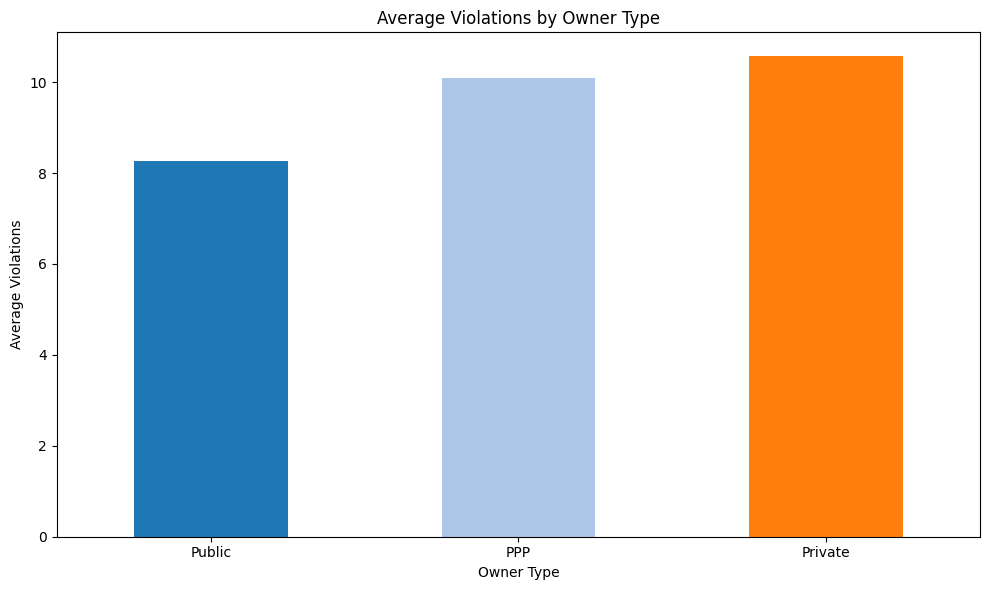

In [23]:
# Plot average violations by owner_type
plot_violations(data, 'OWNER_TYPE')

In [25]:
# Summary statistics by YEAR
print("Summary Statistics by Year:")
data.groupby('YEAR_FAC')[numeric_columns].describe().T.round(2)

Summary Statistics by Year:


YEAR_FAC                 2013        2014        2015        2016        2017  \
VIOLATIONS  count     6677.00     6677.00     6677.00     6677.00     6677.00   
            mean         8.44       10.11        8.64        9.15        9.48   
            std         10.58       12.47       11.26       11.94       12.38   
            min          0.00        0.00        0.00        0.00        0.00   
            25%          2.00        2.00        2.00        2.00        2.00   
            50%          5.00        6.00        5.00        5.00        5.00   
            75%         11.00       13.00       11.00       11.00       12.00   
            max        152.00      149.00      149.00      149.00      149.00   
POPULATION  count     6677.00     6677.00     6677.00     6677.00     6677.00   
            mean      6329.19     6312.32     6253.63     6384.57     6407.49   
            std      70850.75    63445.82    63539.51    64368.64    64363.21   
            min          0.00        0.00        0.00        0.00        0.00   
            25%         50.00       50.00       50.00       50.00       50.00   
            50%        120.00      120.00      125.00      125.00      122.00   
            75%        400.00      420.00      438.00      445.00      420.00   
            max    3855879.00  3894439.00  3935257.00  3987622.00  4061504.00   
SERV_CON    count     6677.00     6677.00     6677.00     6677.00     6677.00   
            mean      1423.41     1428.91     1445.29     1448.24     1453.73   
            std      12432.00    12463.82    12382.58    12322.88    12301.08   
            min          0.00        1.00        1.00        1.00        1.00   
            25%          2.00        2.00        2.00        2.00        2.00   
            50%         15.00       15.00       15.00       15.00       15.00   
            75%         78.00       79.00       80.00       80.00       80.00   
            max     697501.00   697501.00   690547.00   679740.00   670323.00   
FACILITIES  count     6677.00     6677.00     6677.00     6677.00     6677.00   
            mean        14.01        8.61        8.27        8.34        8.47   
            std         41.64       20.30       20.41       20.55       20.62   
            min          0.00        0.00        0.00        0.00        1.00   
            25%          3.00        3.00        3.00        3.00        3.00   
            50%          6.00        5.00        4.00        4.00        4.00   
            75%         11.00        7.00        7.00        7.00        7.00   
            max       1784.00      951.00      960.00      970.00      970.00   
SITE_VISITS count     6677.00     6677.00     6677.00     6677.00     6677.00   
            mean        10.19       15.01       10.56       11.27       11.57   
            std         12.78       18.82       12.96       13.37       13.35   
            min          0.00        0.00        0.00        0.00        0.00   
            25%          4.00        5.00        4.00        4.00        5.00   
            50%          7.00       10.00        7.00        7.00        8.00   
            75%         12.00       18.00       12.00       13.00       13.00   
            max        284.00      284.00      285.00      285.00      285.00   
MED_INCOME  count     6677.00     6677.00     6677.00     6677.00     6677.00   
            mean     55118.78    55390.23    55431.95    57192.17    60135.83   
            std      11654.94    11968.13    12409.44    13309.91    14223.49   
            min      36212.00    35997.00    34974.00    35270.00    36563.00   
            25%      45563.00    45490.00    45233.00    45963.00    48730.00   
            50%      54090.00    54100.00    53433.00    55045.00    57813.00   
            75%      62779.00    63409.00    63985.00    65161.00    68023.00   
            max      91702.00    93854.00    96310.00   101173.00   106761.00   
POV_RATE    count     6677.00  

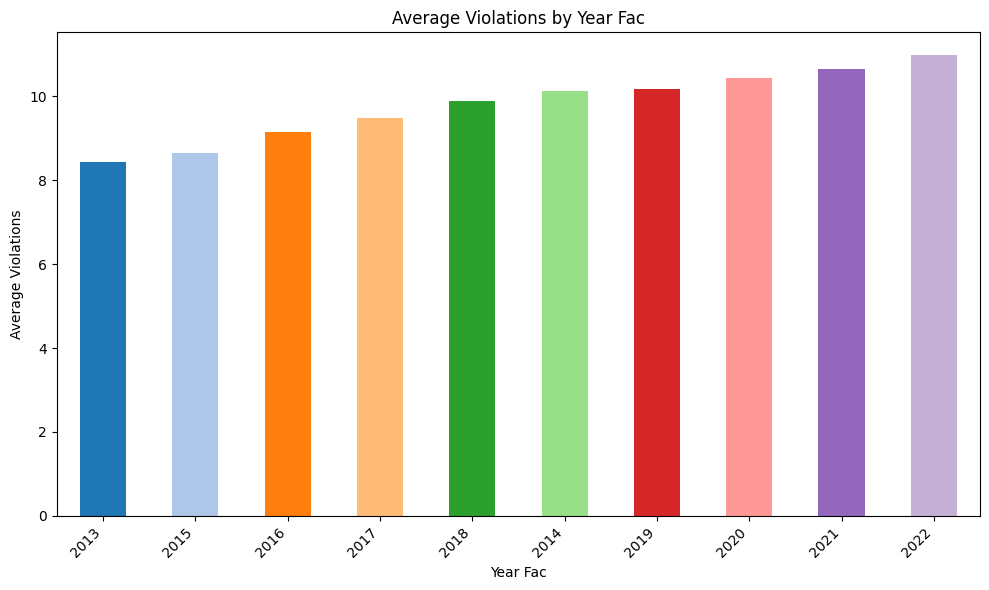

In [26]:
# Plot average violations by YEAR
plot_violations(data, 'YEAR_FAC')

In [27]:
# Summary statistics by COUNTY
print("Summary Statistics by County Served:")
data.groupby('COUNTY')[numeric_columns].describe().round(2)

Summary Statistics by County Served:


VIOLATIONS                                               \
                     count   mean    std  min   25%   50%    75%    max   
COUNTY                                                                    
Alameda              210.0   5.45  11.28  0.0  0.00   1.0   3.00   54.0   
Alpine               410.0   4.20   8.24  0.0  0.00   1.0   2.00   29.0   
Amador               610.0   7.42   7.97  0.0  3.00   6.0   9.00   51.0   
Butte                830.0   7.83   9.41  0.0  2.00   5.0   9.00   86.0   
Calaveras            470.0  10.51   7.58  1.0  5.00   9.0  14.00   42.0   
Colusa               250.0   3.16   7.18  0.0  0.00   1.0   3.00   59.0   
Contra Costa         860.0   7.69   7.06  0.0  2.00   6.0  12.00   45.0   
Del Norte            310.0   7.37   8.89  0.0  1.00   4.0  10.00   39.0   
El Dorado           1210.0  10.58  10.22  0.0  4.00   8.0  12.00   77.0   
Fresno              3060.0  15.58  16.67  0.0  5.00  10.0  21.00  122.0   
Glenn                310.0   3.51   2.93  0.0  1.00   3.0   5.00   15.0   
Humboldt             850.0  12.22  14.05  0.0  2.00   6.0  17.00   63.0   
Imperial             720.0  10.52  12.86  0.0  2.00   6.0  13.00   61.0   
Inyo                1100.0   7.57  13.17  0.0  1.00   3.5   8.00  108.0   
Kern                3130.0  16.04  17.57  0.0  5.00  10.5  20.00  132.0   
Kings                300.0  19.65  26.93  0.0  2.00   8.0  27.00  113.0   
Lake                 750.0  10.59  10.83  0.0  2.00   6.0  18.00   49.0   
Lassen               330.0   5.04   3.80  0.0  2.00   5.0   7.00   15.0   
Los Angeles         2800.0   5.64   9.85  0.0  1.00   3.0   6.00  145.0   
Madera              1870.0  13.55  16.80  0.0  3.00   8.0  16.00  112.0   
Marin                480.0   6.95  11.85  0.0  1.00   2.0   7.00   54.0   
Mariposa             640.0   5.16   7.81  0.0  1.00   3.0   6.00   51.0   
Mendocino           1110.0   6.93   9.60  0.0  2.00   5.0   8.00   92.0   
Merced               840.0   5.56   5.99  0.0  1.00   4.0   7.00   38.0   
Modoc                 90.0   5.44   3.38  1.0  3.00   5.0   7.00   15.0   
Mono                 840.0  15.88  11.25  0.0  6.00  14.0  25.00   54.0   
Monterey            2990.0  15.96  13.79  0.0  6.00  12.5  21.00  105.0   
Napa                1440.0   7.11   7.42  0.0  2.00   5.0   9.00   44.0   
Nevada               740.0   7.84   8.97  0.0  2.00   5.0  10.00   52.0   
Orange               460.0   4.00   6.78  0.0  1.00   2.0   5.00   48.0   
Placer              1160.0   6.81  10.02  0.0  1.00   3.0   7.00   60.0   
Plumas              1040.0   8.89  10.54  0.0  2.00   4.0  13.00   48.0   
Riverside           1930.0  15.57  17.07  0.0  5.00  11.0  19.00  152.0   
Sacramento          1610.0   6.81   9.89  0.0  1.00   3.0   8.00   69.0   
San Benito           580.0  11.89   9.50  0.0  5.00  10.0  16.00   43.0   
San Bernardino      3120.0   6.55  10.91  0.0  1.00   3.0   6.00   83.0   
San Diego           1870.0  10.45  12.78  0.0  3.00   7.0  14.00   86.0   
San Francisco         80.0   3.79   2.01  0.0  2.75   4.0   5.00    7.0   
San Joaquin         2970.0   9.04   8.79  0.0  3.00   7.0  12.00   62.0   
San Luis Obispo     1340.0   4.13   6.88  0.0  1.00   2.0   4.00   46.0   
San Mateo            500.0  14.35  17.96  0.0  3.00   5.0  25.00   87.0   
Santa Barbara       1280.0   6.79  12.72  0.0  1.00   3.0   6.00   74.0   
Santa Clara         1140.0  10.37  12.11  0.0  3.00   6.0  14.25   72.0   
Santa Cruz           890.0  13.26  16.64  0.0  5.00   8.0  16.00  133.0   
Shasta              1670.0   7.62  12.92  0.0  2.00   4.0   8.00  119.0   
Sierra               300.0  16.09  15.53  0.0  3.00  11.0  28.00   58.0   
Siskiyou             720.0   7.51   8.99  0.0  1.00   4.0   9.00   37.0   
Solano               610.0   3.82   7.02  0.0  1.00   2.0   4.00   45.0   
Sonoma              3930.0   7.38  13.40  0.0  2.00   5.0   9.00  278.0   
Stanislaus          1880.0   7.83  10.26  0.0  2.00   5.0  10.00   67.0   
Sutter               340.0  14.16  13.23 

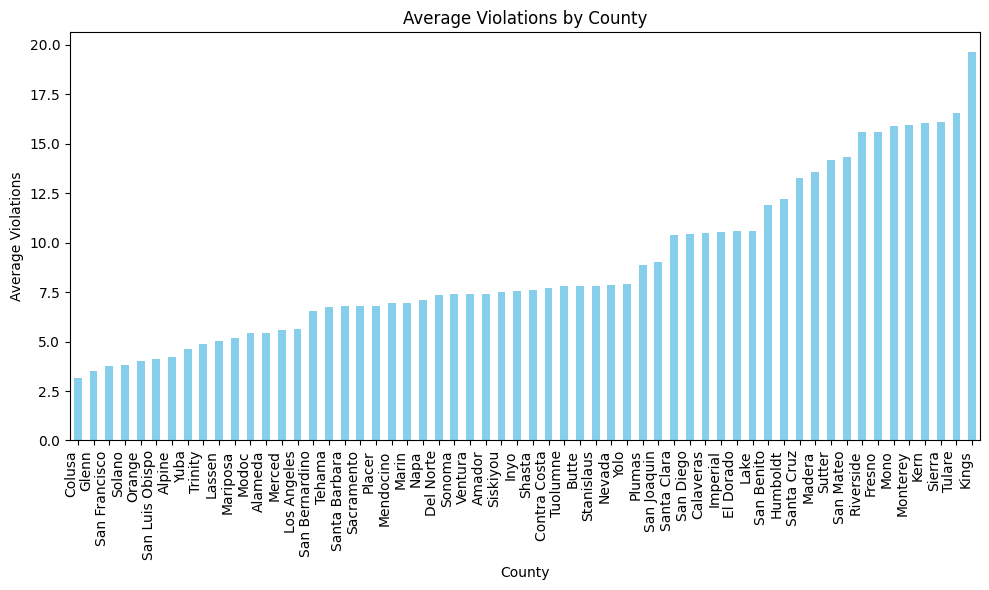

In [28]:
# Plot average violations by COUNTY
plot_violations(data, 'COUNTY')

In [29]:
# Summary statistics by PWS_TYPE
print("Summary Statistics by PWS Type:")
data.groupby('PWS_TYPE')[numeric_columns].describe().round(2)

Summary Statistics by PWS Type:


VIOLATIONS                                           POPULATION  \
              count   mean    std  min  25%  50%   75%    max      count   
PWS_TYPE                                                                   
CWS         28113.0  12.69  16.33  0.0  3.0  7.0  15.0  278.0    28113.0   
NTNCWS      12783.0   8.93  10.93  0.0  2.0  5.0  11.0  122.0    12783.0   
TNCWS       25874.0   7.07   8.83  0.0  1.0  4.0   9.0   98.0    25874.0   

                                                                  SERV_CON  \
              mean       std  min   25%    50%     75%        max    count   
PWS_TYPE                                                                     
CWS       14670.54  99757.74  0.0  90.0  286.0  2740.0  4085000.0  28113.0   
NTNCWS      379.89   2594.17  0.0  50.0  100.0   275.0   149796.0  12783.0   
TNCWS       294.60   1599.55  2.0  30.0   80.0   200.0   100003.0  25874.0   

                                                              FACILITIES  \
             mean       std  min   25%   50%    75%       max      count   
PWS_TYPE                                                                   
CWS       3437.46  19140.75  0.0  34.0  99.0  854.0  727143.0    28113.0   
NTNCWS      11.17     95.96  0.0   1.0   3.0    7.0    5651.0    12783.0   
TNCWS       15.95     46.57  1.0   1.0   3.0   14.0    3000.0    25874.0   

                                                    SITE_VISITS                \
           mean    std  min  25%  50%   75%     max       count   mean    std   
PWS_TYPE                                                                        
CWS       14.77  34.85  0.0  4.0  6.0  13.0  1784.0     28113.0  15.22  16.84   
NTNCWS     5.39   4.48  0.0  3.0  4.0   6.0    55.0     12783.0  11.85  13.92   
TNCWS      4.37   2.94  0.0  3.0  3.0   5.0    74.0     25874.0   8.96   9.27   

                                      MED_INCOME                               \
          min  25%   50%   75%    max      count      mean       std      min   
PWS_TYPE                                                                        
CWS       0.0  7.0  11.0  17.0  287.0    28113.0  65007.85  18630.34  34974.0   
NTNCWS    0.0  4.0   8.0  13.0  176.0    12783.0  63596.03  17229.25  34974.0   
TNCWS     0.0  4.0   6.0  10.0  198.0    25874.0  63334.38  16956.72  34974.0   

                                              POV_RATE                    \
              25%      50%      75%       max    count  mean   std   min   
PWS_TYPE                                                                   
CWS       52479.0  60889.0  74872.0  153792.0  28113.0  0.16  0.05  0.05   
NTNCWS    50960.0  60239.0  71769.0  153792.0  12783.0  0.16  0.05  0.05   
TNCWS     51199.0  60509.0  71379.0  153792.0  25874.0  0.16  0.05  0.05   

                                 AVG_PRECIP                                    \
           25%   50%   75%   max      count   mean    std   min    25%    50%   
PWS_TYPE                                                                        
CWS       0.12  0.15  0.19  0.28    28113.0  20.07  15.83  2.06   8.07  14.47   
NTNCWS    0.12  0.16  0.20  0.28    12783.0  19.83  14.48  2.06   9.68  15.78   
TNCWS     0.11  0.15  0.19  0.28    25874.0  22.92  16.95  2.06  10.12  17.77   

                       AVG_TEMP                                             \
            75%    max    count   mean   std   min   25%   50%   75%   max   
PWS_TYPE                                                                     
CWS       26.65  97.59  28113.0  60.63  4.80  43.5  57.8  60.6  63.6  76.5   
NTNCWS    25.30  97.59  12783.0  60.61  4.32  43.5  57.8  60.5  63.3  76.5   
TNCWS     32.34  97.59  25874.0  59.25  5.60  43.5  56.3  59.4  63.1  76.5   

         PERCENT_REP                                            
               count  mean   std   min   25%   50%   75%   max  
PWS_TYPE                                                        
CWS          28113.0  0.31  0.09  0.06  0.22

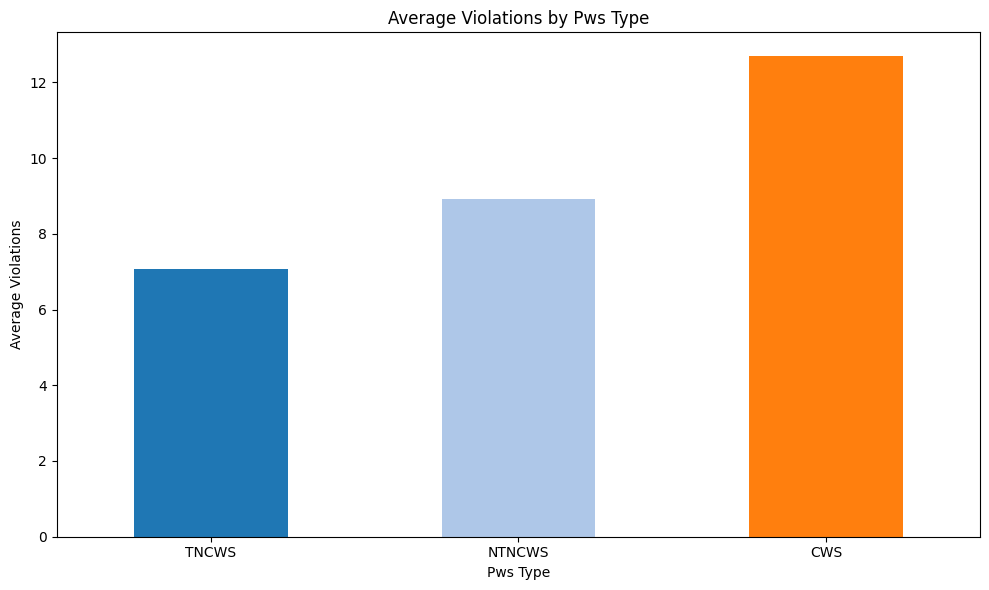

In [30]:
# Plot average violations by PWS_TYPE
plot_violations(data, 'PWS_TYPE')

In [31]:
# Summary statistics by SOURCE
print("Summary Statistics by Primary Source:")
data.groupby('SOURCE')[numeric_columns].describe().round(2)

Summary Statistics by Primary Source:


VIOLATIONS                                           POPULATION  \
            count   mean    std  min  25%  50%   75%    max      count   
SOURCE                                                                   
GW        55668.0   9.57  12.40  0.0  2.0  6.0  12.0  278.0    55668.0   
SW        10048.0  10.94  16.19  0.0  1.0  4.0  13.0  133.0    10048.0   
UNK        1054.0  10.73  15.85  0.0  2.0  6.0  13.0  121.0     1054.0   

                                                                        \
            mean        std   min     25%     50%       75%        max   
SOURCE                                                                   
GW       1449.64    9119.06   0.0   50.00   100.0    300.00   297500.0   
SW      33780.38  163592.69   0.0  166.00  1350.0  16226.25  4085000.0   
UNK      4542.48   28398.59  10.0   66.25   150.0    368.00   312214.0   

       SERV_CON                                                         \
          count     mean       std  min   25%    50%     75%       max   
SOURCE                                                                   
GW      55668.0   352.66   2507.69  0.0   2.0   10.0    49.0  110974.0   
SW      10048.0  7594.11  30982.83  1.0  26.0  334.0  4483.0  727143.0   
UNK      1054.0  1190.98   6841.44  0.0   3.0   18.0    63.0   66253.0   

       FACILITIES                                            SITE_VISITS  \
            count   mean    std  min  25%  50%   75%     max       count   
SOURCE                                                                     
GW        55668.0   6.87  12.38  1.0  3.0  4.0   7.0   722.0     55668.0   
SW        10048.0  20.36  50.61  1.0  4.0  7.0  18.0  1784.0     10048.0   
UNK        1054.0   9.80  21.04  0.0  3.0  5.0   8.0   221.0      1054.0   

                                                  MED_INCOME            \
         mean    std  min  25%   50%   75%    max      count      mean   
SOURCE                                                                   
GW      11.15  12.27  0.0  5.0   8.0  12.0  222.0    55668.0  63298.22   
SW      17.96  20.81  0.0  8.0  14.0  21.0  287.0    10048.0  67974.71   
UNK      9.43   7.97  0.0  5.0   7.0  12.0   62.0     1054.0  68815.97   

                                                               POV_RATE        \
             std      min      25%      50%      75%       max    count  mean   
SOURCE                                                                          
GW      16798.71  34974.0  51261.0  60164.0  71358.0  153792.0  55668.0  0.16   
SW      21840.51  34974.0  52901.0  63409.0  78980.0  153792.0  10048.0  0.15   
UNK     17457.28  35578.0  58582.0  66676.0  76943.0  149907.0   1054.0  0.14   

                                           AVG_PRECIP                      \
         std   min   25%   50%   75%   max      count   mean    std   min   
SOURCE                                                                      
GW      0.05  0.05  0.12  0.16  0.20  0.28    55668.0  21.01  15.89  2.06   
SW      0.05  0.05  0.11  0.15  0.19  0.28    10048.0  21.42  17.02  2.06   
UNK     0.04  0.05  0.10  0.13  0.16  0.28     1054.0  24.64  17.35  2.06   

                                   AVG_TEMP                                 \
          25%    50%    75%    max    count   mean   std   min   25%   50%   
SOURCE                                                                       
GW       9.56  16.14  27.87  97.59  55668.0  60.01  5.02  43.5  57.3  60.2   
SW       9.08  15.50  30.01  97.59  10048.0  60.57  5.46  43.5  57.2  60.2   
UNK     12.07  20.32  34.53  97.59   1054.0  59.76  4.18  43.6  57.9  59.7   

                   PERCENT_REP                                            
         75%   max       count  mean   std   min   25%   50%   75%   max  
SOURCE                                                                    
GW      63.4  76.5     55668.0  0.33  0.09  0.11  0.25  0.34  0.40  0.55  
SW      63.6  76.5     10048.0  0.29  0.10  0.06  0

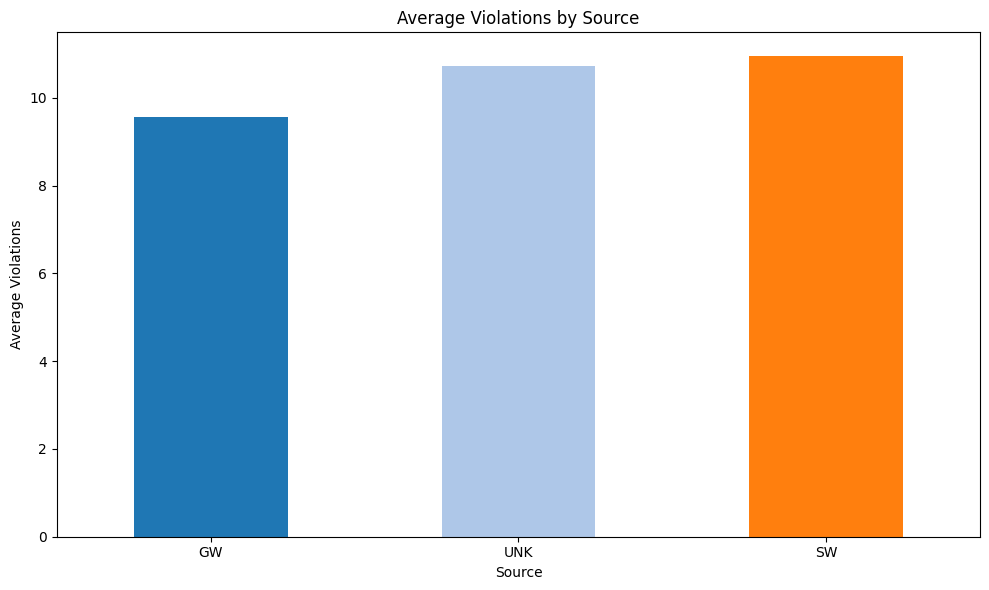

In [32]:
# Plot average violations by SOURCE
plot_violations(data, 'SOURCE')

## By Two Factors

In [34]:
# Summary statistics by OWNER_TYPE and YEAR
print("Summary Statistics by Owner Type and Year:")
data.groupby(['OWNER_TYPE', 'YEAR_FAC'])[numeric_columns].describe().round(2)

Summary Statistics by Owner Type and Year:


VIOLATIONS                                             \
                         count   mean    std  min  25%  50%    75%    max   
OWNER_TYPE YEAR_FAC                                                         
Public     2013         2196.0   6.96  10.44  0.0  1.0  4.0   8.00  152.0   
           2014         2214.0   7.93  11.54  0.0  1.0  4.0  10.00  149.0   
           2015         2229.0   7.31  11.36  0.0  1.0  4.0   8.00  149.0   
           2016         2250.0   7.75  11.88  0.0  1.0  4.0   9.00  149.0   
           2017         2246.0   8.06  12.28  0.0  1.0  4.0   9.00  149.0   
           2018         2248.0   8.49  14.12  0.0  1.0  4.0   9.00  276.0   
           2019         2247.0   8.72  14.54  0.0  1.0  4.0  10.00  276.0   
           2020         2265.0   8.95  14.86  0.0  2.0  4.0  10.00  276.0   
           2021         2265.0   9.09  15.11  0.0  2.0  4.0  10.00  277.0   
           2022         2265.0   9.42  15.67  0.0  2.0  5.0  10.00  278.0   
Private    2013         4414.0   9.17  10.54  0.0  2.0  6.0  12.00  101.0   
           2014         4400.0  11.20  12.74  0.0  3.0  7.0  15.00  130.0   
           2015         4308.0   9.31  11.13  0.0  2.0  5.0  12.00   99.0   
           2016         4286.0   9.85  11.86  0.0  2.0  6.0  13.00  113.0   
           2017         4290.0  10.19  12.35  0.0  2.0  6.0  13.00  117.0   
           2018         4289.0  10.58  13.06  0.0  2.0  6.0  13.00  121.0   
           2019         4290.0  10.91  13.59  0.0  3.0  6.0  14.00  125.0   
           2020         4406.0  11.20  13.95  0.0  3.0  7.0  14.00  131.0   
           2021         4405.0  11.45  14.35  0.0  3.0  7.0  14.00  145.0   
           2022         4405.0  11.77  14.70  0.0  3.0  7.0  15.00  145.0   
PPP        2013           67.0   9.18  12.47  0.0  1.5  5.0  11.00   60.0   
           2014           63.0  10.86  14.77  0.0  2.0  6.0  12.00   72.0   
           2015          140.0   9.32  11.90  0.0  2.0  6.0  11.00   72.0   
           2016          141.0  10.10  13.23  0.0  2.0  6.0  13.00   95.0   
           2017          141.0  10.17  13.16  0.0  2.0  6.0  13.00   96.0   
           2018          140.0  10.46  13.67  0.0  2.0  6.0  13.00   96.0   
           2019          140.0  10.76  14.07  0.0  2.0  6.0  13.00   96.0   
           2020            6.0   8.50   7.31  2.0  2.5  6.0  14.75   18.0   
           2021            7.0   7.57   7.11  2.0  2.0  4.0  12.50   18.0   
           2022            7.0   8.29   6.70  2.0  3.0  7.0  12.50   18.0   

                    POPULATION                                           \
                         count      mean        std   min    25%    50%   
OWNER_TYPE YEAR_FAC                                                       
Public     2013         2196.0  15858.89  120115.50   0.0  100.0  350.0   
           2014         2214.0  15645.70  106082.73   0.0  100.0  359.0   
           2015         2229.0  15398.08  106135.89   0.0  100.0  365.0   
           2016         2250.0  15512.46  106899.38   0.0  100.0  371.0   
           2017         2246.0  15586.18  106900.02   0.0  100.0  357.0   
           2018         2248.0  15552.65  107311.20   0.0  100.0  360.0   
           2019         2247.0  15428.75  107617.04   0.0  100.0  375.0   
           2020         2265.0  14889.80  105058.99   0.0  100.0  375.0   
           2021         2265.0  15183.27  105254.79   0.0  100.0  380.0   
           2022         2265.0  16258.73  112699.76   0.0  104.0  400.0   
Private    2013         4414.0   1680.45   18718.16   0.0   40.0   94.5   
           2014         4400.0   1702.67   19545.85   0.0   43.0  100.0   
           2015         4308.0   1718.37   19120.68   0.0   45.0  100.0   
           2016         4286.0   1795.94   19784.76   0.0   45.0  100.0   
           2017         4290.0   1805.98   20000.23   0.0   44.0   99.0   
           2018         4289.0   1831.19   20192.45   0.0   45.0  100.0   
           2019         4290.0   1835.15   20299.19  

In [37]:
# Function to plot numeric variables over time
def plot_over_time_grid(data, columns, group_by='OWNER_TYPE', num_cols=2):
    num_plots = len(columns)
    num_rows = (num_plots + num_cols - 1) // num_cols

    plt.figure(figsize=(20, 6 * num_rows))

    unique_values = data[group_by].unique()

    for i, column in enumerate(columns):
        plt.subplot(num_rows, num_cols, i + 1)
        for value in unique_values:
            subset = data[data[group_by] == value]
            yearly_averages = subset.groupby('YEAR_FAC')[column].mean()
            plt.plot(yearly_averages.index, yearly_averages, label=value)

        years = sorted(data['YEAR_FAC'].unique())

        plt.xticks(years, rotation=45)
        plt.xlabel('Year')
        plt.ylabel(f'Average {column}')
        plt.title(f'{column} Over Time by {group_by}')
        plt.legend(title=group_by)

    plt.tight_layout()
    plt.show()

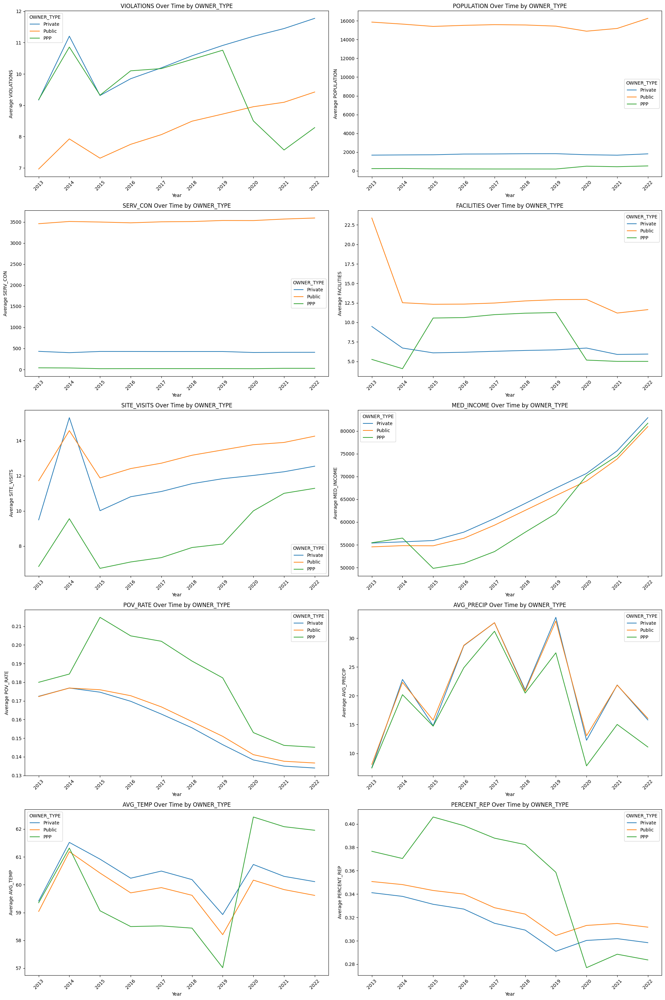

In [38]:
# Call the function with the data and columns
plot_over_time_grid(data, numeric_columns, group_by='OWNER_TYPE', num_cols=2)

In [41]:
# Function to plot grouped bar chart over years
def plot_grouped_bar_chart_over_time(data, group_var, response_var):
    plt.figure(figsize=(12, 6))

    # Generate color palette
    unique_groups = data[group_var].unique()
    colors = plt.get_cmap('tab10').colors[:len(unique_groups)]

    # Calculate the width of each bar
    bar_width = 0.8 / len(unique_groups)

    # Create a dictionary to store the bar positions for each group
    bar_positions = {group: i for i, group in enumerate(unique_groups)}

    # Iterate over each year
    for year in data['YEAR_FAC'].unique():
        year_data = data[data['YEAR_FAC'] == year]

        # Iterate over each group
        for group in unique_groups:
            group_data = year_data[year_data[group_var] == group]
            mean_response = group_data[response_var].mean()

            # Calculate the position of the bar for the current group and year
            bar_pos = year + bar_positions[group] * bar_width - 0.4

            # Plot the bar for the current group and year
            plt.bar(bar_pos, mean_response, width=bar_width, color=colors[bar_positions[group]], label=group if year == data['YEAR_FULL'].min() else "")

    plt.xlabel('Year', fontsize=12)
    plt.ylabel(f'Mean {response_var.capitalize()}', fontsize=12)
    plt.xticks(data['YEAR_FAC'].unique(), fontsize=10, rotation=45)
    plt.yticks(fontsize=10)
    plt.legend(title=group_var.replace('_', ' ').title(), fontsize=10, title_fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.tight_layout()
    plt.show()

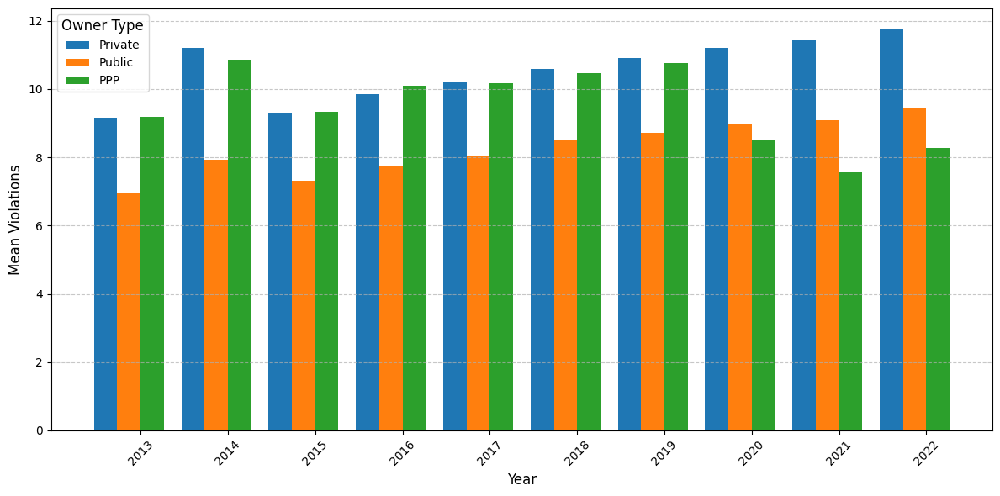

In [42]:
# Use the function
plot_grouped_bar_chart_over_time(data, 'OWNER_TYPE', 'VIOLATIONS')

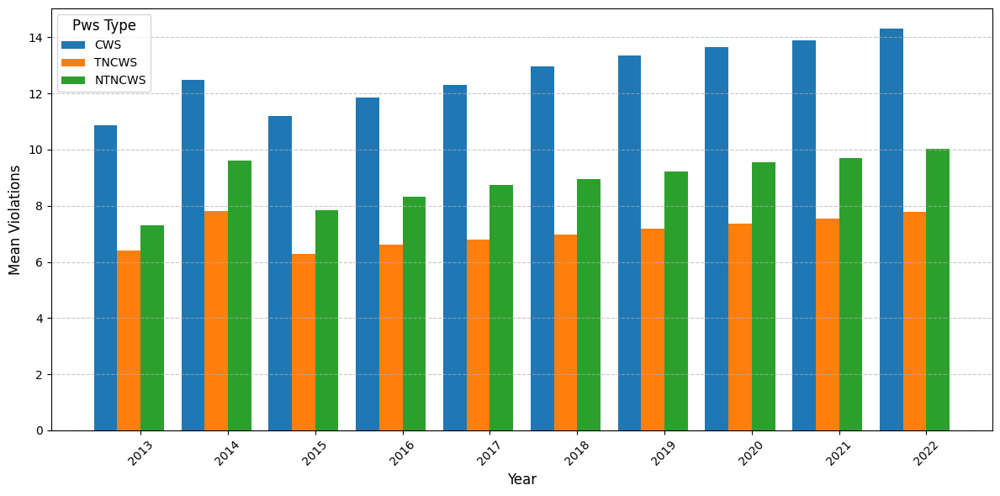

In [43]:
# Use the function
plot_grouped_bar_chart_over_time(data, 'PWS_TYPE', 'VIOLATIONS')

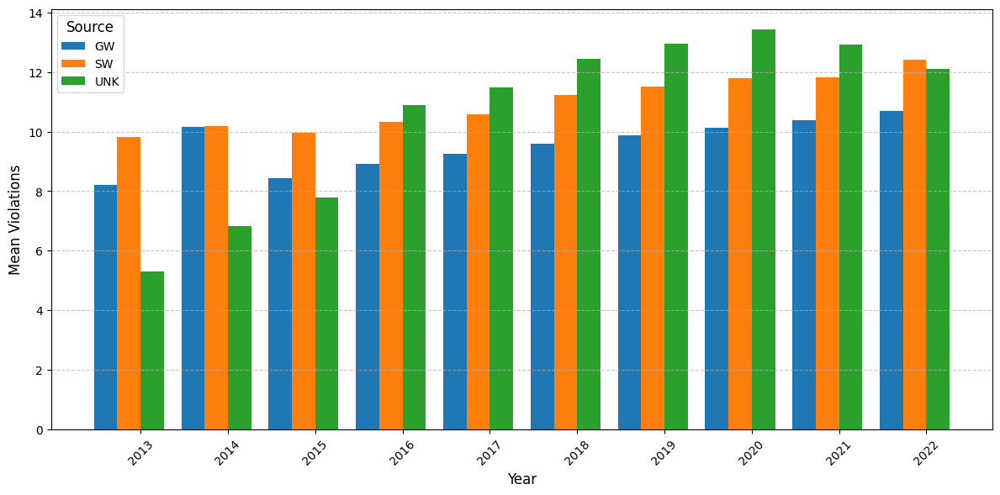

In [44]:
# Use the function
plot_grouped_bar_chart_over_time(data, 'SOURCE', 'VIOLATIONS')

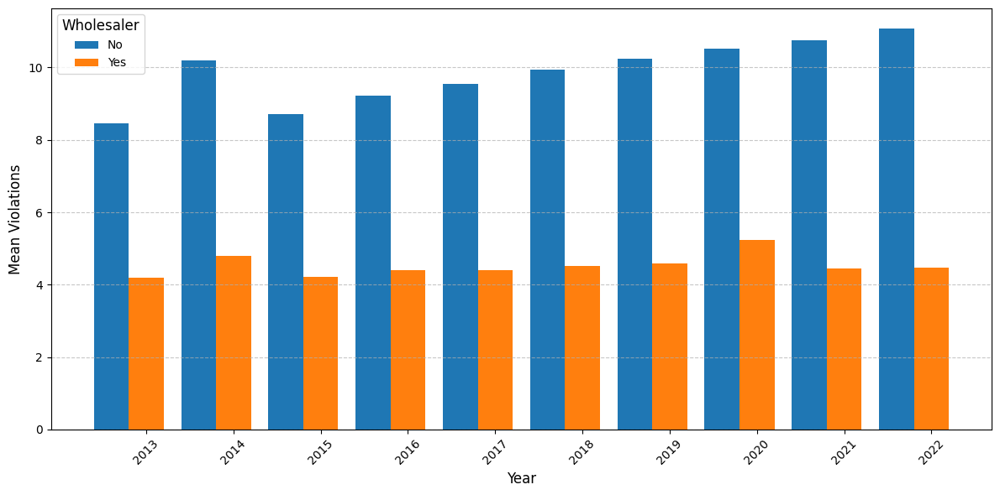

In [45]:
# Use the function
plot_grouped_bar_chart_over_time(data, 'WHOLESALER', 'VIOLATIONS')

In [47]:
# Summary statistics by COUNTY and YEAR
print("Summary Statistics by County Served and Year:")
data.groupby(['COUNTY', 'YEAR_FAC'])[numeric_columns].describe().round(2)

Summary Statistics by County Served and Year:


VIOLATIONS                                        \
                              count   mean    std  min   25%   50%    75%   
COUNTY          YEAR_FAC                                                    
Alameda         2013           21.0   3.95   7.77  0.0  0.00   1.0   3.00   
                2014           21.0   3.95   7.77  0.0  0.00   1.0   3.00   
                2015           21.0   3.95   7.77  0.0  0.00   1.0   3.00   
                2016           21.0   4.00   7.75  0.0  0.00   1.0   3.00   
                2017           21.0   6.48  13.36  0.0  0.00   1.0   3.00   
                2018           21.0   6.43  13.38  0.0  0.00   1.0   3.00   
                2019           21.0   6.43  13.38  0.0  0.00   1.0   3.00   
                2020           21.0   6.43  13.38  0.0  0.00   1.0   3.00   
                2021           21.0   6.43  13.38  0.0  0.00   1.0   3.00   
                2022           21.0   6.43  13.38  0.0  0.00   1.0   3.00   
Alpine          2013           41.0   4.15   8.03  0.0  0.00   1.0   2.00   
                2014           41.0   4.15   8.03  0.0  0.00   1.0   2.00   
                2015           41.0   4.00   8.23  0.0  0.00   0.0   2.00   
                2016           41.0   4.10   8.26  0.0  0.00   0.0   2.00   
                2017           41.0   4.22   8.37  0.0  0.00   0.0   2.00   
                2018           41.0   4.27   8.46  0.0  0.00   1.0   2.00   
                2019           41.0   4.27   8.46  0.0  0.00   1.0   2.00   
                2020           41.0   4.27   8.46  0.0  0.00   1.0   2.00   
                2021           41.0   4.27   8.46  0.0  0.00   1.0   2.00   
                2022           41.0   4.32   8.55  0.0  0.00   1.0   2.00   
Amador          2013           61.0   8.70   9.56  0.0  3.00   6.0  11.00   
                2014           61.0  10.38  10.88  0.0  4.00   7.0  12.00   
                2015           61.0   6.26   7.00  0.0  2.00   5.0   8.00   
                2016           61.0   6.62   7.05  0.0  3.00   5.0   8.00   
                2017           61.0   6.84   7.20  0.0  3.00   5.0   8.00   
                2018           61.0   6.85   7.20  0.0  3.00   5.0   8.00   
                2019           61.0   6.89   7.27  0.0  3.00   5.0   8.00   
                2020           61.0   6.92   7.29  0.0  3.00   5.0   8.00   
                2021           61.0   7.13   7.39  0.0  3.00   6.0   9.00   
                2022           61.0   7.66   7.60  0.0  3.00   6.0   9.00   
Butte           2013           83.0   7.60   9.42  0.0  2.00   4.0   8.50   
                2014           83.0  10.34  14.12  0.0  2.00   5.0  11.50   
                2015           83.0   7.00   8.48  0.0  2.00   4.0   9.00   
                2016           83.0   7.16   8.54  0.0  2.00   5.0   9.00   
                2017           83.0   7.28   8.57  0.0  2.00   5.0   9.00   
                2018           83.0   7.58   8.63  0.0  3.00   5.0   9.50   
                2019           83.0   7.64   8.63  0.0  3.00   5.0   9.50   
                2020           83.0   7.80   8.72  0.0  3.00   5.0   9.50   
                2021           83.0   7.84   8.74  0.0  3.00   5.0   9.50   
                2022           83.0   8.02   8.88  0.0  3.00   5.0  10.00   
Calaveras       2013           47.0  10.57   7.87  1.0  5.00   9.0  16.00   
                2014           47.0  13.85  10.60  1.0  5.00  10.0  22.00   
                2015           47.0   9.38   6.68  1.0  4.00   9.0  12.50   
                2016           47.0   9.96   6.98  1.0  4.50   9.0  13.00   
                2017           47.0  10.09   7.09  1.0  4.50   9.0  13.50   
                2018           47.0  10.13   7.13  1.0  4.50   9.0  13.50   
                2019           47.0  10.15   7.11  1.0  5.00   9.0  13.50   
                2020           47.0  10.19   7.09  1.0  5.00   9.0  13.50   
                2021           47.0  10.34   7.12  1.0  5.00   9.0  14.00   
                2022 

In [48]:
# Function to plot numeric variables over time when there are many levels
def plot_many_over_time_grid(data, columns, group_by='COUNTY', num_cols=2):
    num_plots = len(columns)
    num_rows = (num_plots + num_cols - 1) // num_cols

    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, 6 * num_rows))
    axes = axes.flatten()

    unique_values = data[group_by].unique()

    for i, column in enumerate(columns):
        ax = axes[i]
        for value in unique_values:
            subset = data[data[group_by] == value]
            yearly_averages = subset.groupby('YEAR_FAC')[column].mean()
            ax.plot(yearly_averages.index, yearly_averages, label=value)

        years = sorted(data['YEAR_FAC'].unique())

        ax.set_xticks(years)
        ax.set_xticklabels(years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_ylabel(f'Average {column}')
        ax.set_title(f'{column} Over Time by {group_by}')

    # Adding legend outside all subplots
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, title=group_by, bbox_to_anchor=(1.05, 0.5), loc='center left', ncol=1, fontsize='small')

    fig.subplots_adjust(right=0.9, hspace=0.3)
    plt.show()

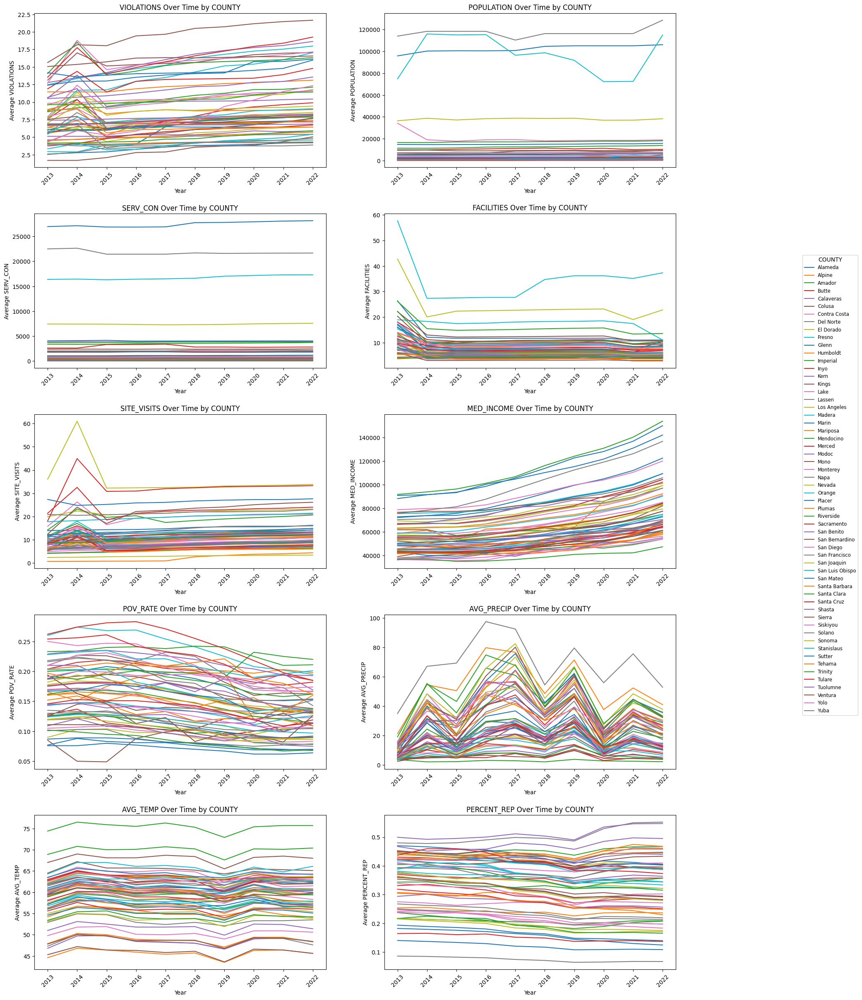

In [49]:
# Call the function with the data and columns
plot_many_over_time_grid(data, numeric_columns, group_by='COUNTY', num_cols=2)

## Between Units

In [50]:
# Between-unit summary statistics
print("Between-Unit Summary Statistics:")
between_summary = data.groupby('PWS_ID')[numeric_columns].mean().describe().round(2)
between_summary

Between-Unit Summary Statistics:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
count,6677.00,6677.00,6677.00,6677.00,6677.00,6677.00,6677.00,6677.00,6677.00,6677.00
mean,9.79,6363.81,1455.63,8.95,12.15,64089.07,0.16,21.13,60.09,0.32
std,12.54,63186.90,12523.95,22.18,13.59,15024.84,0.05,12.64,5.02,0.09
min,0.00,0.00,1.00,1.00,0.00,39120.50,0.07,2.69,45.66,0.07
25%,2.10,54.50,2.80,3.20,5.00,52898.20,0.11,12.47,57.38,0.23
50%,5.50,135.10,16.00,4.40,8.30,62476.90,0.16,17.20,60.07,0.32
75%,12.10,455.00,80.40,7.50,14.10,72525.10,0.20,33.09,63.49,0.41
max,149.30,4008897.10,695982.80,1029.70,285.70,115497.30,0.25,68.03,75.36,0.51


In [51]:
# Between-unit summary statistics by year
print("Between-Unit Summary Statistics by Year:")
between_summary_by_year = data.groupby(['PWS_ID', 'YEAR_FAC'])[numeric_columns].mean().groupby('YEAR_FAC').describe().round(2)
between_summary_by_year

Between-Unit Summary Statistics by Year:


VIOLATIONS                                           POPULATION  \
              count   mean    std  min  25%  50%   75%    max      count   
YEAR_FAC                                                                   
2013         6677.0   8.44  10.58  0.0  2.0  5.0  11.0  152.0     6677.0   
2014         6677.0  10.11  12.47  0.0  2.0  6.0  13.0  149.0     6677.0   
2015         6677.0   8.64  11.26  0.0  2.0  5.0  11.0  149.0     6677.0   
2016         6677.0   9.15  11.94  0.0  2.0  5.0  11.0  149.0     6677.0   
2017         6677.0   9.48  12.38  0.0  2.0  5.0  12.0  149.0     6677.0   
2018         6677.0   9.87  13.47  0.0  2.0  5.0  12.0  276.0     6677.0   
2019         6677.0  10.17  13.97  0.0  2.0  5.0  12.0  276.0     6677.0   
2020         6677.0  10.44  14.30  0.0  2.0  6.0  13.0  276.0     6677.0   
2021         6677.0  10.65  14.65  0.0  2.0  6.0  13.0  277.0     6677.0   
2022         6677.0  10.97  15.07  0.0  2.0  6.0  13.0  278.0     6677.0   

                                                                SERV_CON  \
             mean       std  min   25%    50%    75%        max    count   
YEAR_FAC                                                                   
2013      6329.19  70850.75  0.0  50.0  120.0  400.0  3855879.0   6677.0   
2014      6312.32  63445.82  0.0  50.0  120.0  420.0  3894439.0   6677.0   
2015      6253.63  63539.51  0.0  50.0  125.0  438.0  3935257.0   6677.0   
2016      6384.57  64368.64  0.0  50.0  125.0  445.0  3987622.0   6677.0   
2017      6407.49  64363.21  0.0  50.0  122.0  420.0  4061504.0   6677.0   
2018      6416.74  64654.89  0.0  50.0  125.0  420.0  4072307.0   6677.0   
2019      6375.50  64828.17  0.0  50.0  126.0  435.0  4085000.0   6677.0   
2020      6188.06  63453.08  0.0  50.0  126.0  446.0  4085000.0   6677.0   
2021      6255.72  63536.49  0.0  50.0  130.0  450.0  4070679.0   6677.0   
2022      6714.87  67935.55  0.0  55.0  144.0  500.0  4041284.0   6677.0   

                                                            FACILITIES         \
             mean       std  min  25%   50%   75%       max      count   mean   
YEAR_FAC                                                                        
2013      1423.41  12432.00  0.0  2.0  15.0  78.0  697501.0     6677.0  14.01   
2014      1428.91  12463.82  1.0  2.0  15.0  79.0  697501.0     6677.0   8.61   
2015      1445.29  12382.58  1.0  2.0  15.0  80.0  690547.0     6677.0   8.27   
2016      1448.24  12322.88  1.0  2.0  15.0  80.0  679740.0     6677.0   8.34   
2017      1453.73  12301.08  1.0  2.0  15.0  80.0  670323.0     6677.0   8.47   
2018      1457.13  12414.44  1.0  2.0  15.0  80.0  676153.0     6677.0   8.64   
2019      1465.12  12540.83  1.0  2.0  16.0  80.0  686539.0     6677.0   8.74   
2020      1465.51  12698.32  1.0  2.0  16.0  81.0  709135.0     6677.0   8.82   
2021      1480.01  12862.89  1.0  3.0  17.0  85.0  725246.0     6677.0   7.69   
2022      1488.98  12916.70  1.0  3.0  16.0  84.0  727143.0     6677.0   7.87   

                                             SITE_VISITS                     \
            std  min  25%  50%   75%     max       count   mean    std  min   
YEAR_FAC                                                                      
2013      41.64  0.0  3.0  6.0  11.0  1784.0      6677.0  10.19  12.78  0.0   
2014      20.30  0.0  3.0  5.0   7.0   951.0      6677.0  15.01  18.82  0.0   
2015      20.41  0.0  3.0  4.0   7.0   960.0      6677.0  10.56  12.96  0.0   
2016      20.55  0.0  3.0  4.0   7.0   970.0      6677.0  11.27  13.37  0.0   
2017      20.62  1.0  3.0  4.0   7.0   970.0      6677.0  11.57  13.35  0.0   
2018      20.88  1.0  3.0  4.0   7.0   983.0      6677.0  12.02  13.41  0.0   
2019      21.10  1.0  3.0  4.0   7.0   990.0      6677.0  12.31  13.48  0.0   
2020      21.14  1.0  3.0  5.0   8.0   991.0      6677.0  12.61  13.56  0.0   
2021      17.77  1.0  3.0  4.0   7.0   849.0      6677.0  12.79  13.61  0.0   
2022      18.70  1.0  3.0  4.

In [64]:
# Function to plot between-unit summary statistics by year
def plot_between_unit_summary(data, numeric_columns):
    # Convert year to integer
    data['YEAR_NEW'] = data['YEAR_FAC'].astype(int)

    # Compute between-unit summary statistics by year
    between_summary_by_year = (
        data.groupby(['PWS_ID', 'YEAR_NEW'])[numeric_columns]
        .mean()
        .groupby('YEAR_NEW')
        .mean()
        .round(3)
    )

    num_columns = len(numeric_columns)
    num_rows = (num_columns + 1) // 2
    fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(20, 6 * num_rows))

    if num_columns == 1:
        axes = [axes]

    axes = axes.flatten()

    all_years = sorted(data['YEAR_NEW'].unique())

    for i, column in enumerate(numeric_columns):
        ax = axes[i]
        between_summary_by_year[column].plot(ax=ax, marker='o', linestyle='-')
        ax.set_title(f'Between-Unit Summary: {column} Over Time')
        ax.set_xlabel('Year')
        ax.set_ylabel(f'Average {column}')
        ax.set_xticks(all_years)
        ax.set_xticklabels(all_years)
        ax.grid(False)

    fig.tight_layout()
    plt.show()

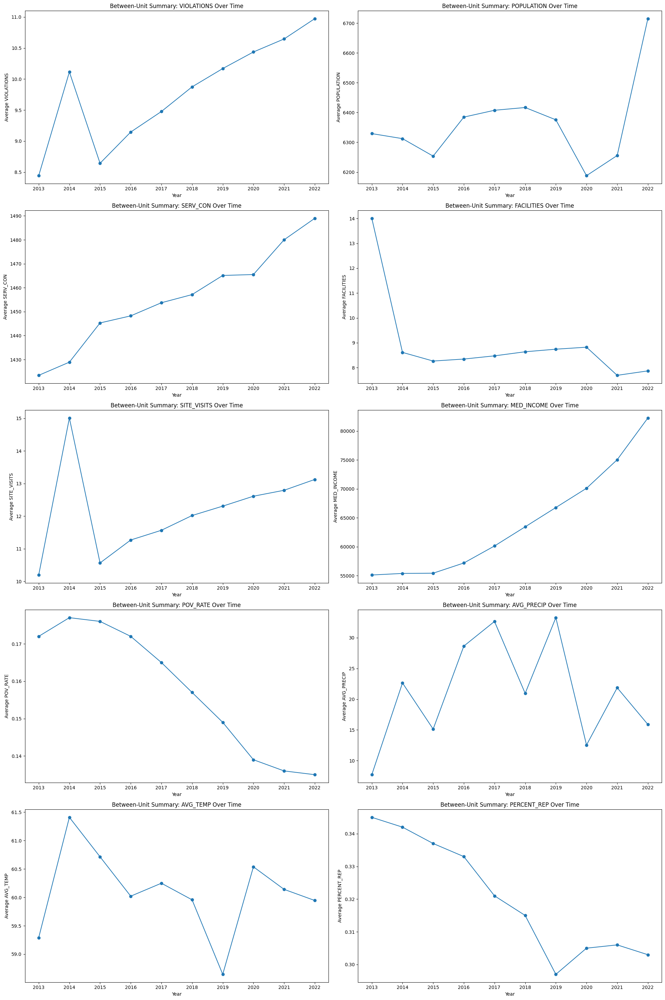

In [65]:
# Plot the between-unit means over the years
plot_between_unit_summary(data, numeric_columns)

## Within Units

In [66]:
# Within-unit summary statistics
print("Within-Unit Summary Statistics:")
within_summary = data.groupby('PWS_ID')[numeric_columns].transform(lambda x: x - x.mean()).describe().round(2)
within_summary

Within-Unit Summary Statistics:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
count,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00,66770.00
mean,0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00
std,3.84,15823.33,533.15,7.17,3.62,9449.29,0.02,9.96,0.81,0.02
min,-137.30,-795079.20,-25659.80,-180.70,-133.60,-26221.50,-0.06,-33.03,-2.46,-0.05
25%,-0.40,-5.00,-0.60,-0.70,-1.00,-7085.30,-0.01,-4.86,-0.44,-0.02
50%,0.00,0.00,0.00,-0.20,-0.10,-2036.50,0.00,-0.42,0.04,-0.00
75%,0.20,0.80,0.40,0.30,0.70,5656.10,0.02,4.54,0.49,0.02
max,138.70,2826000.00,50312.70,754.30,105.80,38294.70,0.07,37.29,1.79,0.05


In [67]:
# Within-unit summary statistics by year
print("Within-Unit Summary Statistics by Year:")
within_summary_by_year = data.groupby(['PWS_ID', 'YEAR_FAC'])[numeric_columns].transform(lambda x: x - x.mean()).groupby(data['YEAR_FAC']).describe().round(2)
within_summary_by_year

Within-Unit Summary Statistics by Year:


VIOLATIONS                                    POPULATION            \
              count mean  std  min  25%  50%  75%  max      count mean  std   
YEAR_FAC                                                                      
2013         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   
2014         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   
2015         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   
2016         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   
2017         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   
2018         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   
2019         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   
2020         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   
2021         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   
2022         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0   

                                  SERV_CON                                     \
          min  25%  50%  75%  max    count mean  std  min  25%  50%  75%  max   
YEAR_FAC                                                                        
2013      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2014      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2015      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2016      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2017      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2018      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2019      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2020      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2021      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2022      0.0  0.0  0.0  0.0  0.0   6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

         FACILITIES                                    SITE_VISITS            \
              count mean  std  min  25%  50%  75%  max       count mean  std   
YEAR_FAC                                                                       
2013         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   
2014         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   
2015         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   
2016         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   
2017         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   
2018         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   
2019         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   
2020         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   
2021         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   
2022         6677.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0      6677.0  0.0  0.0   

                                  MED_INCOME                                \
          min  25%  50%  75%  max      count mean  std  min  25%  50%  75%   
YEAR_FAC                                                                     
2013      0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0  0.0  0.0  0.0  0.0   
2014      0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0  0.0  0.0  0.0  0.0   
2015      0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0  0.0  0.0  0.0  0.0   
2016      0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0  0.0  0.0  0.0  0.0   
2017      0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0  0.0  0.0  0.0  0.0   
2018      0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0  0.0  0.0  0.0  0.0   
2019      0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0  0.0  0.0  0.0  0.0   
2020      0.0  0.0  0.0  0.0  0.0     6677.0  0.0  0.0  0.0  0.0  0.0  0.0   
2021      0.0  0.0  0.0  0.0

# Distributional Analysis

## Count Variable Plots

In [68]:
from scipy.stats import norm, poisson

# Function to inspect normal vs. Poisson distribution for variables
def inspect_distribution(data, variable):
    # Extract variable data
    var_data = data[variable]

    # Histogram and KDE Plot
    plt.figure(figsize=(12, 6))
    sns.histplot(var_data, kde=True, stat='density', color='blue', bins=30, label='Actual Data')

    # Fit and plot a normal distribution
    mu_norm, std_norm = var_data.mean(), var_data.std()
    x_norm = np.linspace(var_data.min(), var_data.max(), 100)
    norm_dist = norm.pdf(x_norm, mu_norm, std_norm)
    plt.plot(x_norm, norm_dist, color='green', label='Normal Distribution')

    # Fit and plot a Poisson distribution
    mu_poisson = var_data.mean()
    x_poisson = np.arange(0, var_data.max() + 1)
    poisson_dist = poisson.pmf(x_poisson, mu_poisson)
    plt.plot(x_poisson, poisson_dist, 'o-', color='red', label='Poisson Distribution')

    plt.xlabel(variable)
    plt.ylabel('Density')
    plt.legend()
    plt.title(f'Distribution Comparison: {variable}')
    plt.grid(False)
    plt.tight_layout()
    plt.show()

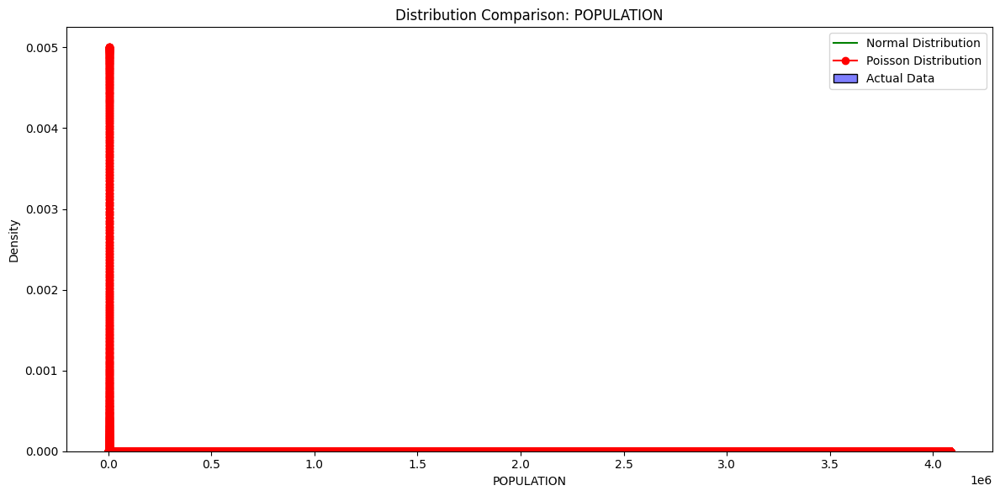

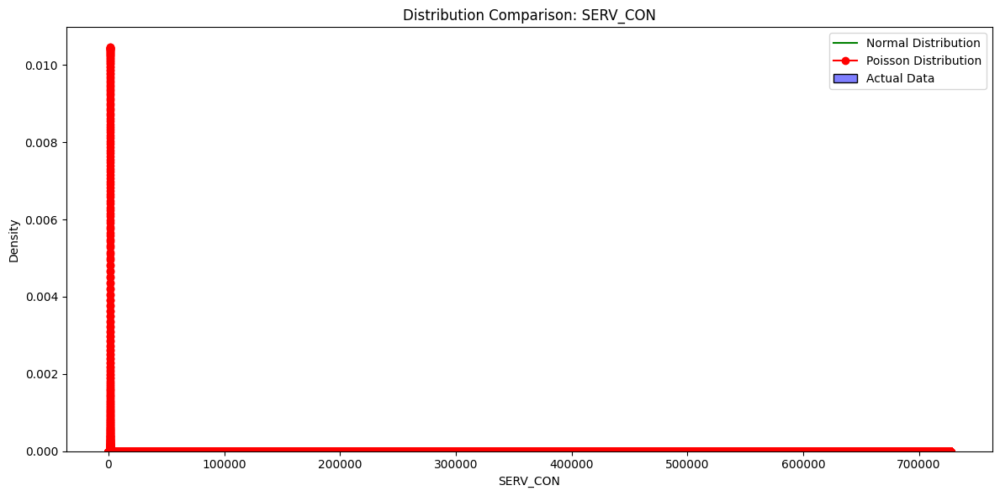

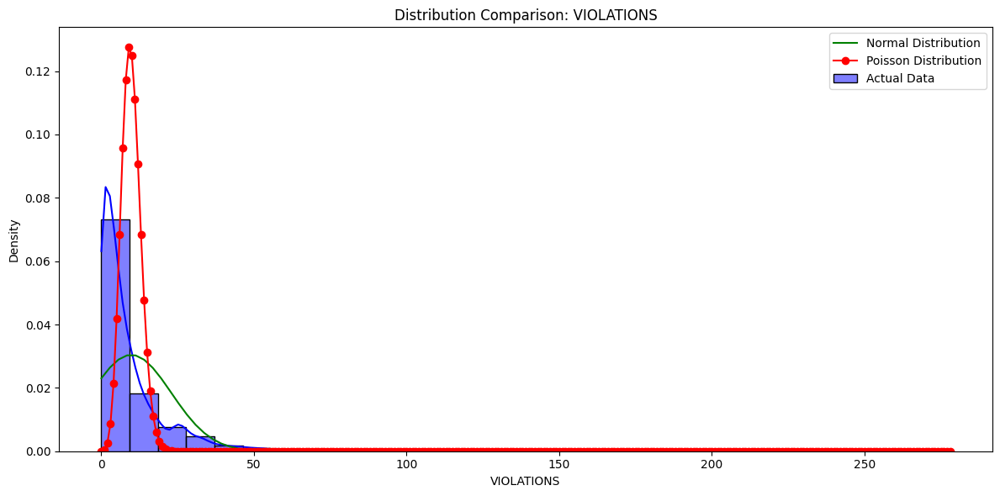

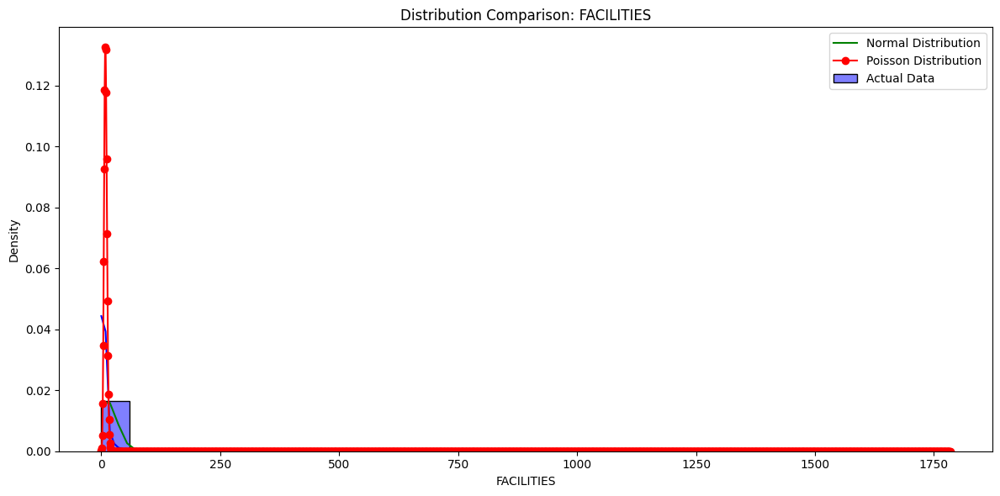

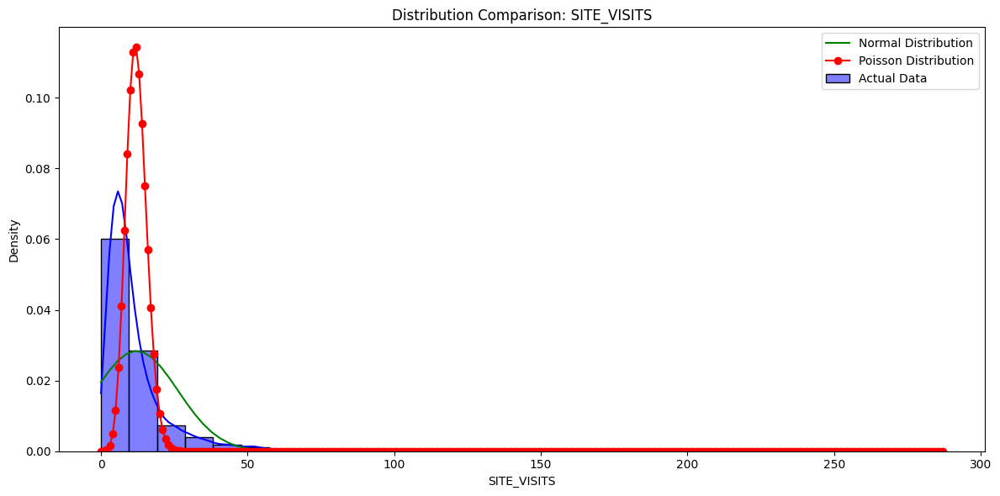

In [69]:
# Use the function
selected_vars = ['POPULATION', 'SERV_CON', 'VIOLATIONS', 'FACILITIES', 'SITE_VISITS']

for var in selected_vars:
    inspect_distribution(data, var)

## Statistical Tests

In [70]:
from scipy.stats import shapiro, anderson, kstest

# Function to perform statistical tests for normality and Poisson distribution
def test_violations_distribution(data):
    # Extract violations data
    violations = data['VIOLATIONS']

    # Normality Test using Shapiro-Wilk
    shapiro_stat, shapiro_p = shapiro(violations)
    print(f'Shapiro-Wilk Test: Statistic = {shapiro_stat:.4f}, p-value = {shapiro_p:.6e}')

    # Anderson-Darling Test for Normal distribution
    anderson_result = anderson(violations, dist='norm')
    print(f'\nAnderson-Darling Test: Statistic = {anderson_result.statistic:.4f}')
    for i, critical_value in enumerate(anderson_result.critical_values):
        sig_level = anderson_result.significance_level[i]
        print(f'Critical Value (Significance Level {sig_level}%): {critical_value:.4f}')
    if anderson_result.statistic > anderson_result.critical_values[2]:
        print("The data does not follow a normal distribution (Reject H0)")
    else:
        print("The data follows a normal distribution (Fail to Reject H0)")

    # Kolmogorov-Smirnov Test for Poisson distribution
    mu_poisson = violations.mean()
    poisson_dist = poisson(mu_poisson)
    ks_stat, ks_p = kstest(violations, poisson_dist.cdf)
    print(f'\nKolmogorov-Smirnov Test for Poisson: Statistic = {ks_stat:.4f}, p-value = {ks_p:.6e}')

In [71]:
# Perform statistical tests
test_violations_distribution(data)

Shapiro-Wilk Test: Statistic = 0.6731, p-value = 0.000000e+00

Anderson-Darling Test: Statistic = 5648.4444
Critical Value (Significance Level 15.0%): 0.5760
Critical Value (Significance Level 10.0%): 0.6560
Critical Value (Significance Level 5.0%): 0.7870
Critical Value (Significance Level 2.5%): 0.9180
Critical Value (Significance Level 1.0%): 1.0920
The data does not follow a normal distribution (Reject H0)

Kolmogorov-Smirnov Test for Poisson: Statistic = 0.4327, p-value = 0.000000e+00


/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


## Response Variable Plots

In [72]:
# Function to plot the overall distribution of VIOLATIONS across all years
def plot_overall_response_distribution(data, response_var):
    data.groupby('PWS_ID')[response_var].mean().hist(bins=20)
    plt.xlabel(f'Mean {response_var.capitalize()}')
    plt.ylabel('Frequency')
    plt.title('Distribution of PWS-level Means')
    plt.show()

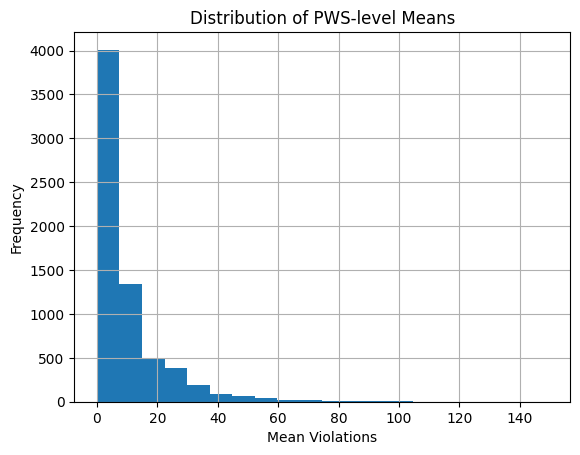

In [73]:
# Use the function
plot_overall_response_distribution(data, 'VIOLATIONS')

In [74]:
# Function to plot the distribution of violations for each year
def plot_yearly_response_distribution(data, response_var):
    for year in data['YEAR_FAC'].unique():
        data[data['YEAR_FAC'] == year][response_var].hist(bins=30)
        plt.xlabel(f'{response_var}')
        plt.ylabel('Frequency')
        plt.title(f'Distribution of {response_var} in {year}')
        plt.show()

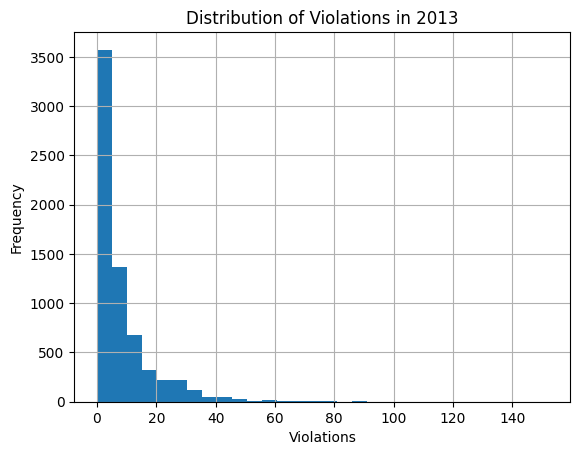

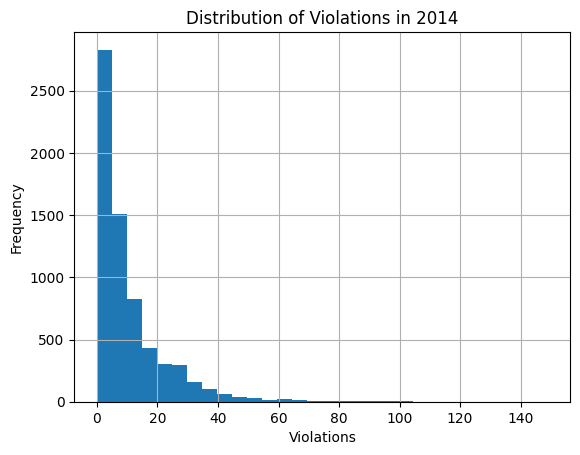

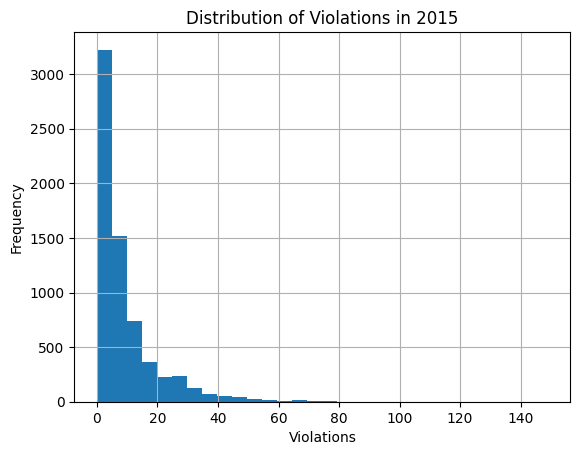

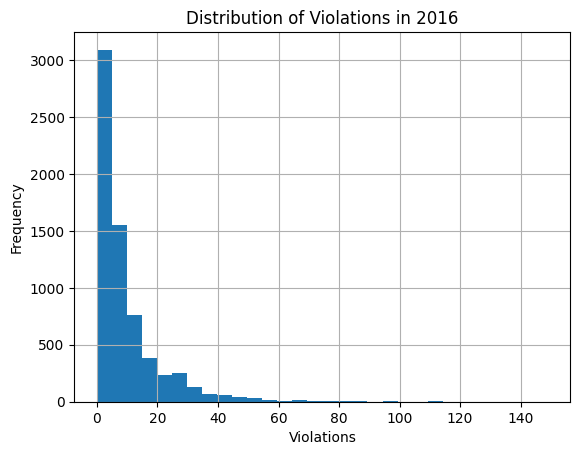

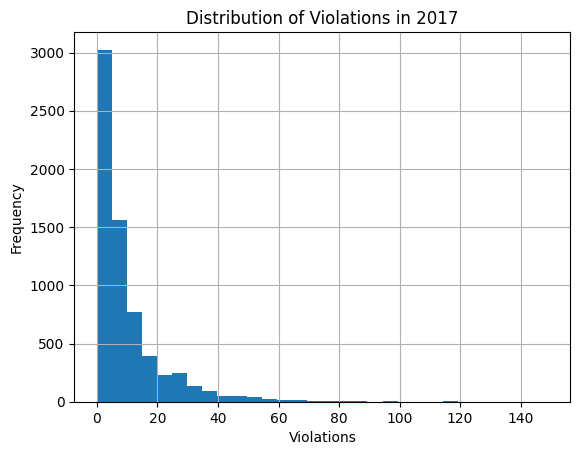

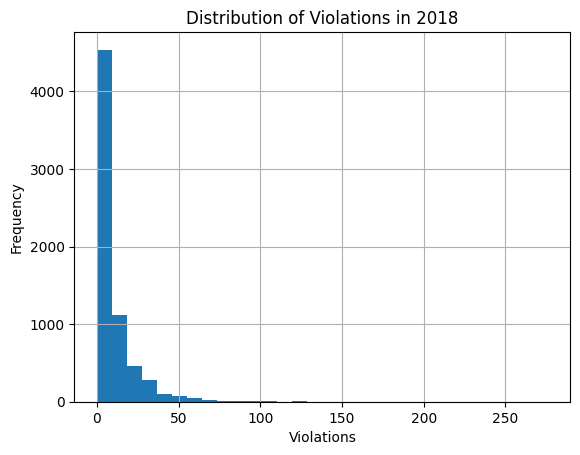

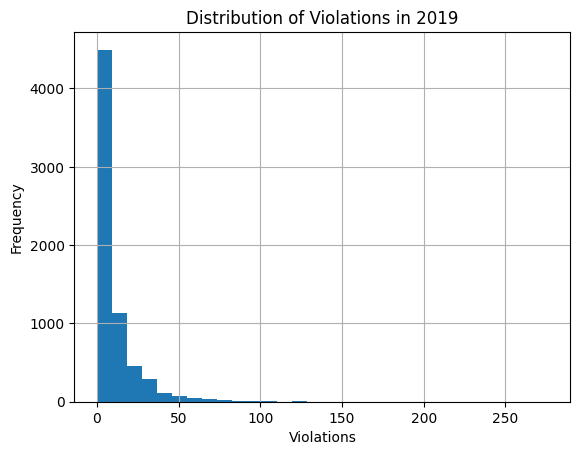

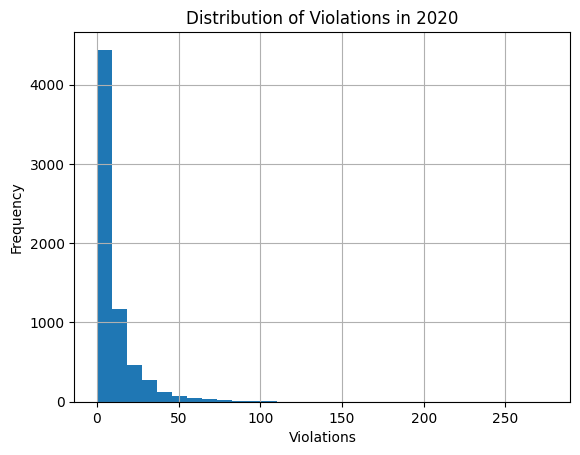

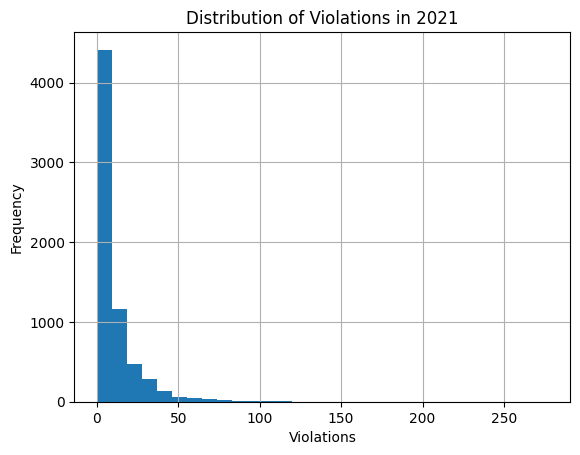

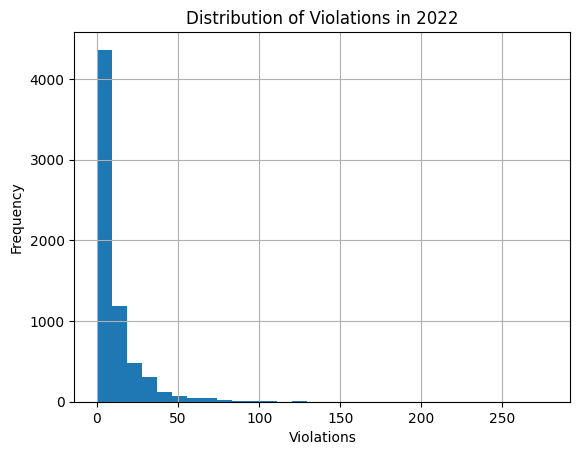

In [75]:
# Use the function
plot_yearly_response_distribution(data, 'VIOLATIONS')

In [81]:
# Function to plot the relationship between VIOLATIONS and time
def plot_response_time_relationship(data, response_var):
    # Extract all unique years
    all_years = sorted(data['YEAR_FAC'].unique())

    # Create a scatter plot
    data.plot.scatter(x='YEAR_FAC', y=response_var)
    plt.xlabel('Year')
    plt.ylabel(f'{response_var}')
    plt.title(f'Relationship Between {response_var} and Time')

    plt.xticks(all_years, rotation=45)
    plt.grid(True, linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()

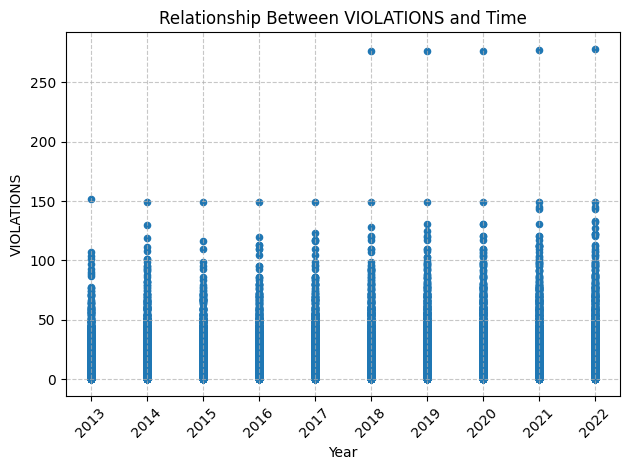

In [82]:
# Use the function
plot_response_time_relationship(data, 'VIOLATIONS')

In [83]:
# Function to plot the mean relationship between VIOLATIONS and time
def plot_response_time_relationship_bars(data, response_var):
    # Extract the mean response variable values by year
    mean_data = data.groupby('YEAR_FAC')[response_var].mean().reset_index()

    # Extract all unique years
    all_years = sorted(data['YEAR_FAC'].unique())

    # Create a bar plot
    plt.figure(figsize=(12, 6))
    plt.bar(mean_data['YEAR_FAC'], mean_data[response_var], color='skyblue')

    plt.xlabel('Year')
    plt.ylabel(f'Mean {response_var}')
    plt.title(f'Relationship Between Mean {response_var} and Time')

    plt.xticks(all_years, rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()

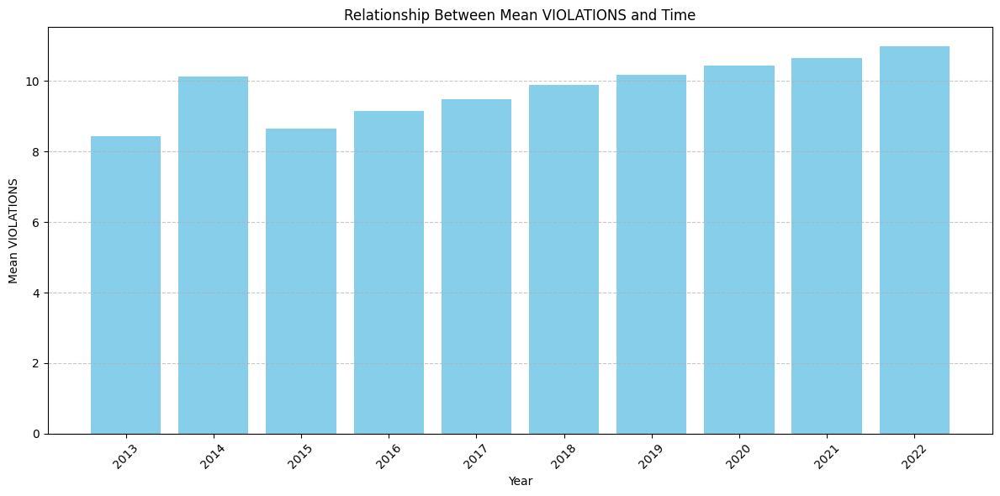

In [84]:
# Use the function
plot_response_time_relationship_bars(data, 'VIOLATIONS')

## County Variable Plots

In [85]:
# List of county-level variables
county_vars = [
    'MED_INCOME', 'POV_RATE', 'AVG_PRECIP', 'AVG_TEMP',
    'PERCENT_REP', 'PERCENT_DEM', 'PERCENT_OTH'
]

In [86]:
# Function to plot county variables across all counties over time
def plot_all_counties_over_time(data, county_vars):
    for var in county_vars:
        plt.figure(figsize=(12, 6))
        sns.lineplot(data=data, x='YEAR_FAC', y=var, hue='COUNTY', estimator='mean', errorbar=None)
        plt.xlabel('Year')
        plt.ylabel(var)
        plt.title(f'Change of {var} Over Time Across All Counties')
        plt.legend(title='County', bbox_to_anchor=(1.05, 1), loc='upper left')

        all_years = sorted(data['YEAR_FAC'].unique())
        plt.xticks(all_years, rotation=45)

        plt.grid(True, linestyle='--', alpha=0.7)
        plt.show()

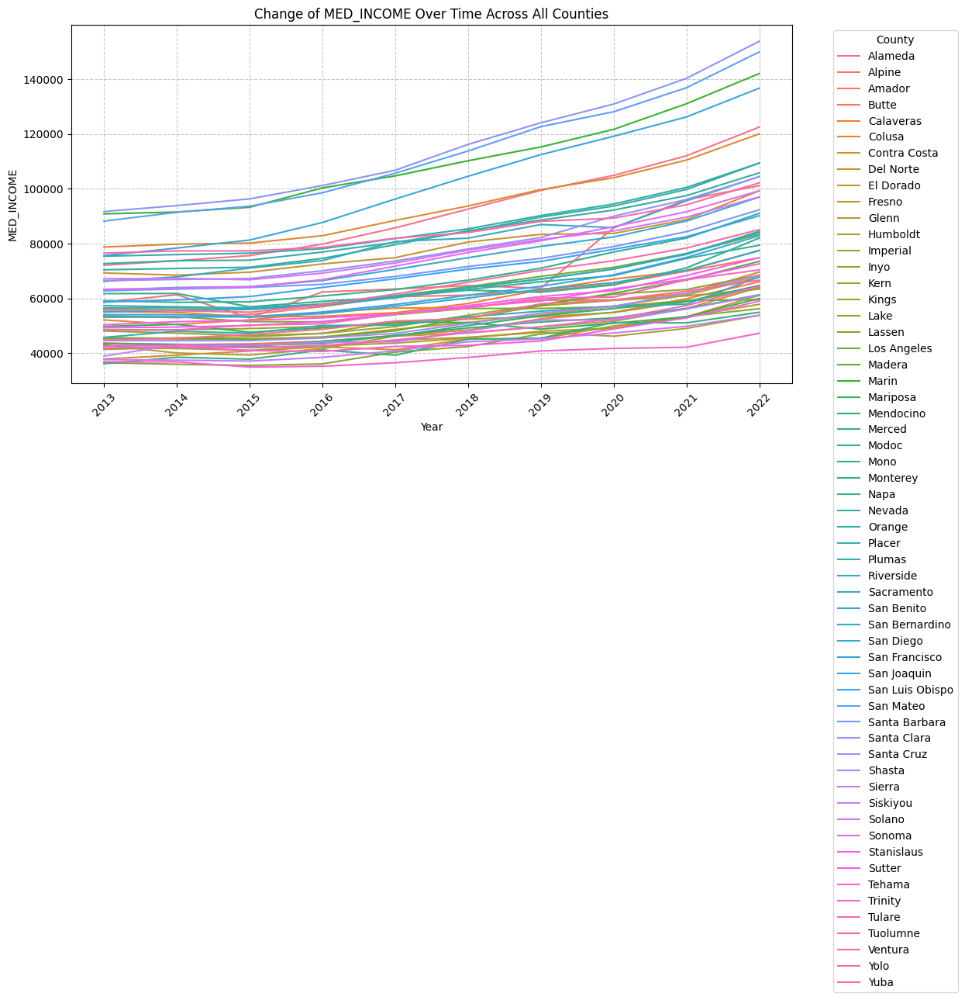

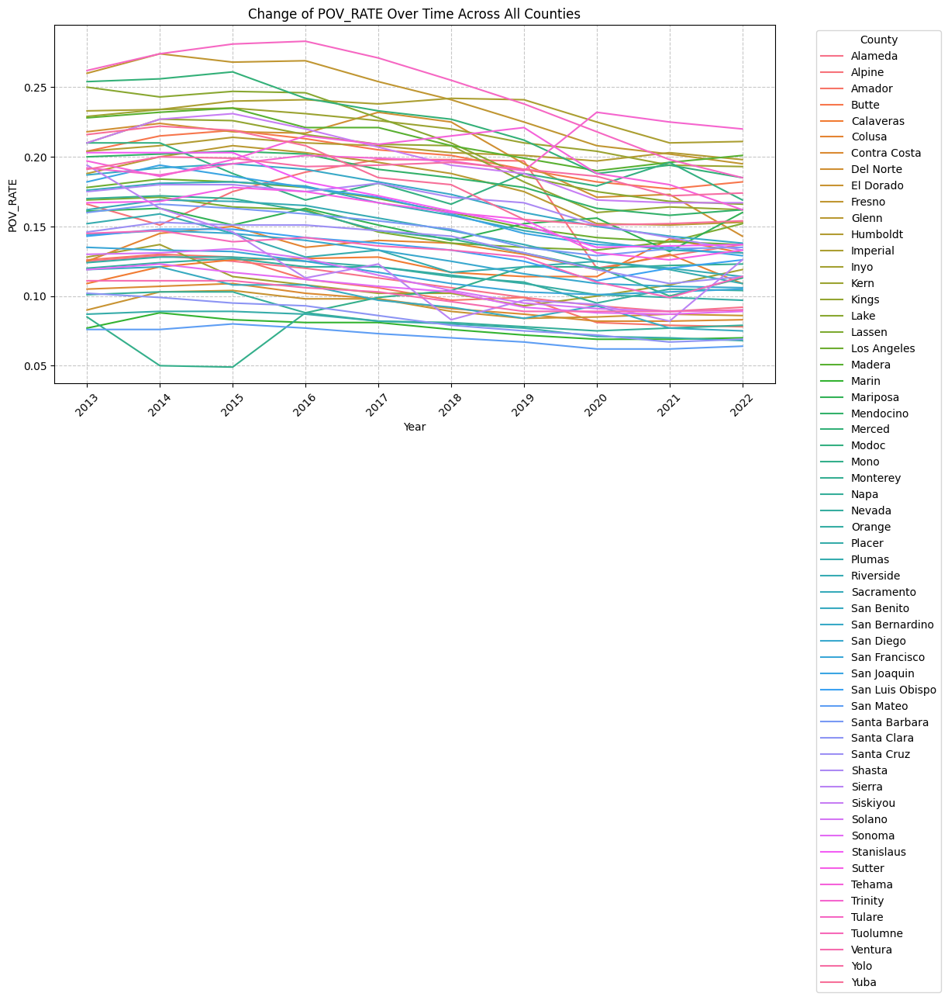

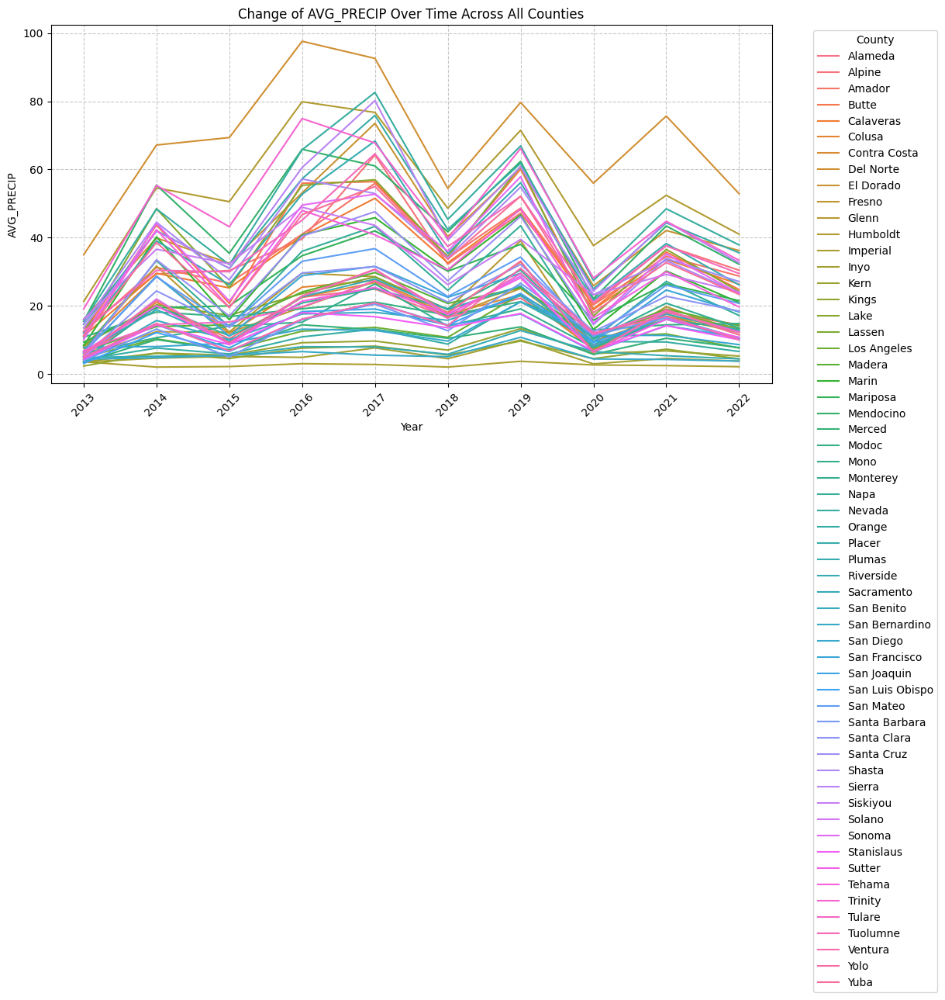

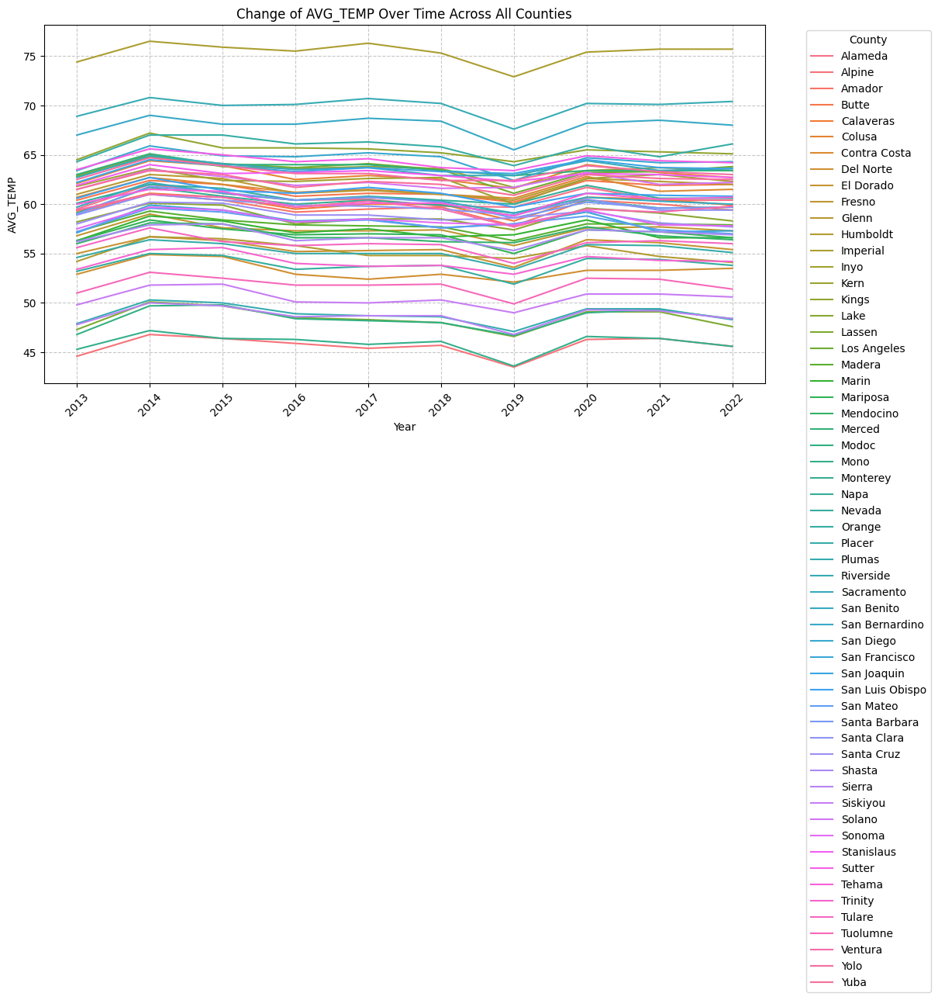

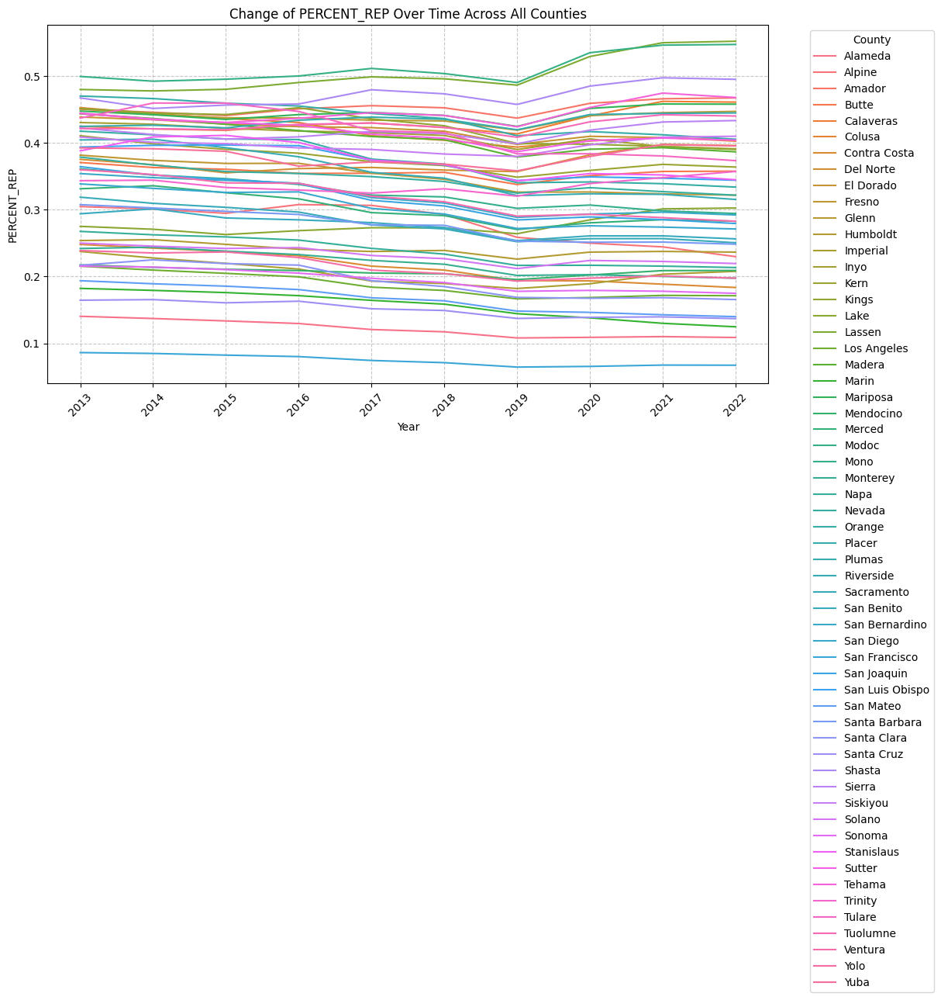

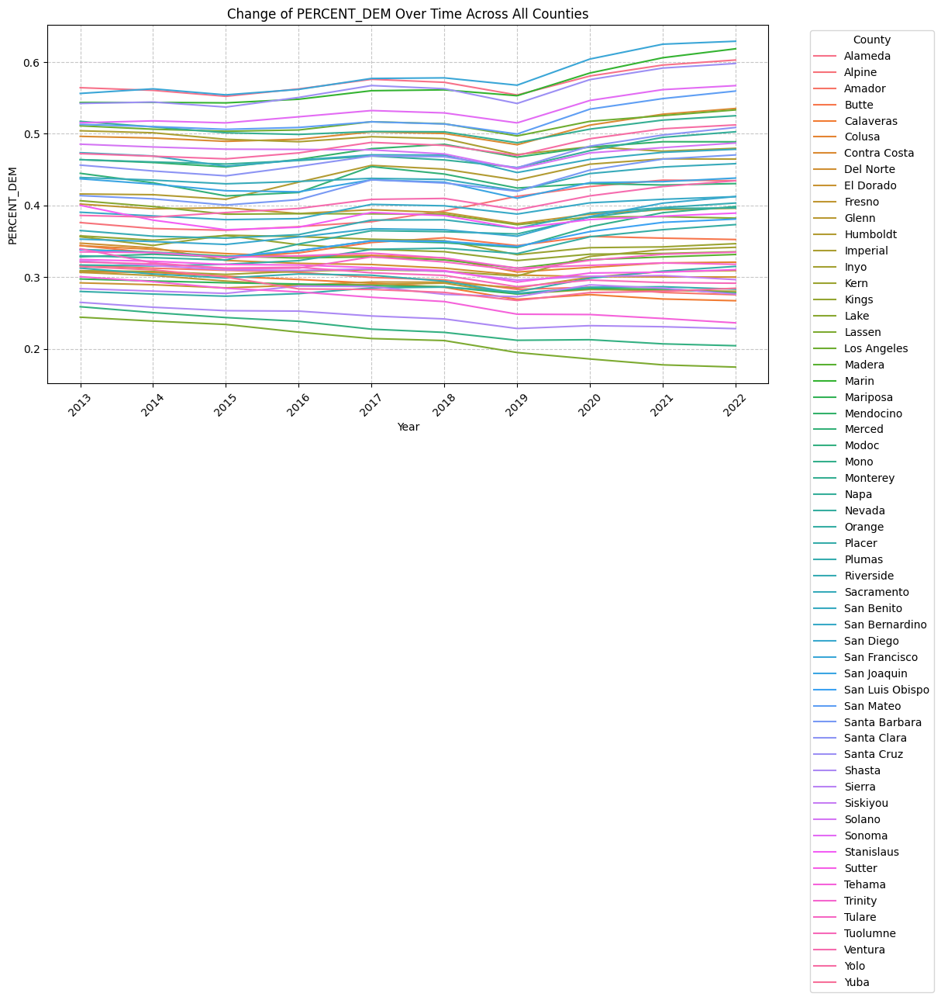

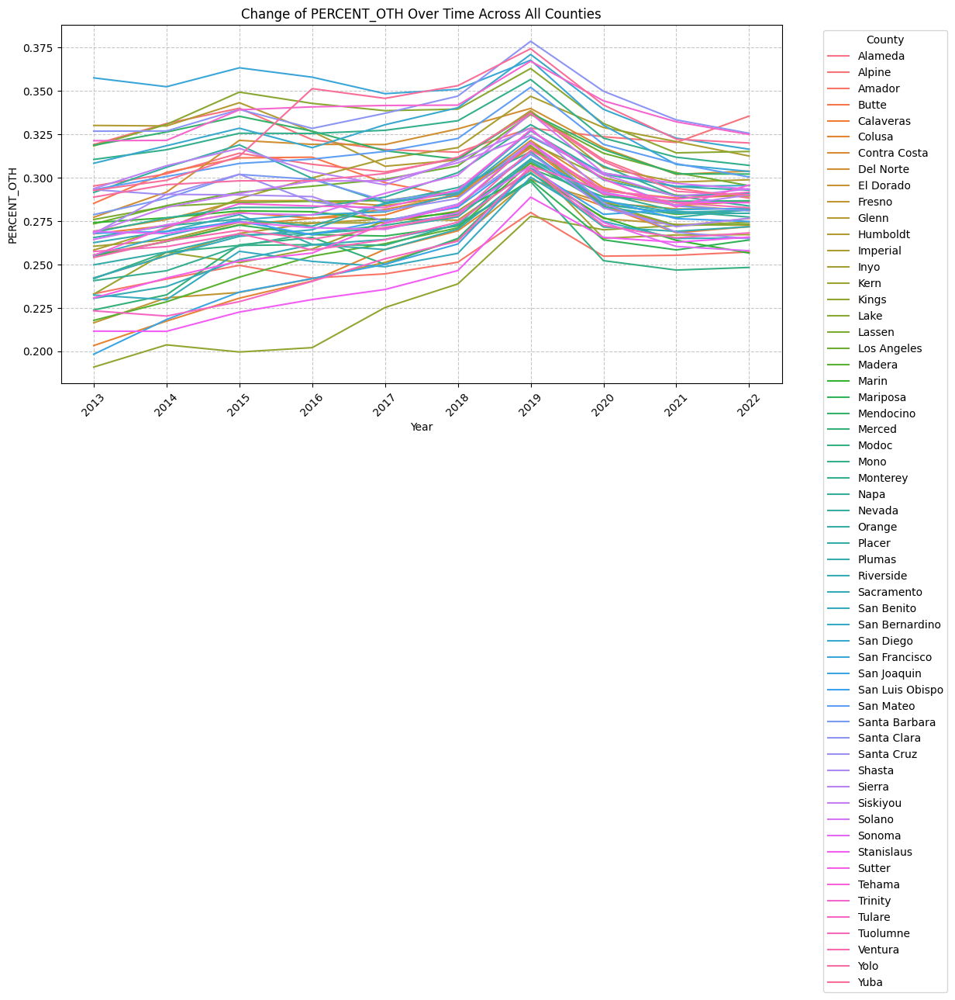

In [87]:
# Use the function
plot_all_counties_over_time(data, county_vars)

In [88]:
# Function to plot a specified county's variables over time
def plot_single_county_over_time(data, county_vars, county_name):
    for var in county_vars:
        plt.figure(figsize=(12, 6))
        county_data = data[data['COUNTY'] == county_name]
        sns.lineplot(data=county_data, x='YEAR_FAC', y=var)
        plt.xlabel('Year')
        plt.ylabel(f'{var.replace(" County", "")}')
        plt.title(f'{var.replace(" County", "")} Over Time in {county_name}')

        all_years = sorted(data['YEAR_FAC'].unique())
        plt.xticks(all_years, rotation=45)

        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()

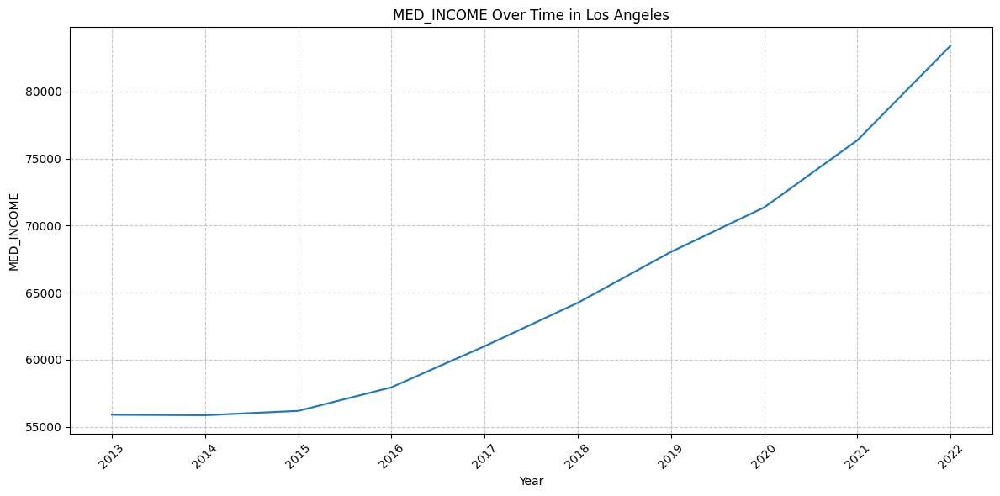

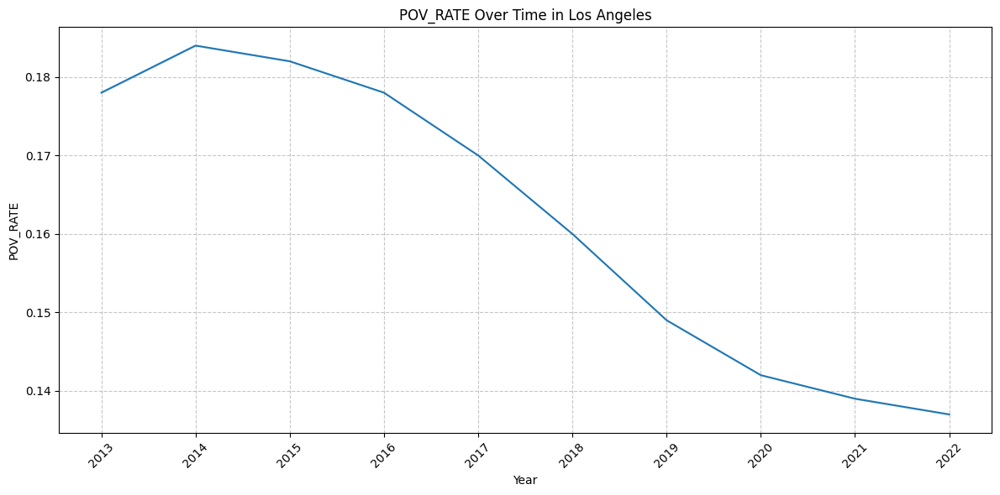

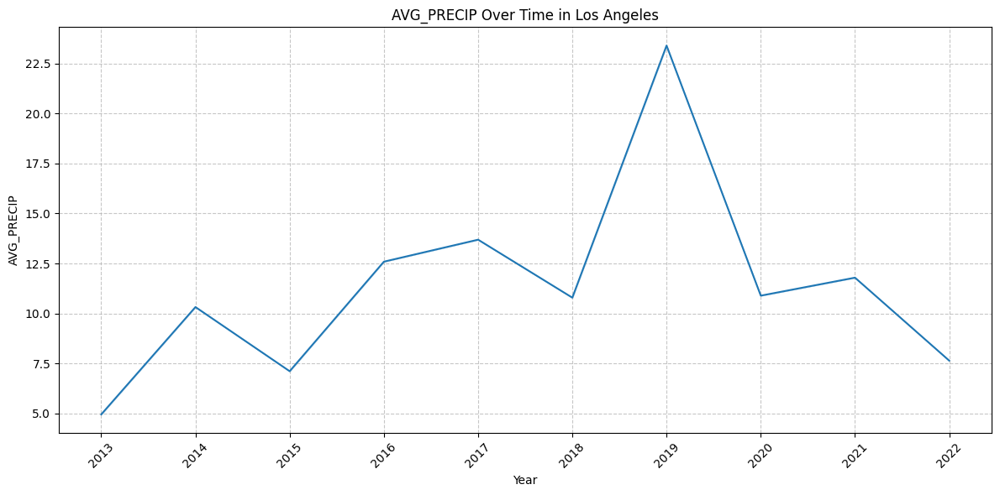

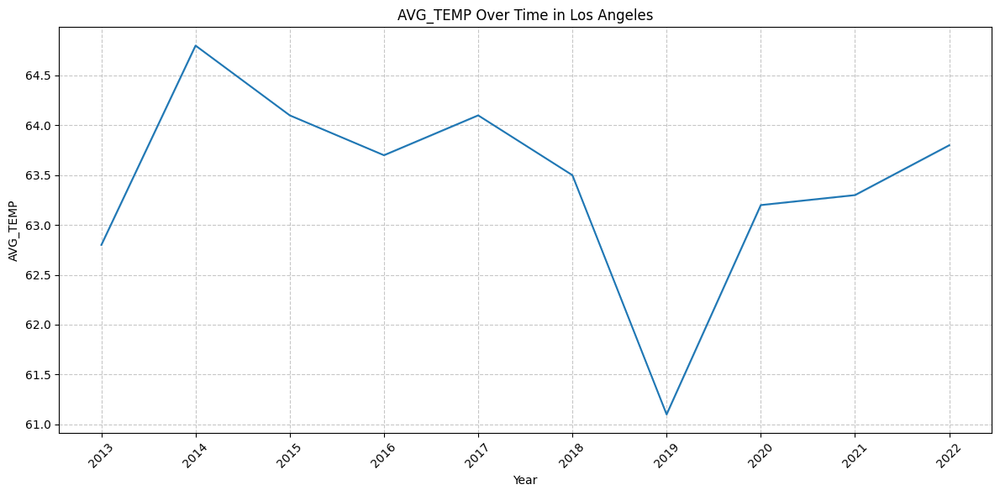

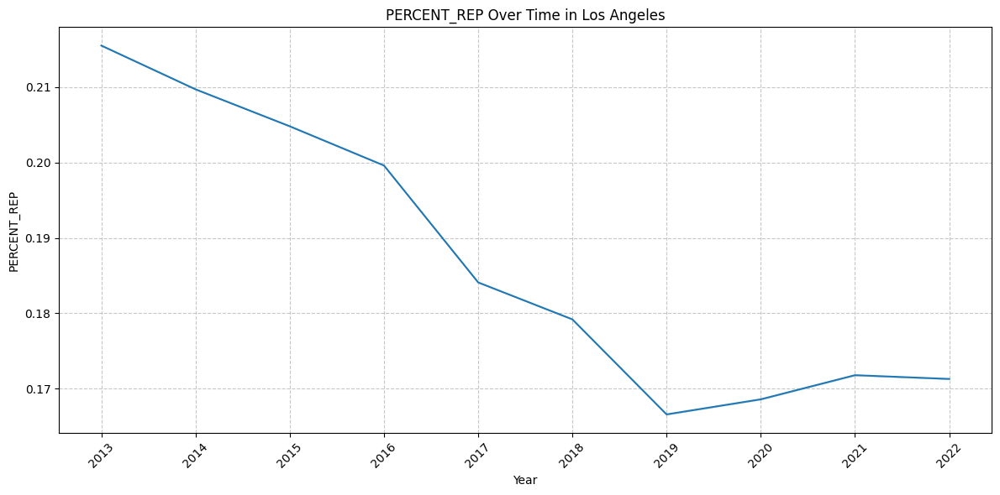

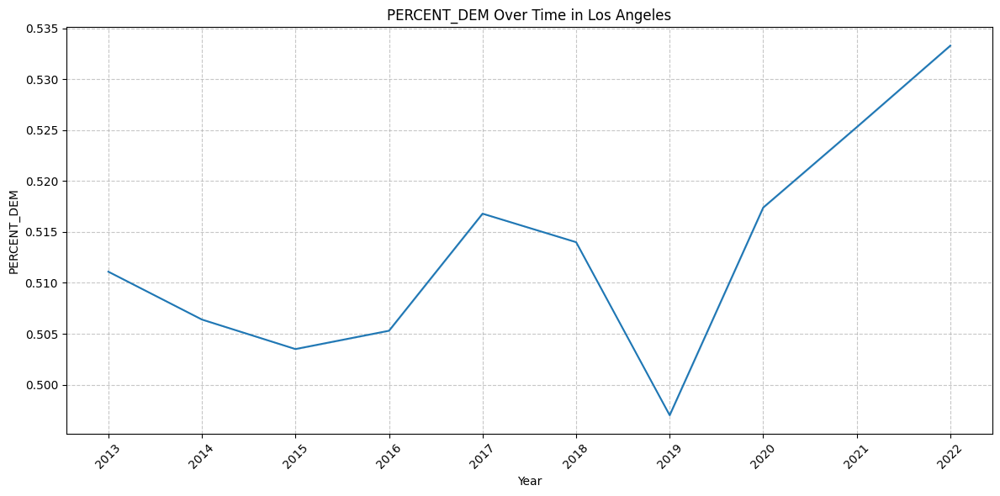

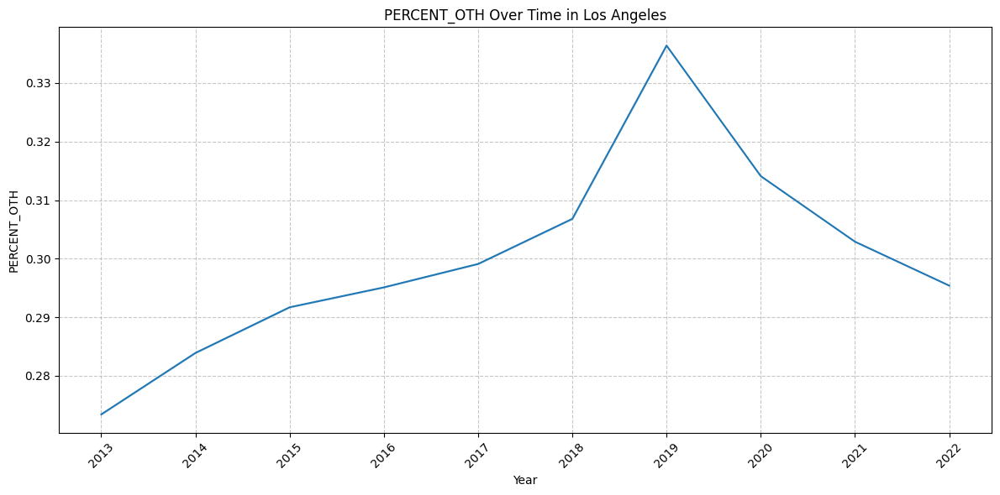

In [89]:
# Use the function
plot_single_county_over_time(data, county_vars, 'Los Angeles')

In [90]:
import math
from matplotlib.ticker import FixedLocator

# Function to plot all counties' variables for all years in a grid plot
def plot_all_counties_all_years(data, county_vars):
    for var in county_vars:
        unique_years = sorted(data['YEAR_FAC'].unique())
        num_years = len(unique_years)
        num_cols = 1
        num_rows = math.ceil(num_years / num_cols)

        fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(12, 6 * num_rows))

        for i, year in enumerate(unique_years):
            ax = axes[i] if num_rows > 1 else axes
            year_data = data[data['YEAR_FAC'] == year]

            county_labels = sorted(year_data['COUNTY'].unique())
            sns.barplot(
                data=year_data,
                x='COUNTY',
                y=var,
                ax=ax,
                hue='COUNTY',
                dodge=False,
                palette='Set3',
                legend=False
            )
            ax.set_xlabel('County')
            ax.set_ylabel(var.replace(" County", ""))
            ax.set_title(f'{var.replace(" County", "")} Across All Counties in {year}')

            ax.set_xticks(range(len(county_labels)))
            ax.set_xticklabels(county_labels, rotation=90)
            ax.xaxis.set_major_locator(FixedLocator(range(len(county_labels))))

            ax.grid(True, linestyle='--', alpha=0.7)

        fig.tight_layout(pad=3.0)
        plt.show()

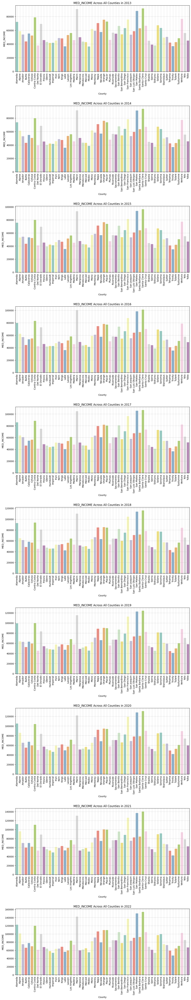

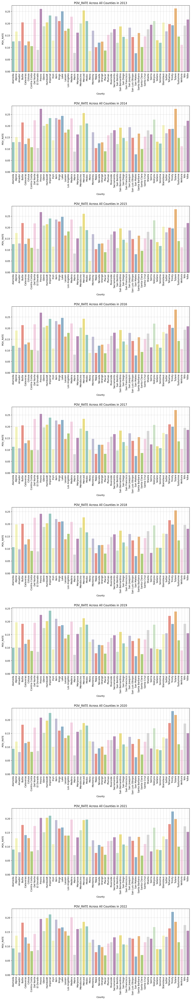

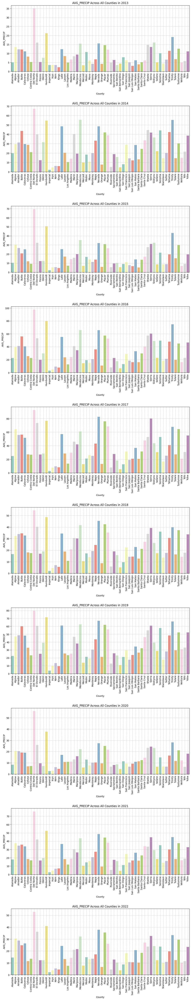

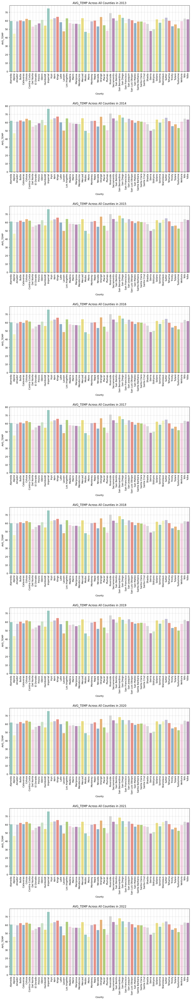

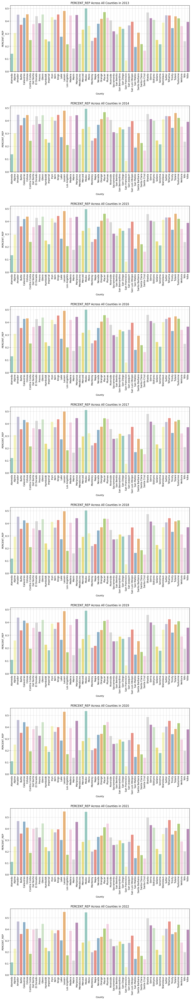

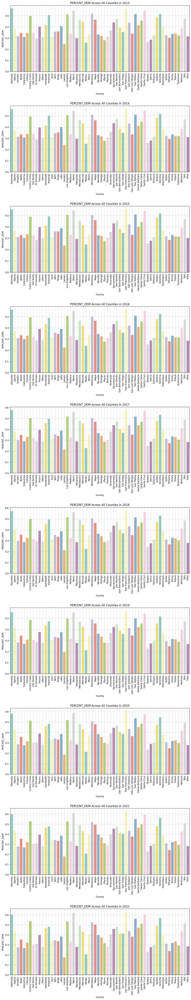

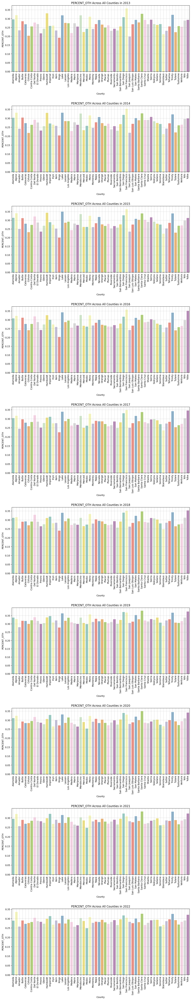

In [91]:
# Use the function
plot_all_counties_all_years(data, county_vars)

# Correlational Analysis

## Pooled Correlation

In [92]:
# Compute the overall pooled correlation matrix
pooled_corr = data[numeric_columns].corr()
print("Pooled Correlation Matrix:")
pooled_corr

Pooled Correlation Matrix:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.035896,-0.041081,-0.008388,0.055424,-0.019869,0.092634,-0.049382,-0.018217,0.023571
POPULATION,-0.035896,1.000000,0.932190,0.433549,0.361915,0.053063,-0.026691,-0.041934,0.056271,-0.056912
SERV_CON,-0.041081,0.932190,1.000000,0.507031,0.381859,0.061807,-0.032309,-0.045236,0.062778,-0.064555
FACILITIES,-0.008388,0.433549,0.507031,1.000000,0.229967,0.004872,0.032033,-0.092254,0.083343,-0.030451
SITE_VISITS,0.055424,0.361915,0.381859,0.229967,1.000000,0.076138,-0.034698,-0.131361,0.237310,-0.125971
MED_INCOME,-0.019869,0.053063,0.061807,0.004872,0.076138,1.000000,-0.766931,-0.017247,0.037257,-0.519726
POV_RATE,0.092634,-0.026691,-0.032309,0.032033,-0.034698,-0.766931,1.000000,-0.158481,0.103190,0.323682
AVG_PRECIP,-0.049382,-0.041934,-0.045236,-0.092254,-0.131361,-0.017247,-0.158481,1.000000,-0.529425,0.016133
AVG_TEMP,-0.018217,0.056271,0.062778,0.083343,0.237310,0.037257,0.103190,-0.529425,1.000000,-0.213531
PERCENT_REP,0.023571,-0.056912,-0.064555,-0.030451,-0.125971,-0.519726,0.323682,0.016133,-0.213531,1.000000


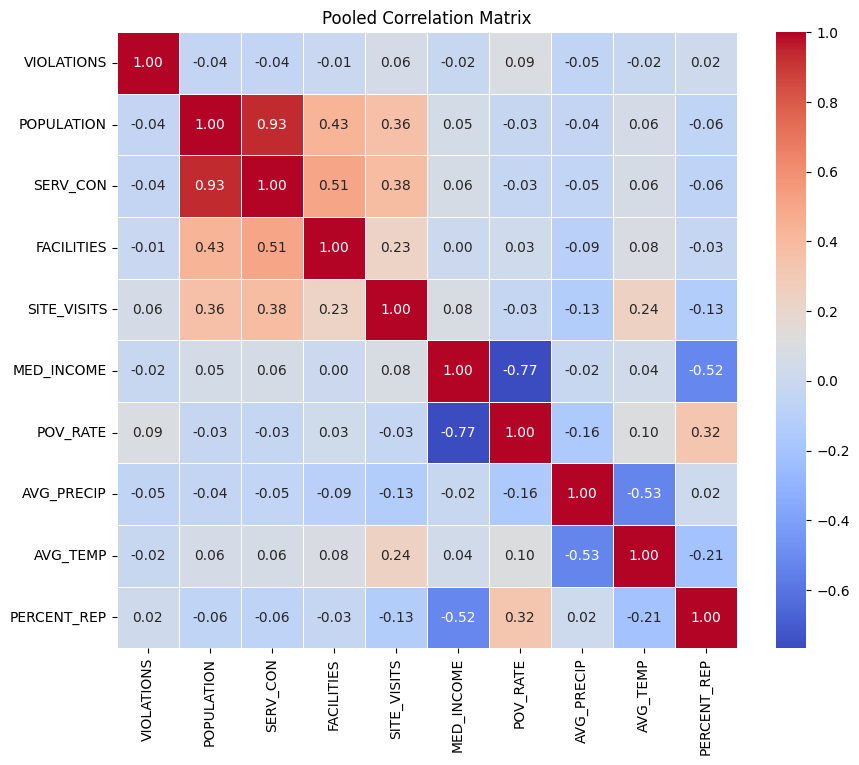

In [93]:
# Create the pooled correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(pooled_corr, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Pooled Correlation Matrix')
plt.show()

## Year-Specific Correlation

In [94]:
# Compute year-specific correlation matrices
time_corr = {}

for year in data['YEAR_FAC'].unique():
    time_corr[year] = data[data['YEAR_FAC'] == year][numeric_columns].corr()

print("Year-Specific Correlation Matrices:")
for year, corr in time_corr.items():
    print(f"Year {year}:")
    display(corr)
    print("\n")

Year-Specific Correlation Matrices:
Year 2013:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.040494,-0.047090,-0.031026,0.064753,-0.046420,0.098366,-0.025621,-0.020102,0.052865
POPULATION,-0.040494,1.000000,0.818604,0.409562,0.351605,0.054745,-0.025645,-0.035328,0.050988,-0.048666
SERV_CON,-0.047090,0.818604,1.000000,0.543308,0.409889,0.069501,-0.032301,-0.046903,0.061514,-0.060094
FACILITIES,-0.031026,0.409562,0.543308,1.000000,0.273941,0.035195,0.020779,-0.078712,0.090534,-0.045272
SITE_VISITS,0.064753,0.351605,0.409889,0.273941,1.000000,0.049023,-0.006089,-0.132141,0.183473,-0.062316
MED_INCOME,-0.046420,0.054745,0.069501,0.035195,0.049023,1.000000,-0.794131,-0.202575,0.058159,-0.462067
POV_RATE,0.098366,-0.025645,-0.032301,0.020779,-0.006089,-0.794131,1.000000,-0.128714,0.134283,0.280447
AVG_PRECIP,-0.025621,-0.035328,-0.046903,-0.078712,-0.132141,-0.202575,-0.128714,1.000000,-0.569318,0.129333
AVG_TEMP,-0.020102,0.050988,0.061514,0.090534,0.183473,0.058159,0.134283,-0.569318,1.000000,-0.139060
PERCENT_REP,0.052865,-0.048666,-0.060094,-0.045272,-0.062316,-0.462067,0.280447,0.129333,-0.139060,1.000000




Year 2014:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.049900,-0.054428,-0.024717,0.132003,-0.048164,0.094901,-0.082006,-0.001495,0.066523
POPULATION,-0.049900,1.000000,0.932863,0.444050,0.246448,0.064983,-0.027358,-0.054376,0.059154,-0.054376
SERV_CON,-0.054428,0.932863,1.000000,0.519708,0.253215,0.070230,-0.030432,-0.055505,0.063129,-0.061183
FACILITIES,-0.024717,0.444050,0.519708,1.000000,0.148562,0.018864,0.035781,-0.115487,0.097399,-0.015280
SITE_VISITS,0.132003,0.246448,0.253215,0.148562,1.000000,0.037241,0.013071,-0.176002,0.231522,-0.066193
MED_INCOME,-0.048164,0.064983,0.070230,0.018864,0.037241,1.000000,-0.781364,0.010634,0.050459,-0.458272
POV_RATE,0.094901,-0.027358,-0.030432,0.035781,0.013071,-0.781364,1.000000,-0.284808,0.165335,0.299749
AVG_PRECIP,-0.082006,-0.054376,-0.055505,-0.115487,-0.176002,0.010634,-0.284808,1.000000,-0.568576,-0.170192
AVG_TEMP,-0.001495,0.059154,0.063129,0.097399,0.231522,0.050459,0.165335,-0.568576,1.000000,-0.168299
PERCENT_REP,0.066523,-0.054376,-0.061183,-0.015280,-0.066193,-0.458272,0.299749,-0.170192,-0.168299,1.000000




Year 2015:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.039961,-0.044316,-0.009826,0.042887,-0.045571,0.106229,-0.028236,-0.044242,0.048236
POPULATION,-0.039961,1.000000,0.936727,0.446567,0.395245,0.066080,-0.026349,-0.053807,0.060115,-0.053514
SERV_CON,-0.044316,0.936727,1.000000,0.522415,0.415135,0.072068,-0.029328,-0.058924,0.065785,-0.061998
FACILITIES,-0.009826,0.446567,0.522415,1.000000,0.258302,0.022560,0.033968,-0.094991,0.090532,-0.024829
SITE_VISITS,0.042887,0.395245,0.415135,0.258302,1.000000,0.071711,-0.016035,-0.166271,0.220348,-0.122229
MED_INCOME,-0.045571,0.066080,0.072068,0.022560,0.071711,1.000000,-0.759718,-0.169575,0.090657,-0.463199
POV_RATE,0.106229,-0.026349,-0.029328,0.033968,-0.016035,-0.759718,1.000000,-0.115422,0.135483,0.299298
AVG_PRECIP,-0.028236,-0.053807,-0.058924,-0.094991,-0.166271,-0.169575,-0.115422,1.000000,-0.653871,0.073454
AVG_TEMP,-0.044242,0.060115,0.065785,0.090532,0.220348,0.090657,0.135483,-0.653871,1.000000,-0.201343
PERCENT_REP,0.048236,-0.053514,-0.061998,-0.024829,-0.122229,-0.463199,0.299298,0.073454,-0.201343,1.000000




Year 2016:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.038367,-0.043157,-0.008182,0.042332,-0.053131,0.119564,-0.071459,-0.026266,0.043982
POPULATION,-0.038367,1.000000,0.932771,0.445851,0.382124,0.063773,-0.025546,-0.055516,0.061460,-0.053189
SERV_CON,-0.043157,0.932771,1.000000,0.524670,0.402859,0.070945,-0.029293,-0.058913,0.067583,-0.061842
FACILITIES,-0.008182,0.445851,0.524670,1.000000,0.247191,0.018356,0.031753,-0.105916,0.096222,-0.028001
SITE_VISITS,0.042332,0.382124,0.402859,0.247191,1.000000,0.071055,-0.024646,-0.168015,0.245529,-0.122619
MED_INCOME,-0.053131,0.063773,0.070945,0.018356,0.071055,1.000000,-0.768290,-0.049052,0.065237,-0.467698
POV_RATE,0.119564,-0.025546,-0.029293,0.031753,-0.024646,-0.768290,1.000000,-0.206497,0.118508,0.284339
AVG_PRECIP,-0.071459,-0.055516,-0.058913,-0.105916,-0.168015,-0.049052,-0.206497,1.000000,-0.628252,-0.033192
AVG_TEMP,-0.026266,0.061460,0.067583,0.096222,0.245529,0.065237,0.118508,-0.628252,1.000000,-0.200794
PERCENT_REP,0.043982,-0.053189,-0.061842,-0.028001,-0.122619,-0.467698,0.284339,-0.033192,-0.200794,1.000000




Year 2017:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.038732,-0.043511,-0.007200,0.038969,-0.061562,0.125048,-0.062669,-0.022241,0.037305
POPULATION,-0.038732,1.000000,0.948267,0.457194,0.389882,0.060729,-0.025760,-0.059405,0.061263,-0.060241
SERV_CON,-0.043511,0.948267,1.000000,0.524748,0.407736,0.072080,-0.032544,-0.062217,0.067097,-0.067476
FACILITIES,-0.007200,0.457194,0.524748,1.000000,0.252883,0.017011,0.030722,-0.106931,0.094769,-0.038524
SITE_VISITS,0.038969,0.389882,0.407736,0.252883,1.000000,0.072378,-0.031028,-0.177579,0.239998,-0.142190
MED_INCOME,-0.061562,0.060729,0.072080,0.017011,0.072378,1.000000,-0.786076,0.019881,0.080323,-0.499943
POV_RATE,0.125048,-0.025760,-0.032544,0.030722,-0.031028,-0.786076,1.000000,-0.245772,0.075527,0.286010
AVG_PRECIP,-0.062669,-0.059405,-0.062217,-0.106931,-0.177579,0.019881,-0.245772,1.000000,-0.717735,0.109102
AVG_TEMP,-0.022241,0.061263,0.067097,0.094769,0.239998,0.080323,0.075527,-0.717735,1.000000,-0.254870
PERCENT_REP,0.037305,-0.060241,-0.067476,-0.038524,-0.142190,-0.499943,0.286010,0.109102,-0.254870,1.000000




Year 2018:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.032751,-0.037524,0.008199,0.035601,-0.056313,0.119896,-0.071152,-0.014309,0.032797
POPULATION,-0.032751,1.000000,0.949494,0.460518,0.390384,0.061756,-0.028065,-0.058850,0.058761,-0.060626
SERV_CON,-0.037524,0.949494,1.000000,0.525445,0.407029,0.072025,-0.034060,-0.062484,0.064091,-0.067168
FACILITIES,0.008199,0.460518,0.525445,1.000000,0.256823,0.021375,0.025141,-0.106508,0.096578,-0.037893
SITE_VISITS,0.035601,0.390384,0.407029,0.256823,1.000000,0.073484,-0.037858,-0.183424,0.236522,-0.146357
MED_INCOME,-0.056313,0.061756,0.072025,0.021375,0.073484,1.000000,-0.774248,0.030456,0.049395,-0.518321
POV_RATE,0.119896,-0.028065,-0.034060,0.025141,-0.037858,-0.774248,1.000000,-0.243608,0.104212,0.275787
AVG_PRECIP,-0.071152,-0.058850,-0.062484,-0.106508,-0.183424,0.030456,-0.243608,1.000000,-0.678954,0.062050
AVG_TEMP,-0.014309,0.058761,0.064091,0.096578,0.236522,0.049395,0.104212,-0.678954,1.000000,-0.237927
PERCENT_REP,0.032797,-0.060626,-0.067168,-0.037893,-0.146357,-0.518321,0.275787,0.062050,-0.237927,1.000000




Year 2019:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.032449,-0.037996,0.007089,0.034542,-0.059674,0.123204,-0.080902,-0.020486,0.028072
POPULATION,-0.032449,1.000000,0.950668,0.459364,0.391532,0.062684,-0.030464,-0.047812,0.052565,-0.062396
SERV_CON,-0.037996,0.950668,1.000000,0.525711,0.406331,0.073371,-0.037016,-0.052917,0.059779,-0.067981
FACILITIES,0.007089,0.459364,0.525711,1.000000,0.259539,0.024529,0.019149,-0.097902,0.084218,-0.042340
SITE_VISITS,0.034542,0.391532,0.406331,0.259539,1.000000,0.078077,-0.050866,-0.199165,0.249357,-0.150405
MED_INCOME,-0.059674,0.062684,0.073371,0.024529,0.078077,1.000000,-0.791385,0.054064,0.117333,-0.537316
POV_RATE,0.123204,-0.030464,-0.037016,0.019149,-0.050866,-0.791385,1.000000,-0.232229,0.022341,0.308231
AVG_PRECIP,-0.080902,-0.047812,-0.052917,-0.097902,-0.199165,0.054064,-0.232229,1.000000,-0.584548,0.041956
AVG_TEMP,-0.020486,0.052565,0.059779,0.084218,0.249357,0.117333,0.022341,-0.584548,1.000000,-0.328731
PERCENT_REP,0.028072,-0.062396,-0.067981,-0.042340,-0.150405,-0.537316,0.308231,0.041956,-0.328731,1.000000




Year 2020:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.030204,-0.036454,0.006327,0.036653,-0.058272,0.130815,-0.061382,-0.022980,0.018614
POPULATION,-0.030204,1.000000,0.978240,0.471311,0.397560,0.060439,-0.028435,-0.031298,0.053127,-0.063859
SERV_CON,-0.036454,0.978240,1.000000,0.524343,0.405997,0.071920,-0.036508,-0.036207,0.061704,-0.068932
FACILITIES,0.006327,0.471311,0.524343,1.000000,0.261990,0.023821,0.023710,-0.068987,0.085581,-0.045556
SITE_VISITS,0.036653,0.397560,0.405997,0.261990,1.000000,0.075955,-0.044115,-0.155144,0.252062,-0.149145
MED_INCOME,-0.058272,0.060439,0.071920,0.023821,0.075955,1.000000,-0.782918,-0.090597,0.082387,-0.567543
POV_RATE,0.130815,-0.028435,-0.036508,0.023710,-0.044115,-0.782918,1.000000,-0.087328,0.029952,0.292374
AVG_PRECIP,-0.061382,-0.031298,-0.036207,-0.068987,-0.155144,-0.090597,-0.087328,1.000000,-0.614642,0.231304
AVG_TEMP,-0.022980,0.053127,0.061704,0.085581,0.252062,0.082387,0.029952,-0.614642,1.000000,-0.293419
PERCENT_REP,0.018614,-0.063859,-0.068932,-0.045556,-0.149145,-0.567543,0.292374,0.231304,-0.293419,1.000000




Year 2021:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.031477,-0.036887,0.008519,0.036182,-0.053287,0.121363,-0.073452,-0.012460,0.012145
POPULATION,-0.031477,1.000000,0.979283,0.467445,0.395444,0.059898,-0.029966,-0.053246,0.052118,-0.062511
SERV_CON,-0.036887,0.979283,1.000000,0.516997,0.404038,0.071260,-0.037979,-0.058117,0.059041,-0.068102
FACILITIES,0.008519,0.467445,0.516997,1.000000,0.257802,0.025520,0.031409,-0.105652,0.087876,-0.043613
SITE_VISITS,0.036182,0.395444,0.404038,0.257802,1.000000,0.080835,-0.045943,-0.177719,0.250703,-0.149885
MED_INCOME,-0.053287,0.059898,0.071260,0.025520,0.080835,1.000000,-0.775105,0.051434,0.009055,-0.586129
POV_RATE,0.121363,-0.029966,-0.037979,0.031409,-0.045943,-0.775105,1.000000,-0.217676,0.102893,0.310251
AVG_PRECIP,-0.073452,-0.053246,-0.058117,-0.105652,-0.177719,0.051434,-0.217676,1.000000,-0.687137,0.100012
AVG_TEMP,-0.012460,0.052118,0.059041,0.087876,0.250703,0.009055,0.102893,-0.687137,1.000000,-0.216146
PERCENT_REP,0.012145,-0.062511,-0.068102,-0.043613,-0.149885,-0.586129,0.310251,0.100012,-0.216146,1.000000




Year 2022:


,VIOLATIONS,POPULATION,SERV_CON,FACILITIES,SITE_VISITS,MED_INCOME,POV_RATE,AVG_PRECIP,AVG_TEMP,PERCENT_REP
VIOLATIONS,1.000000,-0.032775,-0.037688,0.000015,0.036708,-0.046507,0.124639,-0.070901,-0.012486,0.011090
POPULATION,-0.032775,1.000000,0.913550,0.485884,0.374748,0.063296,-0.035869,-0.053026,0.059999,-0.058757
SERV_CON,-0.037688,0.913550,1.000000,0.566135,0.404628,0.071080,-0.041436,-0.054774,0.065037,-0.067941
FACILITIES,0.000015,0.485884,0.566135,1.000000,0.285607,0.040832,0.007682,-0.103170,0.099589,-0.067372
SITE_VISITS,0.036708,0.374748,0.404628,0.285607,1.000000,0.083992,-0.061415,-0.157660,0.253444,-0.149249
MED_INCOME,-0.046507,0.063296,0.071080,0.040832,0.083992,1.000000,-0.780406,0.053796,0.028989,-0.588709
POV_RATE,0.124639,-0.035869,-0.041436,0.007682,-0.061415,-0.780406,1.000000,-0.219455,0.062540,0.309792
AVG_PRECIP,-0.070901,-0.053026,-0.054774,-0.103170,-0.157660,0.053796,-0.219455,1.000000,-0.685012,0.142508
AVG_TEMP,-0.012486,0.059999,0.065037,0.099589,0.253444,0.028989,0.062540,-0.685012,1.000000,-0.246923
PERCENT_REP,0.011090,-0.058757,-0.067941,-0.067372,-0.149249,-0.588709,0.309792,0.142508,-0.246923,1.000000


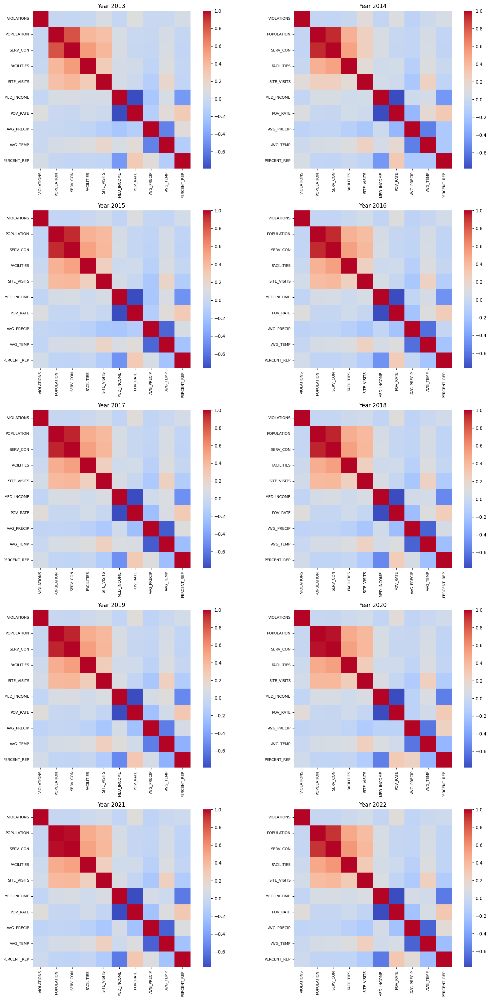

In [95]:
# Compute year-specific correlation matrices
time_corr = {}

for year in data['YEAR_FAC'].unique():
    time_corr[year] = data[data['YEAR_FAC'] == year][numeric_columns].corr()

# Create a grid of subplots for the heatmaps
num_years = len(time_corr)
num_rows = (num_years + 1) // 2
fig, axes = plt.subplots(num_rows, 2, figsize=(16, num_rows * 6))
axes = axes.flatten()

# Iterate over each year and create a heatmap
for i, (year, corr) in enumerate(time_corr.items()):
    sns.heatmap(corr, annot=False, cmap='coolwarm', square=True, ax=axes[i])
    axes[i].set_title(f"Year {year}")
    axes[i].tick_params(axis='x', rotation=90, labelsize=8)
    axes[i].tick_params(axis='y', rotation=0, labelsize=8)

# Remove any unused subplots
for i in range(num_years, len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

## Temporal Correlation

In [96]:
# Function to investigate possible temporal correlation
def temporal_correlation_heatmap(data, response_var):
    corr_matrix = data.pivot(index='PWS_ID', columns='YEAR_FAC', values=response_var).corr()
    plt.figure(figsize=(8, 6))
    sns.heatmap(
        corr_matrix,
        cmap='coolwarm',
        annot=True,
        fmt='.2f',
        xticklabels=corr_matrix.columns,
        yticklabels=corr_matrix.index,
        cbar_kws={'label': 'Correlation Coefficient', 'orientation': 'vertical'},
        annot_kws={'size': 10}
    )
    plt.xticks(fontsize=10, rotation=45)
    plt.yticks(fontsize=10)
    plt.xlabel('Year')
    plt.ylabel('Year')
    plt.title(f'Correlation Matrix of {response_var.capitalize()} Across Time', fontsize=14)
    plt.tight_layout()
    plt.show()

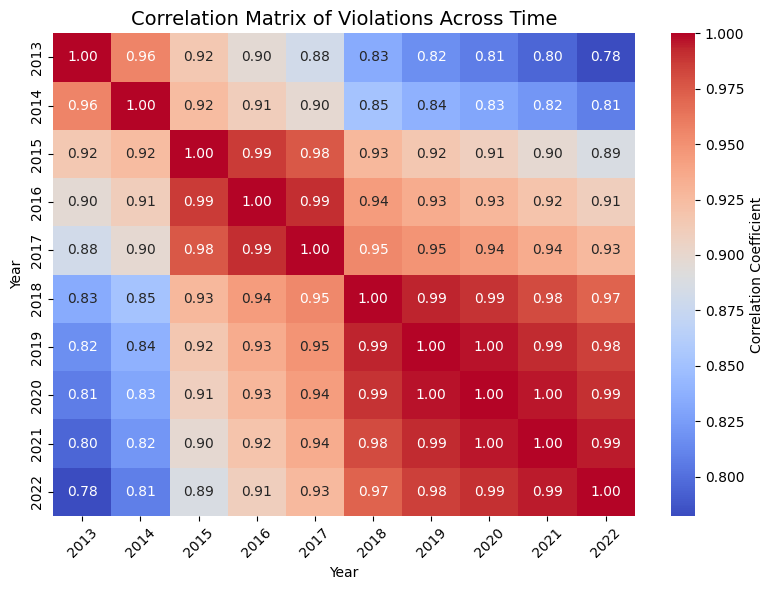

In [97]:
# Use the function
temporal_correlation_heatmap(data, 'VIOLATIONS')

## Relationship Scatterplots

In [101]:
# Function to examine scatterplot of violations and a numeric variable
def examine_variable_relationship(data, numeric_var, response_var):
    for year in data['YEAR_FAC'].unique():
        year_data = data[data['YEAR_FAC'] == year]
        year_data.plot.scatter(x=numeric_var, y=response_var)

        plt.xlabel(numeric_var, fontsize=12)
        plt.ylabel(response_var, fontsize=12)
        plt.title(f'Relationship Between {response_var} and {numeric_var} in {year}', fontsize=14)
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()

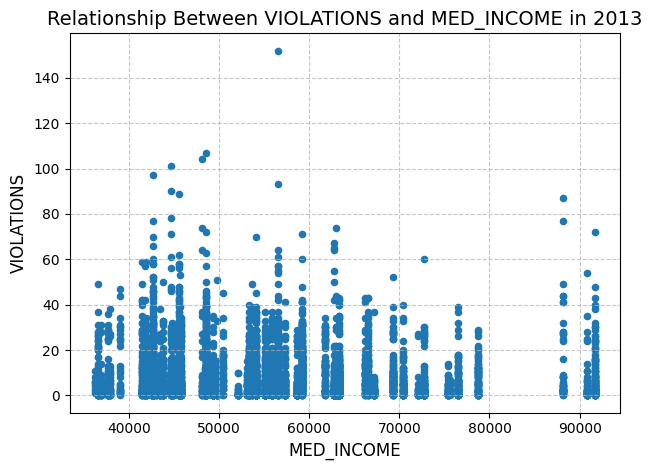

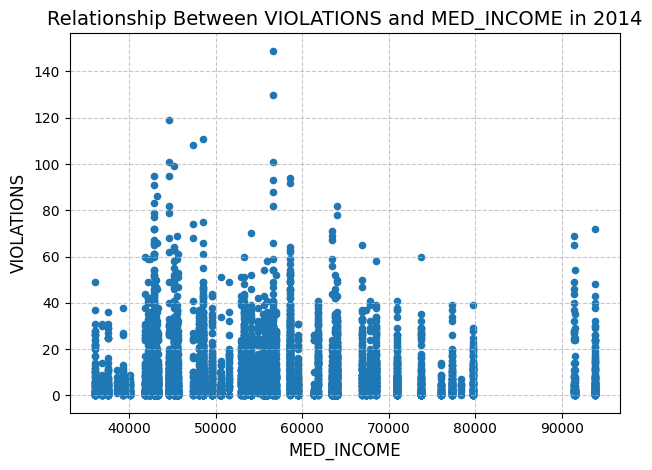

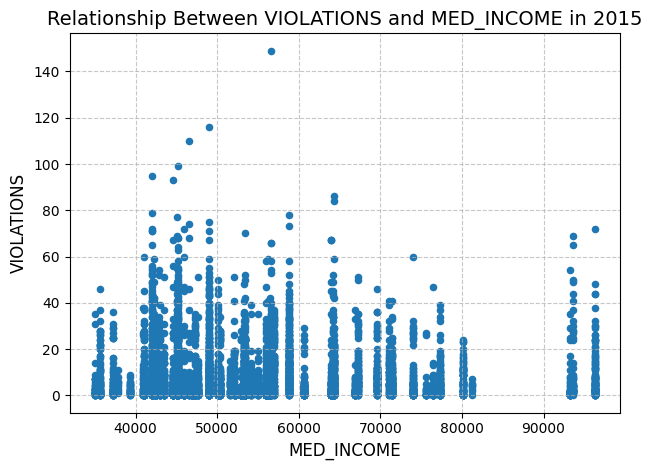

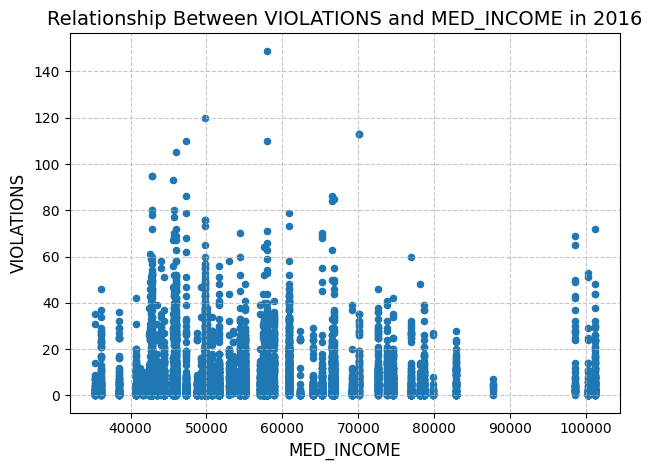

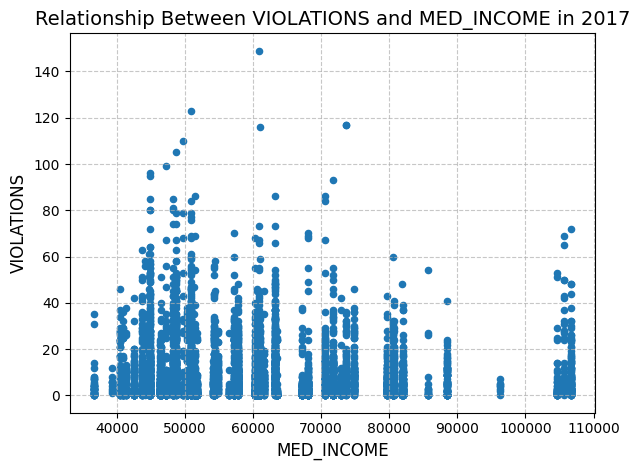

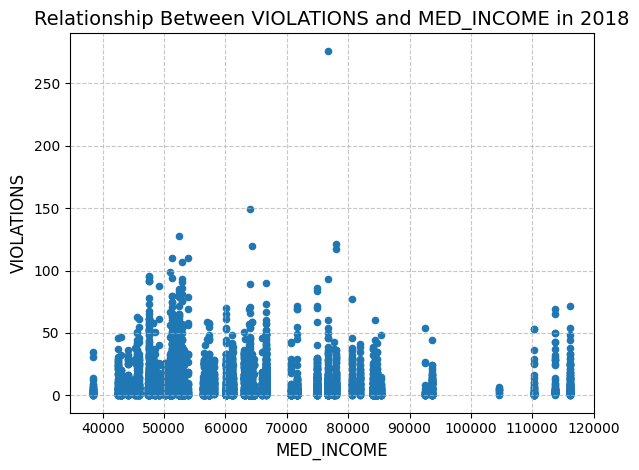

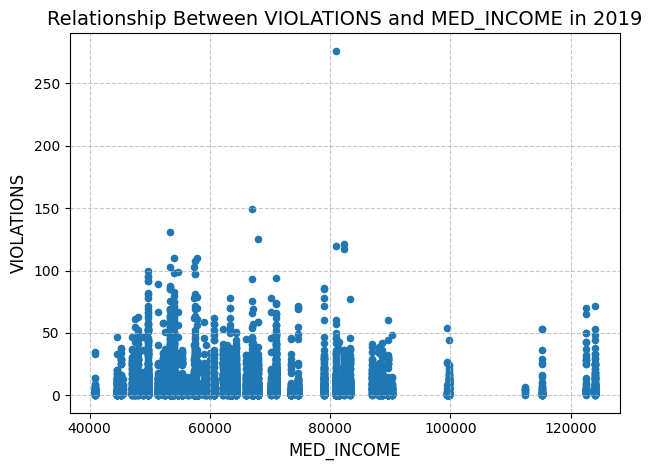

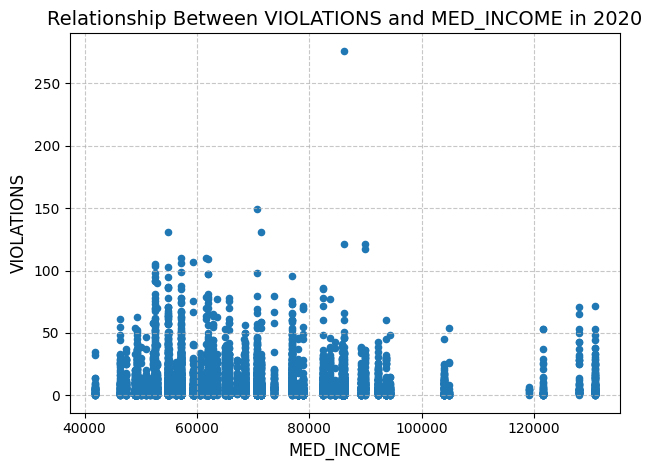

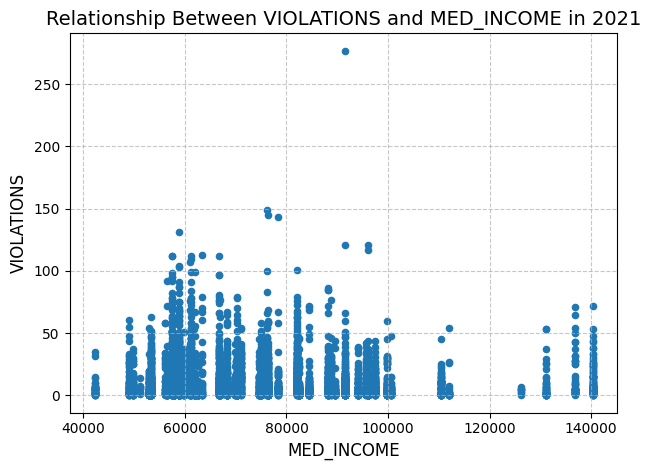

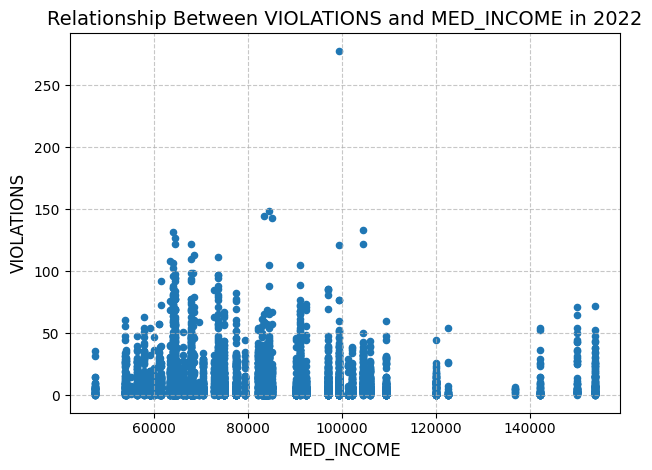

In [102]:
# Use the function
examine_variable_relationship(data, 'MED_INCOME', 'VIOLATIONS')

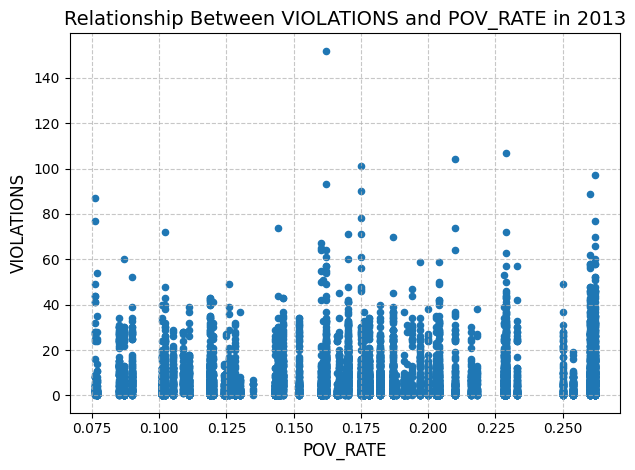

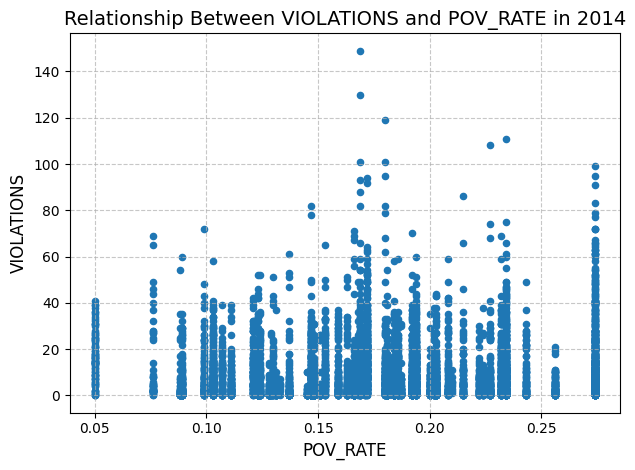

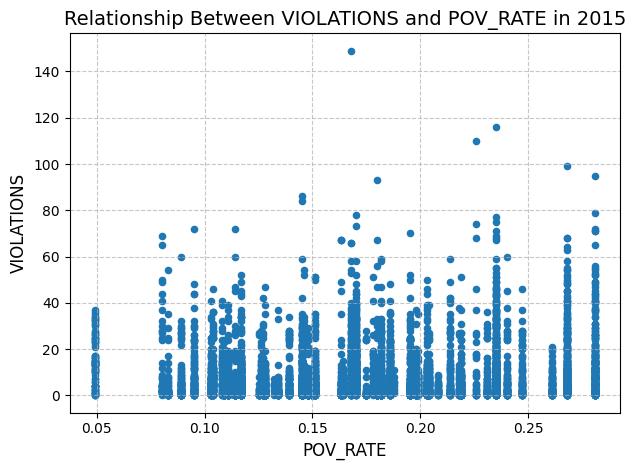

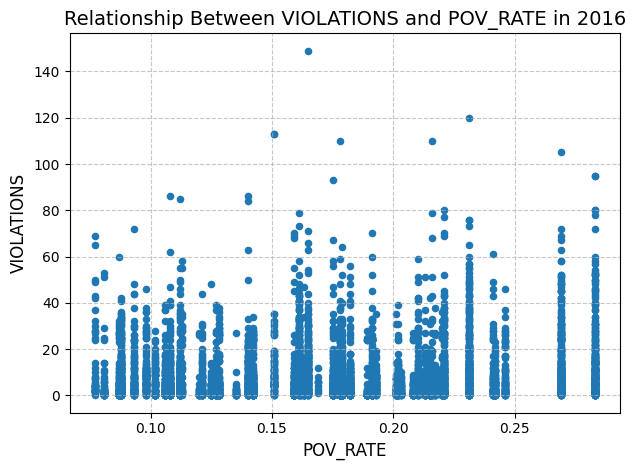

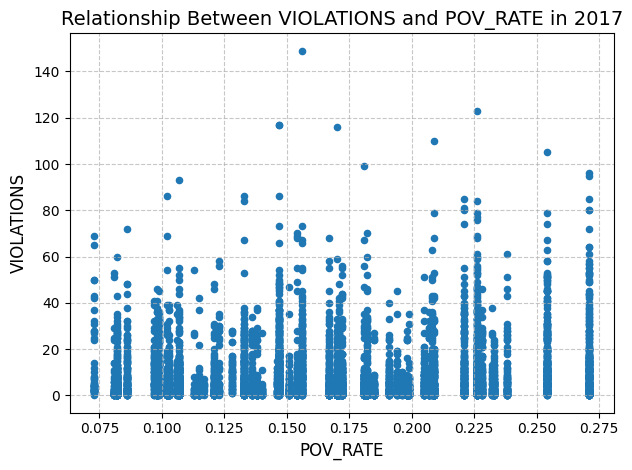

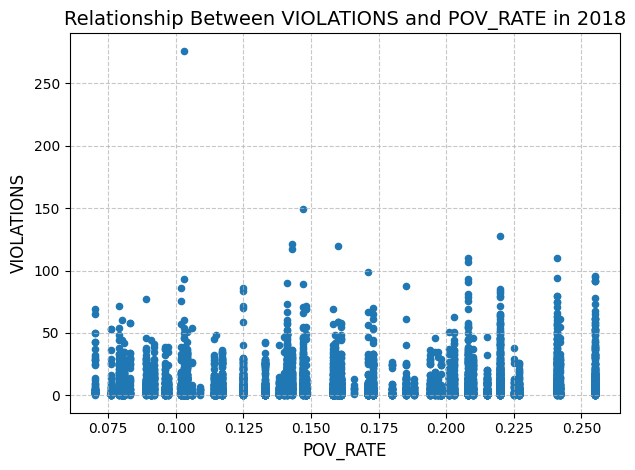

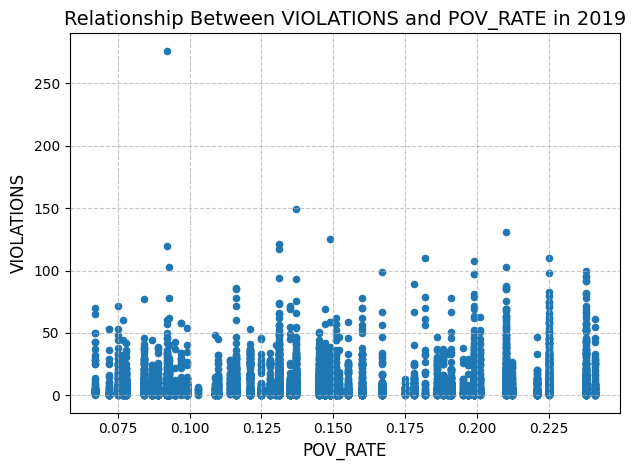

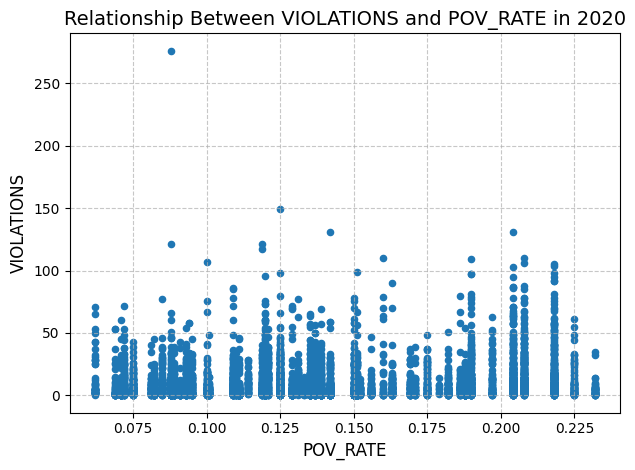

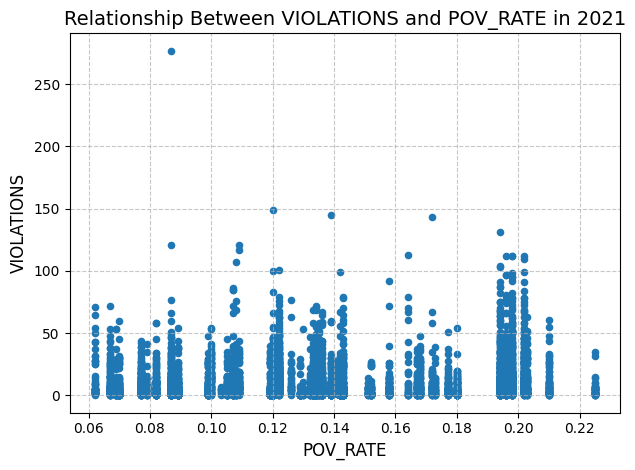

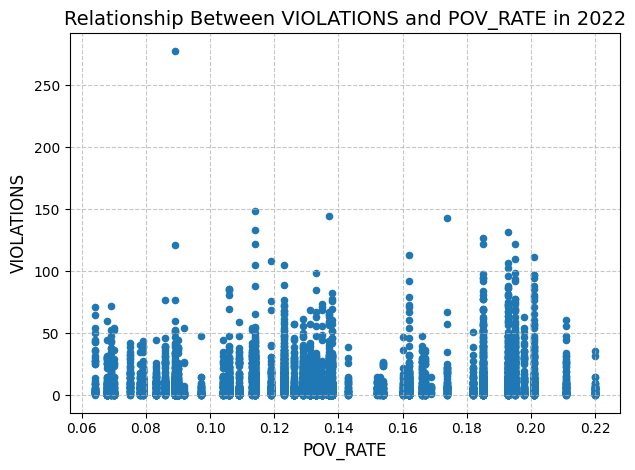

In [103]:
# Use the function
examine_variable_relationship(data, 'POV_RATE', 'VIOLATIONS')

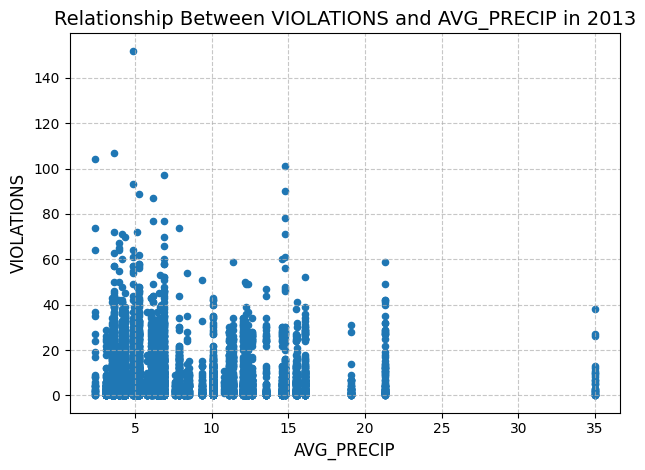

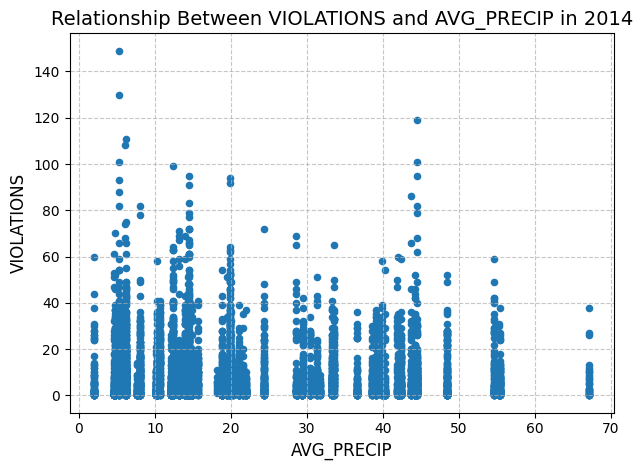

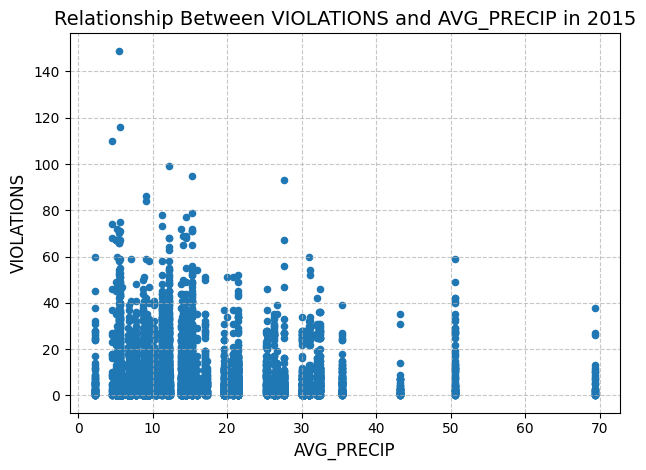

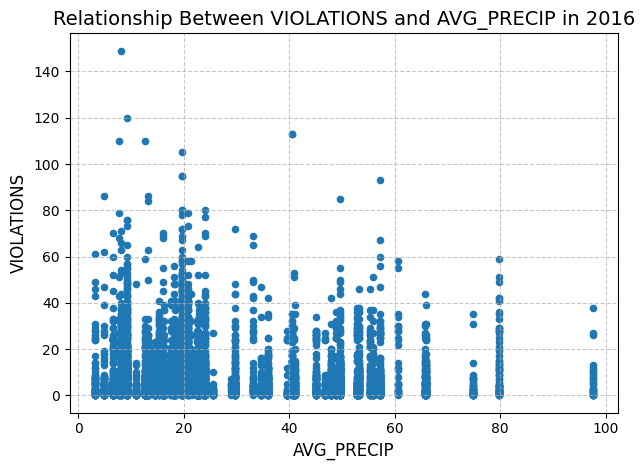

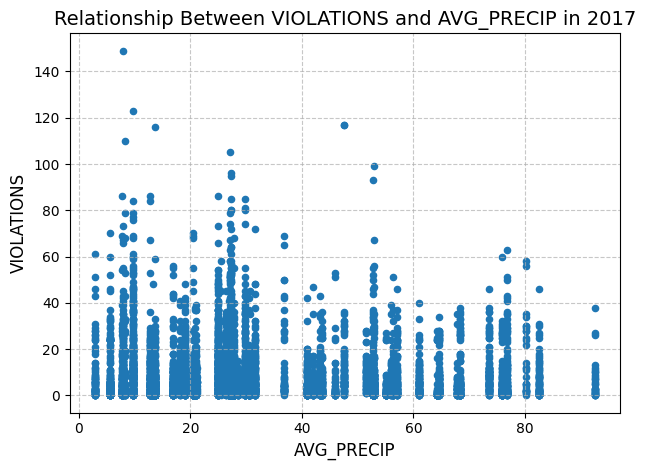

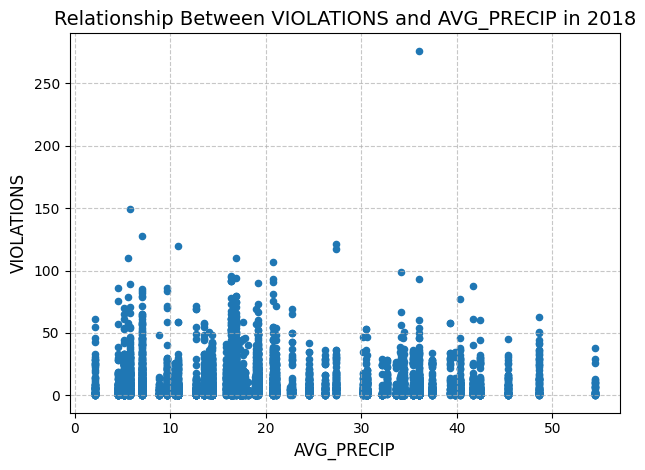

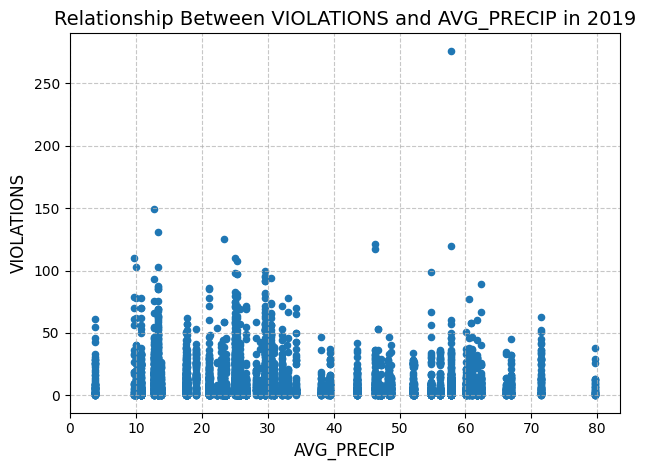

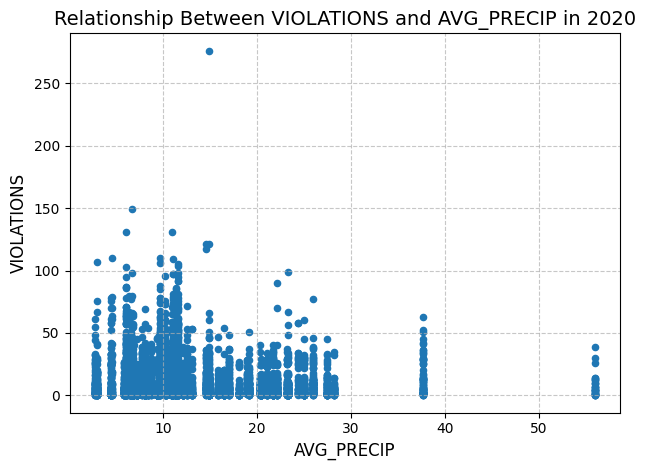

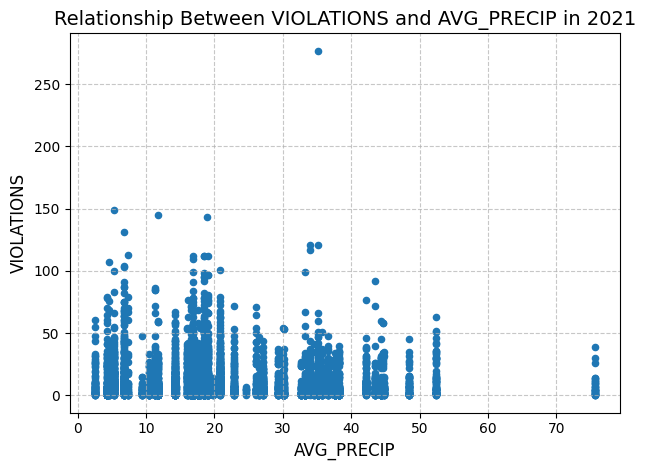

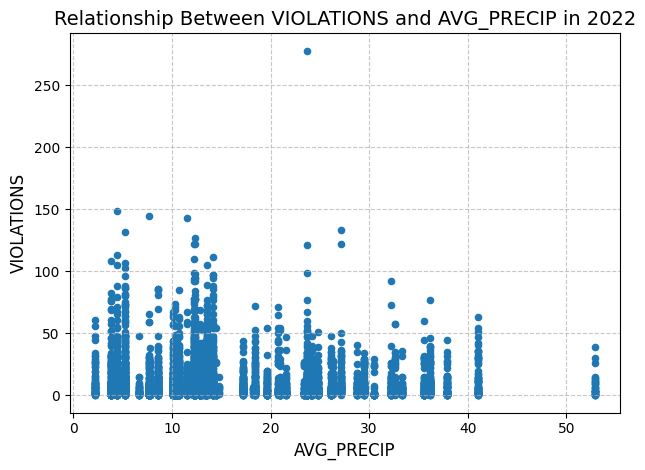

In [104]:
# Use the function
examine_variable_relationship(data, 'AVG_PRECIP', 'VIOLATIONS')

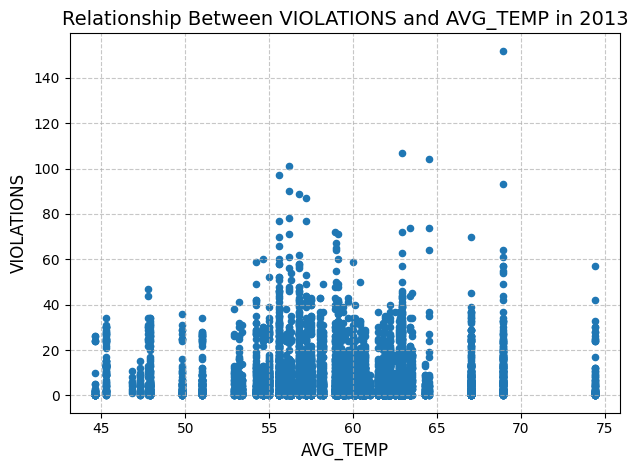

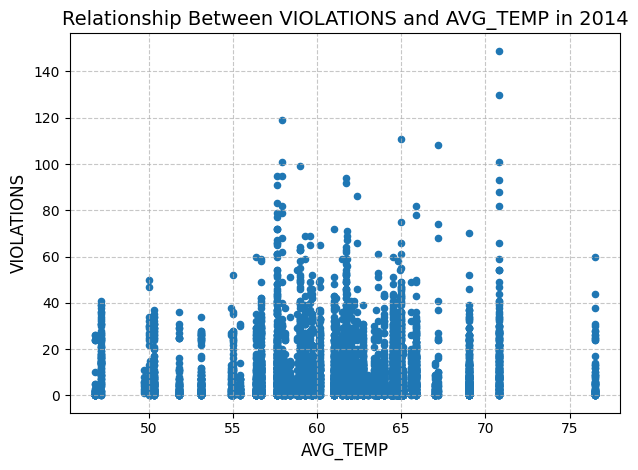

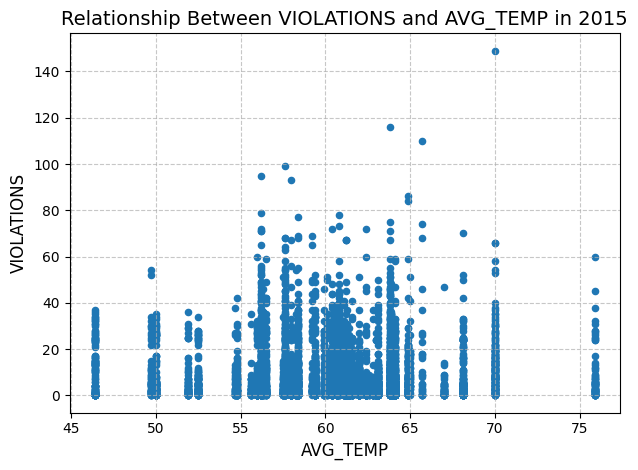

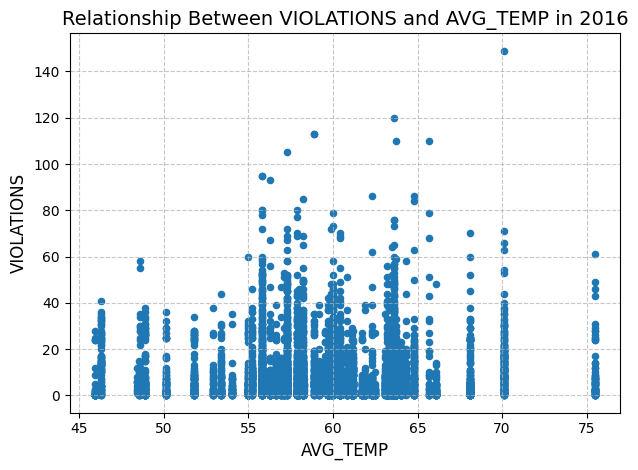

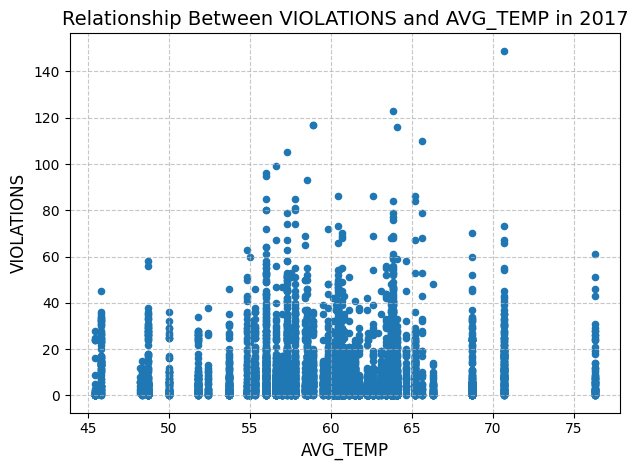

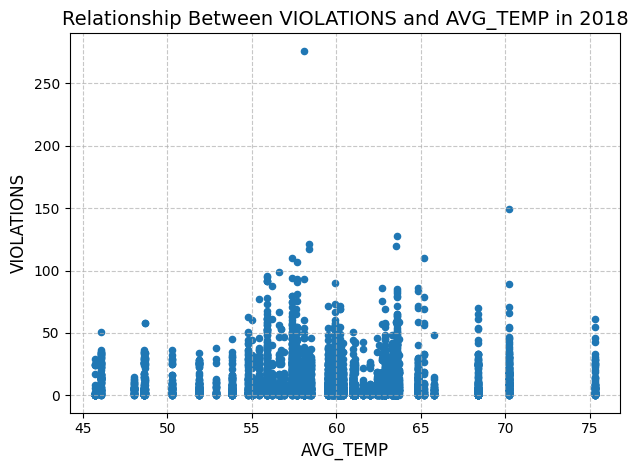

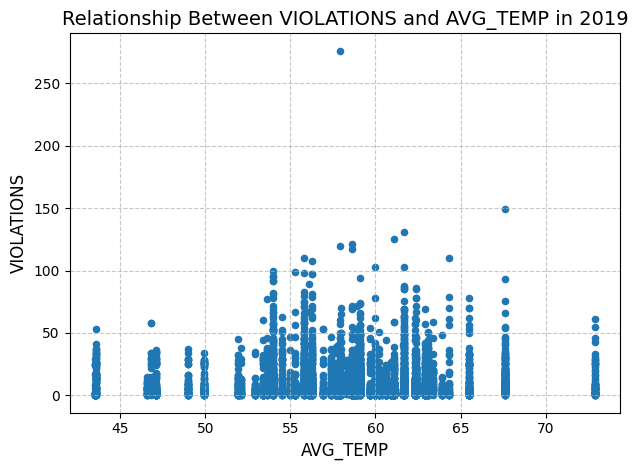

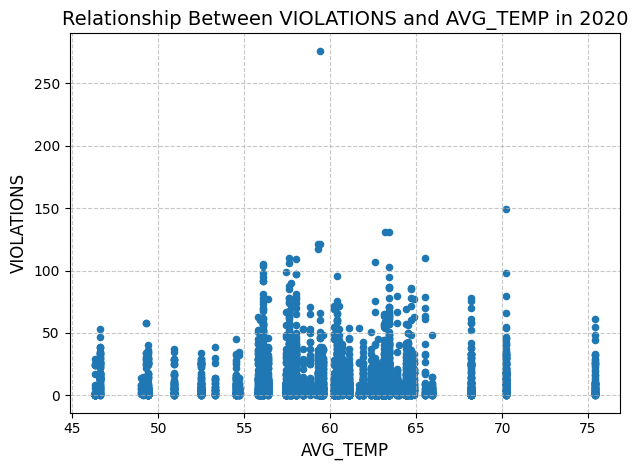

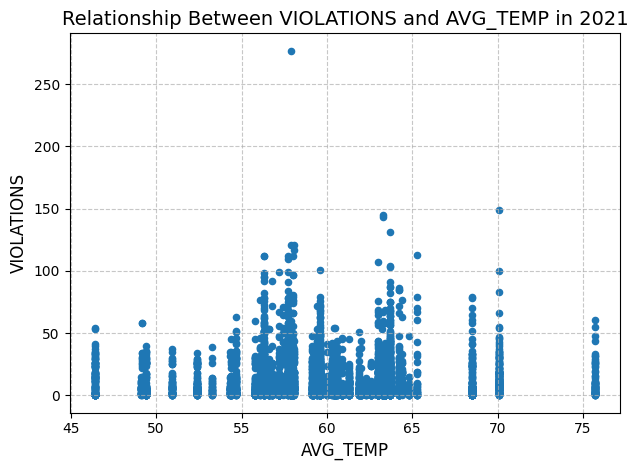

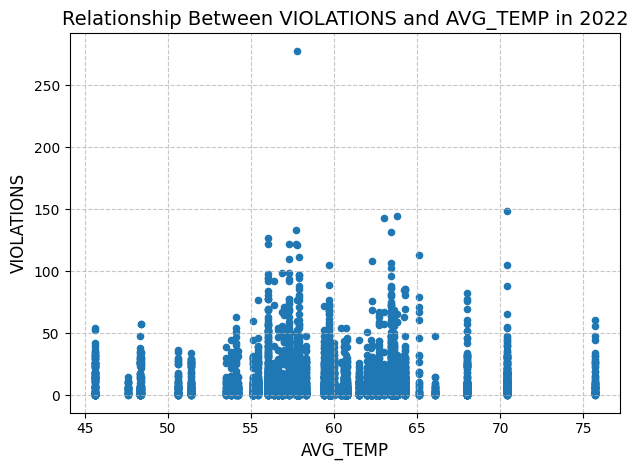

In [105]:
# Use the function
examine_variable_relationship(data, 'AVG_TEMP', 'VIOLATIONS')

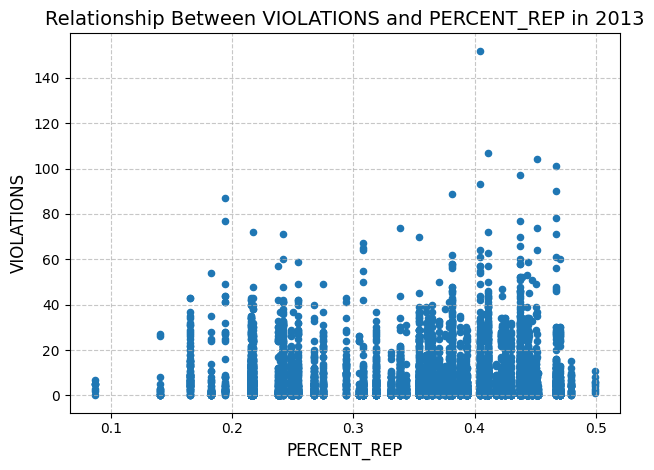

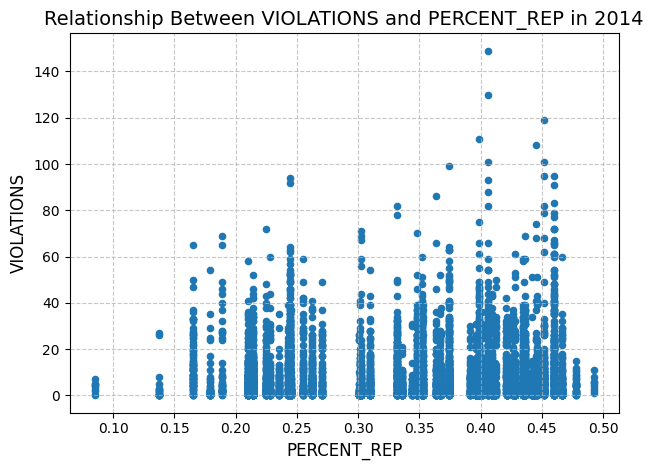

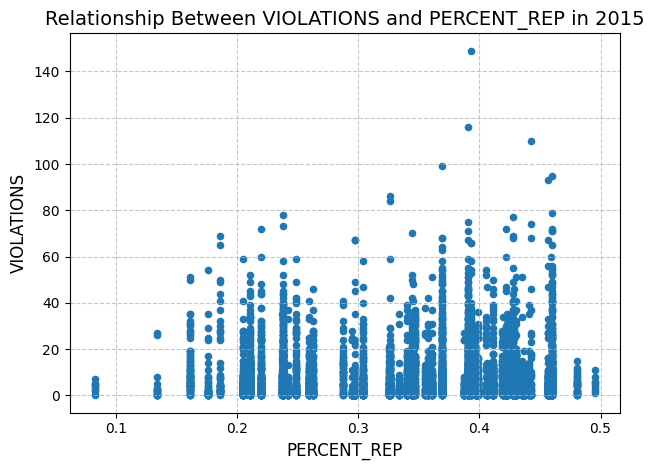

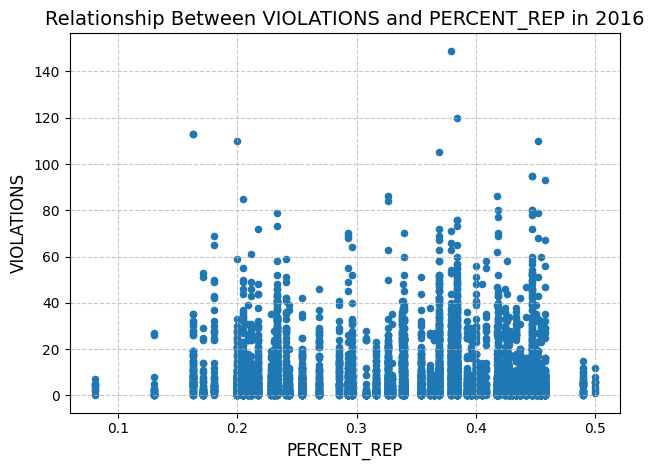

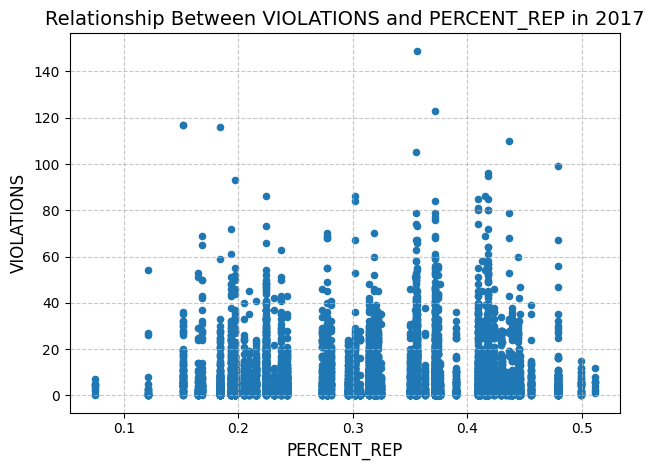

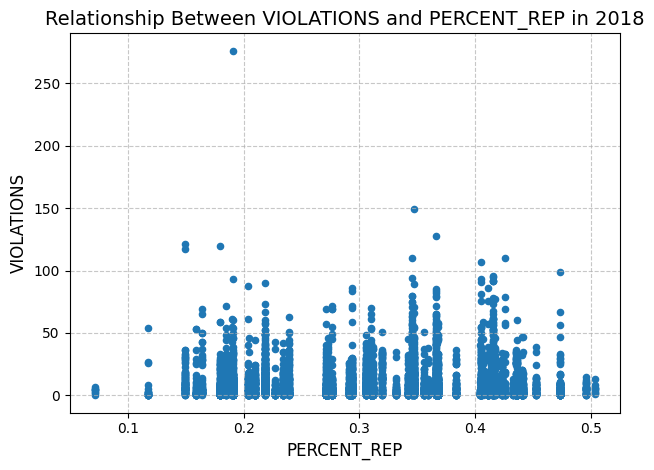

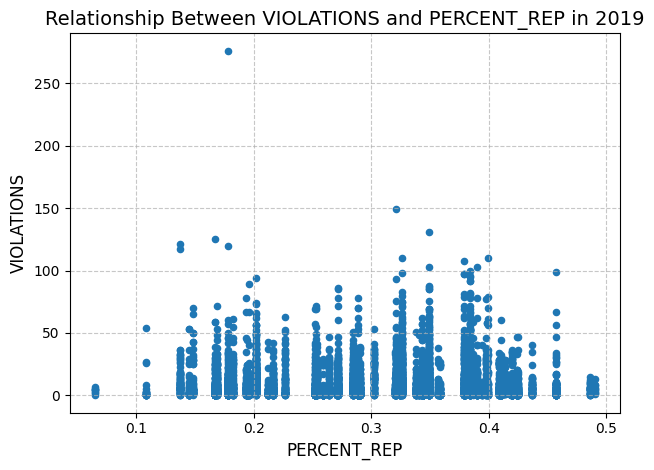

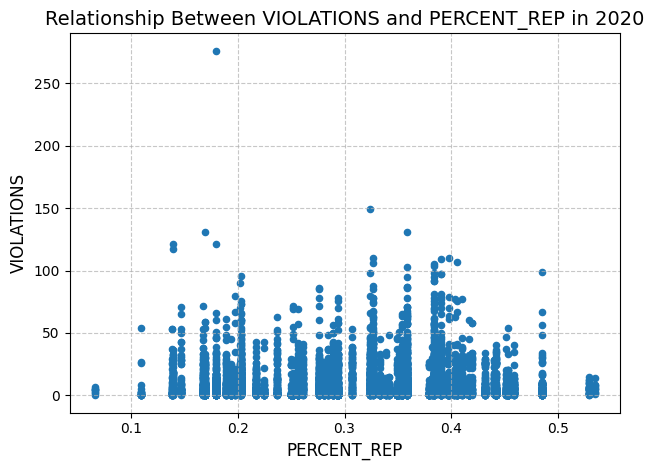

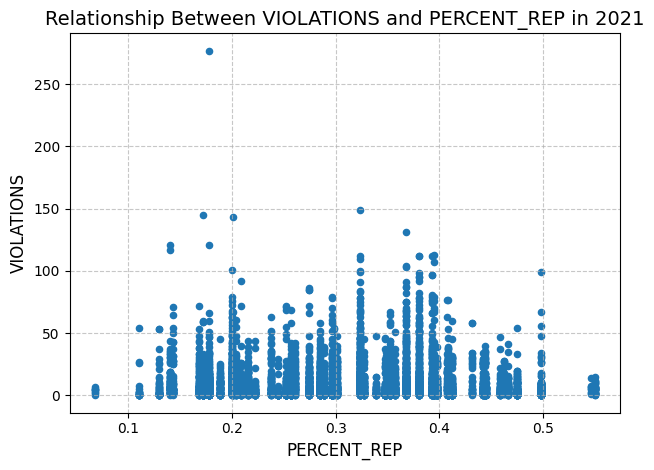

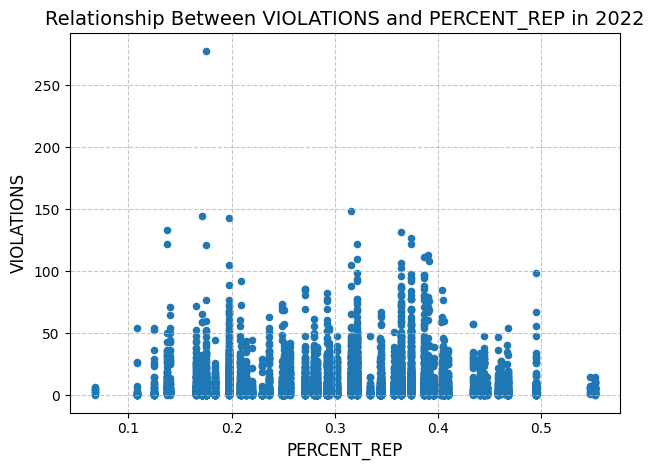

In [106]:
# Use the function
examine_variable_relationship(data, 'PERCENT_REP', 'VIOLATIONS')

# Geographical Analysis

## County Mean Violations Map

In [107]:
import geopandas as gpd
import folium
from IPython.display import display
import ipywidgets as widgets

# Load the California county shapefile
ca_counties = gpd.read_file('https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/california-counties.geojson')

In [108]:
# Convert 'created_at' and 'updated_at' columns to strings
ca_counties['created_at'] = ca_counties['created_at'].astype(str)
ca_counties['updated_at'] = ca_counties['updated_at'].astype(str)

In [109]:
# Rename the 'COUNTY' column to 'COUNTY' to match
ca_counties.rename(columns={'name': 'COUNTY'}, inplace=True)
ca_counties.head()

,COUNTY,cartodb_id,created_at,updated_at,geometry
0,Alameda,1,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"MULTIPOLYGON (((-122.31293 37.89733, -122.2884..."
1,Alpine,2,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"POLYGON ((-120.07239 38.70277, -119.96495 38.7..."
2,Amador,3,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"POLYGON ((-121.02726 38.48925, -121.02741 38.5..."
3,Butte,4,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"POLYGON ((-121.87925 39.30361, -121.90831 39.3..."
4,Calaveras,5,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"POLYGON ((-120.87605 38.02889, -120.91875 38.0..."


In [110]:
# Calculate the average number of VIOLATIONS by COUNTY over the full time period
county_violations = data.groupby(['COUNTY', 'YEAR_FAC'])['VIOLATIONS'].mean().reset_index()
county_violations

,COUNTY,YEAR_FAC,VIOLATIONS
0,Alameda,2013,3.952381
1,Alameda,2014,3.952381
2,Alameda,2015,3.952381
3,Alameda,2016,4.000000
4,Alameda,2017,6.476190
5,Alameda,2018,6.428571
6,Alameda,2019,6.428571
7,Alameda,2020,6.428571
8,Alameda,2021,6.428571
9,Alameda,2022,6.428571


In [111]:
# Pivot the data to create columns for each year
county_violations_pivot = county_violations.pivot(index='COUNTY', columns='YEAR_FAC', values='VIOLATIONS')
county_violations_pivot.fillna(0, inplace=True)  # Replace NaN with 0
county_violations_pivot

YEAR_FAC,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
COUNTY,,,,,,,,,,
Alameda,3.952381,3.952381,3.952381,4.000000,6.476190,6.428571,6.428571,6.428571,6.428571,6.428571
Alpine,4.146341,4.146341,4.000000,4.097561,4.219512,4.268293,4.268293,4.268293,4.268293,4.317073
Amador,8.704918,10.377049,6.262295,6.622951,6.836066,6.852459,6.885246,6.918033,7.131148,7.655738
Butte,7.602410,10.337349,7.000000,7.156627,7.277108,7.578313,7.638554,7.795181,7.843373,8.024096
Calaveras,10.574468,13.851064,9.382979,9.957447,10.085106,10.127660,10.148936,10.191489,10.340426,10.425532
Colusa,1.680000,1.680000,2.080000,2.800000,2.880000,3.560000,3.720000,3.840000,4.360000,5.040000
Contra Costa,7.872093,9.058140,6.883721,7.058140,7.337209,7.558140,7.581395,7.709302,7.779070,8.046512
Del Norte,6.903226,6.903226,6.903226,6.903226,6.967742,7.193548,7.548387,7.967742,8.096774,8.290323
El Dorado,9.561983,10.983471,9.702479,10.140496,10.214876,10.628099,10.702479,10.933884,11.115702,11.776860


In [112]:
# Merge the violations data with the county shapefile
ca_counties_merged = ca_counties.merge(county_violations_pivot, on='COUNTY')
ca_counties_merged.head()

,COUNTY,cartodb_id,created_at,updated_at,geometry,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Alameda,1,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"MULTIPOLYGON (((-122.31293 37.89733, -122.2884...",3.952381,3.952381,3.952381,4.000000,6.476190,6.428571,6.428571,6.428571,6.428571,6.428571
1,Alpine,2,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"POLYGON ((-120.07239 38.70277, -119.96495 38.7...",4.146341,4.146341,4.000000,4.097561,4.219512,4.268293,4.268293,4.268293,4.268293,4.317073
2,Amador,3,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"POLYGON ((-121.02726 38.48925, -121.02741 38.5...",8.704918,10.377049,6.262295,6.622951,6.836066,6.852459,6.885246,6.918033,7.131148,7.655738
3,Butte,4,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"POLYGON ((-121.87925 39.30361, -121.90831 39.3...",7.602410,10.337349,7.000000,7.156627,7.277108,7.578313,7.638554,7.795181,7.843373,8.024096
4,Calaveras,5,2015-07-04 21:04:58+00:00,2015-07-04 21:04:58+00:00,"POLYGON ((-120.87605 38.02889, -120.91875 38.0...",10.574468,13.851064,9.382979,9.957447,10.085106,10.127660,10.148936,10.191489,10.340426,10.425532


In [113]:
# Function to generate the map for a given year
def create_map(year):
    # Create a choropleth map
    m = folium.Map(location=[37.7749, -122.4194], zoom_start=6)

    folium.Choropleth(
        geo_data=ca_counties_merged,
        name=f'Violations in {year}',
        data=ca_counties_merged,
        columns=['COUNTY', year],
        key_on='feature.properties.COUNTY',
        fill_color='YlOrRd',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name=f'Average Violations in {year}'
    ).add_to(m)

    return m

In [120]:
# Create a dropdown widget for selecting the year
county_violations['YEAR'] = county_violations['YEAR_FAC'].astype(int)
year_dropdown = widgets.Dropdown(
    options=county_violations['YEAR'].unique(),
    description='Select Year:',
    value=county_violations['YEAR'].min()
)

In [121]:
# Create an output widget to display the map
map_output = widgets.Output()

In [122]:
# Function to update the map based on the selected year
def update_map(year):
    with map_output:
        map_output.clear_output()
        m = create_map(year)
        display(m)

In [123]:
# Observe changes in the dropdown value and update the map
year_dropdown.observe(lambda change: update_map(change['new']), names='value')

In [124]:
# Display the dropdown and map widgets
display(year_dropdown)
display(map_output)

Dropdown(description='Select Year:', options=(2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022), val…

Output()

In [125]:
# Initialize the map with the selected year
update_map(year_dropdown.value)

## County Owner Type Map

In [126]:
from folium.plugins import FloatImage

# Function to load the geo data
def load_data(shapefile_url):
    ca_counties = gpd.read_file(shapefile_url)
    ca_counties['created_at'] = ca_counties['created_at'].astype(str)
    ca_counties['updated_at'] = ca_counties['updated_at'].astype(str)
    ca_counties.rename(columns={'name': 'COUNTY'}, inplace=True)
    return ca_counties

# Use the function
shapefile_url = 'https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/california-counties.geojson'
ca_counties = load_data(shapefile_url)

In [128]:
# Create year dropdown
year_dropdown = widgets.Dropdown(
    options=data['YEAR_FAC'].unique(),
    description='Select Year:',
    value=data['YEAR_FAC'].astype(int).min()
)

# Create owner type dropdown
owner_type_dropdown = widgets.Dropdown(
    options=data['OWNER_TYPE'].unique(),
    description='Select Owner Type:',
    value=data['OWNER_TYPE'].unique()[0],
    layout=widgets.Layout(width='250px')
)

# Set output
owner_type_map_output = widgets.Output()

In [131]:
# Function to create owner type map
def create_owner_type_map(data, ca_counties, year, owner_type):
    owner_type_counts = data[(data['YEAR_FAC'] == year) & (data['OWNER_TYPE'] == owner_type)].groupby('COUNTY').size().reset_index(name='count')
    ca_counties_merged = ca_counties.merge(owner_type_counts, on='COUNTY', how='left').fillna(0)

    m = folium.Map(location=[37.7749, -122.4194], zoom_start=6)

    folium.Choropleth(
        geo_data=ca_counties_merged,
        name=f'{owner_type} Water Systems',
        data=ca_counties_merged,
        columns=['COUNTY', 'count'],
        key_on='feature.properties.COUNTY',
        fill_color='YlOrRd',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name=f'Number of {owner_type} Water Systems'
    ).add_to(m)

    # Add a legend using FloatImage
    legend_html = '''
    <div style="position: fixed; bottom: 50px; left: 50px; width: 150px; height: 90px;
                border:2px solid grey; z-index:9999; font-size:14px;
                ">&nbsp; Number of {owner_type} Water Systems <br>
    <img src="https://i.imgur.com/1p98DKX.png" style="width: 100%">
    </div>
    '''.format(owner_type=owner_type)
    FloatImage(legend_html, bottom=50, left=50).add_to(m)

    return m

In [132]:
# Functions to update owner type map
def update_owner_type_map(year, owner_type):
    with owner_type_map_output:
        owner_type_map_output.clear_output()
        m = create_owner_type_map(data, ca_counties, year, owner_type)
        display(m)

def on_update(change):
    update_owner_type_map(year_dropdown.value, owner_type_dropdown.value)

year_dropdown.observe(on_update, names='value')
owner_type_dropdown.observe(on_update, names='value')

display(year_dropdown)
display(owner_type_dropdown)
display(owner_type_map_output)
update_owner_type_map(year_dropdown.value, owner_type_dropdown.value)

Dropdown(description='Select Year:', options=(2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022), val…

Dropdown(description='Select Owner Type:', layout=Layout(width='250px'), options=('Private', 'Public', 'PPP'),…

Output()

## County Level Variable Maps

In [133]:
# Get the geo data
shapefile_url = 'https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/california-counties.geojson'
ca_counties = load_data(shapefile_url)

In [134]:
# Function to create county variable map
def create_county_var_map(data, ca_counties, year, var_name):
    county_var_data = data[data['YEAR_FAC'] == year].groupby('COUNTY')[var_name].mean().reset_index()
    ca_counties_merged = ca_counties.merge(county_var_data, on='COUNTY', how='left')

    m = folium.Map(location=[37.7749, -122.4194], zoom_start=6)

    folium.Choropleth(
        geo_data=ca_counties_merged,
        name=f'{var_name}',
        data=ca_counties_merged,
        columns=['COUNTY', var_name],
        key_on='feature.properties.COUNTY',
        fill_color='YlOrRd',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name=f'{var_name}'
    ).add_to(m)

    # Add a legend using FloatImage
    legend_html = '''
    <div style="position: fixed; bottom: 50px; left: 50px; width: 150px; height: 90px;
                border:2px solid grey; z-index:9999; font-size:14px;
                ">&nbsp; {var_name} <br>
    <img src="https://i.imgur.com/1p98DKX.png" style="width: 100%">
    </div>
    '''.format(var_name=var_name)
    FloatImage(legend_html, bottom=50, left=50).add_to(m)

    return m

In [136]:
# Create year dropdown
year_dropdown = widgets.Dropdown(
    options=data['YEAR_FAC'].unique(),
    description='Select Year:',
    value=data['YEAR_FAC'].astype(int).min()
)

# Create variable dropdown with multiple suffixes
suffixes = ('INCOME', 'RATE', 'PRECIP', 'TEMP', 'REP', 'DEM', 'OTH')
county_vars = [col for col in data.columns if col.endswith(suffixes)]
var_dropdown = widgets.Dropdown(
    options=county_vars,
    description='Select Variable:',
    value=county_vars[0] if county_vars else None,
    layout=widgets.Layout(width='250px')
)

# Set output
county_var_map_output = widgets.Output()

In [137]:
# Functions to update county variable map
def update_county_var_map(year, var_name):
    with county_var_map_output:
        county_var_map_output.clear_output()
        m = create_county_var_map(data, ca_counties, year, var_name)
        display(m)

def on_update(change):
    update_county_var_map(year_dropdown.value, var_dropdown.value)

year_dropdown.observe(on_update, names='value')
var_dropdown.observe(on_update, names='value')

display(year_dropdown)
display(var_dropdown)
display(county_var_map_output)
update_county_var_map(year_dropdown.value, var_dropdown.value)

Dropdown(description='Select Year:', options=(2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022), val…

Dropdown(description='Select Variable:', layout=Layout(width='250px'), options=('MED_INCOME', 'POV_RATE', 'AVG…

Output()

# Trajectory Analysis

## Individual Trajectories

In [138]:
# Function to examine individual trajectories
def visualize_individual_trajectories(data, pws_ids, response_var):
    plt.figure(figsize=(12, 6))

    colors = ['blue', 'red', 'green', 'orange', 'purple']

    for i, pws_id in enumerate(pws_ids):
        pws_data = data[data['PWS_ID'] == pws_id]
        plt.plot(pws_data['YEAR_FAC'], pws_data[response_var], marker='o', linestyle='-', color=colors[i], label=pws_id)

    plt.xlabel('Year', fontsize=12)
    plt.ylabel(response_var.capitalize(), fontsize=12)

    plt.xticks(data['YEAR_FAC'].unique(), fontsize=10, rotation=45)
    plt.yticks(fontsize=10)

    plt.legend(title='PWS ID', fontsize=10, title_fontsize=12)

    plt.grid(True, linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()

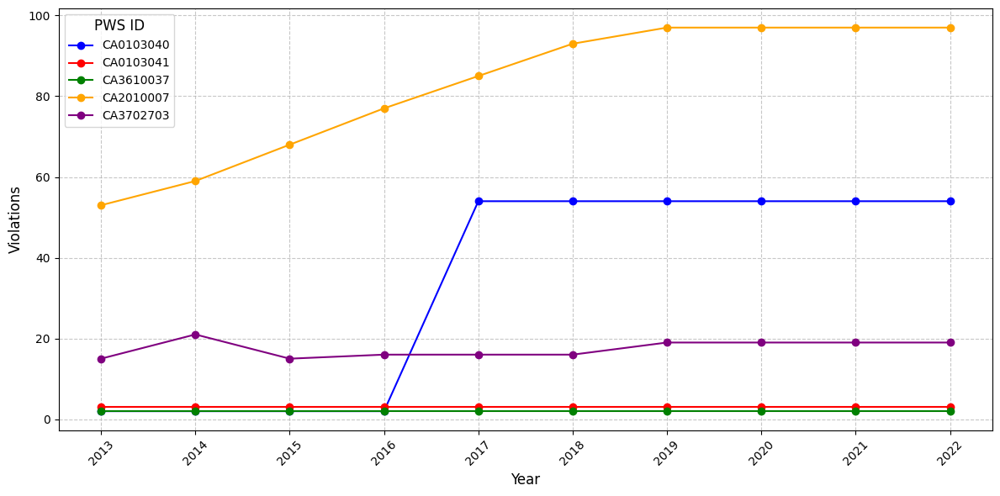

In [139]:
# Use the function
visualize_individual_trajectories(
    data,
    ['CA0103040', 'CA0103041', 'CA3610037', 'CA2010007', 'CA3702703'],
    'VIOLATIONS'
)

## Group Trajectories

In [140]:
# Function to examine group trajectories
def visualize_group_trajectories(data, group_var, response_var):
    plt.figure(figsize=(12, 6))

    # Generate a unique color palette
    unique_groups = data[group_var].unique()
    colors = plt.get_cmap('tab10').colors[:len(unique_groups)]

    for i, group in enumerate(unique_groups):
        group_data = data[data[group_var] == group].groupby('YEAR_FAC')[response_var].mean()
        plt.plot(group_data.index, group_data.values, marker='o', linestyle='-', color=colors[i], label=group)

    plt.xlabel('Year', fontsize=12)
    plt.ylabel(f'Mean {response_var.capitalize()}', fontsize=12)

    plt.xticks(data['YEAR_FAC'].unique(), fontsize=10, rotation=45)
    plt.yticks(fontsize=10)

    plt.legend(title=group_var.replace('_', ' ').title(), fontsize=10, title_fontsize=12)

    plt.grid(True, linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()

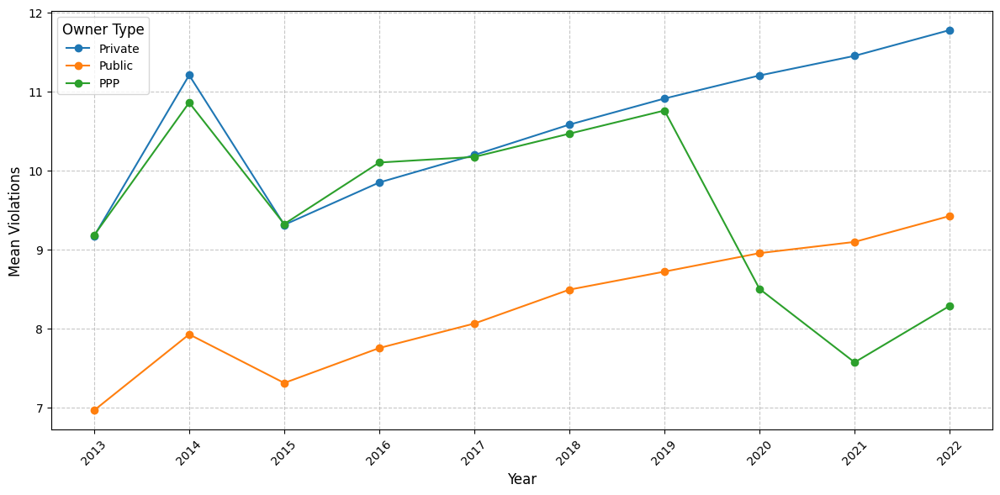

In [141]:
# Use the function
visualize_group_trajectories(data, 'OWNER_TYPE', 'VIOLATIONS')

In [142]:
# Function to examine group trajectories with variability
def visualize_group_trajectories_with_variability(data, group_var, response_var):
    plt.figure(figsize=(12, 6))

    unique_groups = data[group_var].unique()
    colors = plt.get_cmap('tab10').colors[:len(unique_groups)]

    for i, group in enumerate(unique_groups):
        group_data = data[data[group_var] == group].groupby('YEAR_FAC')[response_var]

        mean_values = group_data.mean()
        std_values = group_data.std()

        years = mean_values.index

        # Plot the mean trajectory
        plt.plot(years, mean_values.values, marker='o', linestyle='-', color=colors[i], label=group)

        # Calculate the lower and upper bounds to ensure no negative values
        lower_bound = np.maximum(mean_values.values - std_values.values, 0)
        upper_bound = mean_values.values + std_values.values

        # Plot the variability
        plt.fill_between(years, lower_bound, upper_bound, color=colors[i], alpha=0.2)

    plt.xlabel('Year', fontsize=12)
    plt.ylabel(f'Mean {response_var.capitalize()}', fontsize=12)

    plt.xticks(data['YEAR_FAC'].unique(), fontsize=10, rotation=45)
    plt.yticks(fontsize=10)

    plt.legend(title=group_var.replace('_', ' ').title(), fontsize=10, title_fontsize=12)

    plt.grid(True, linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()

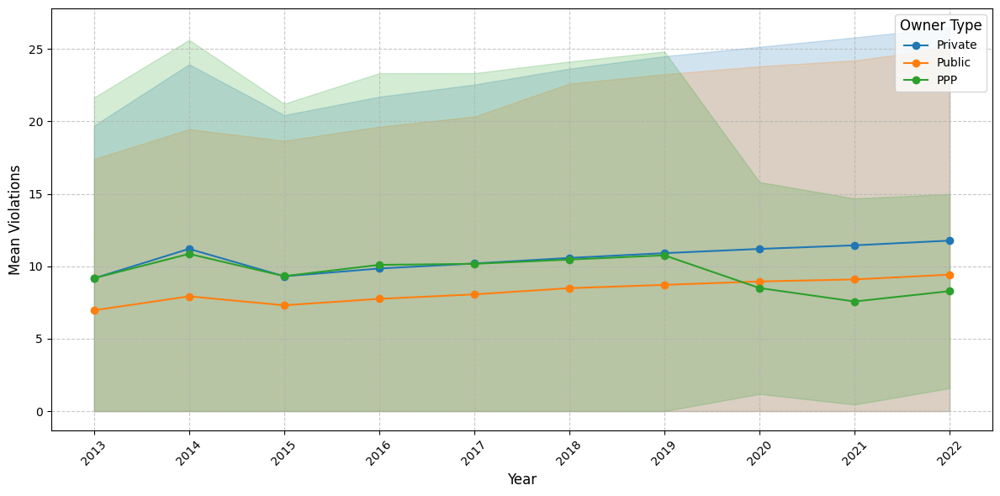

In [143]:
# Use the function
visualize_group_trajectories_with_variability(data, 'OWNER_TYPE', 'VIOLATIONS')

In [144]:
from cycler import cycler

# Function to visualize group trajectories with many groups
def visualize_group_trajectories_with_many(data, group_var, response_var):
    plt.figure(figsize=(12, 6))

    unique_groups = data[group_var].unique()
    color_map = plt.get_cmap('tab20')
    num_colors = color_map.N

    # Create a cycler for repeating colors if there are more groups than colors
    color_cycler = cycler('color', [color_map(i) for i in range(num_colors)])
    plt.gca().set_prop_cycle(color_cycler)

    for group in unique_groups:
        group_data = data[data[group_var] == group].groupby('YEAR_FAC')[response_var]

        mean_values = group_data.mean()
        years = mean_values.index

        # Plot the mean trajectory
        plt.plot(years, mean_values.values, marker='o', linestyle='-', label=group)

    plt.xlabel('Year', fontsize=12)
    plt.ylabel(f'Mean {response_var.capitalize()}', fontsize=12)

    plt.xticks(data['YEAR_FAC'].unique(), fontsize=10, rotation=45)
    plt.yticks(fontsize=10)

    sample_labels = unique_groups[:3]
    for group in sample_labels:
        group_data = data[data[group_var] == group].groupby('YEAR_FAC')[response_var].mean()
        years = group_data.index
        plt.text(years[-1], group_data.values[-1], group, fontsize=10, ha='left', va='center')

    plt.grid(True, linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()

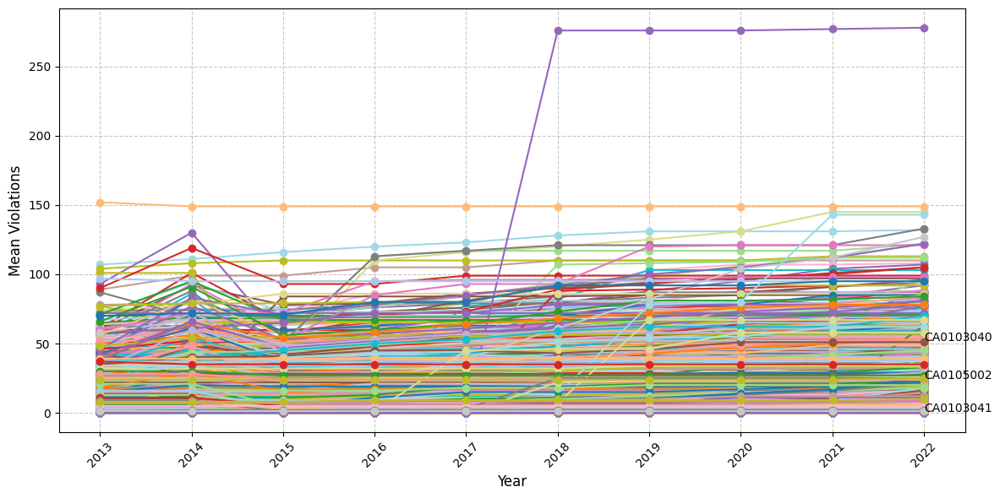

In [145]:
# Use the function
visualize_group_trajectories_with_many(data, 'PWS_ID', 'VIOLATIONS')

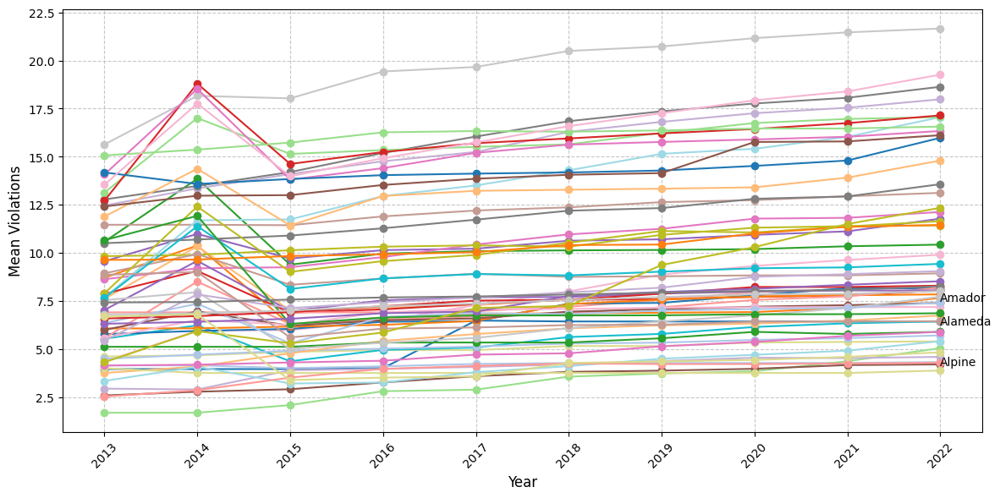

In [146]:
# Use the function
visualize_group_trajectories_with_many(data, 'COUNTY', 'VIOLATIONS')

## Spatial Distributions

In [147]:
# Function to plot the spatial distribution via scatterplots
def plot_spatial_distribution(data, response_var, spatial_var, max_legend_groups=10):
    spatial_data = data.groupby([spatial_var, 'YEAR_FAC'])[response_var].mean().reset_index()

    # Determine the number of unique spatial groups
    num_groups = spatial_data[spatial_var].nunique()

    # Create the scatter plot
    plt.figure(figsize=(12, 6))
    sns.scatterplot(data=spatial_data, x='YEAR_FAC', y=response_var, hue=spatial_var)

    plt.xlabel('Year')
    plt.ylabel(f'Mean {response_var.capitalize()}')

    # Conditionally include a legend
    if num_groups <= max_legend_groups:
        plt.legend(title=spatial_var, bbox_to_anchor=(1.05, 1), loc='upper left')
    else:
        plt.legend([], [], frameon=False)

    all_years = sorted(data['YEAR_FAC'].unique())
    plt.xticks(all_years)

    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

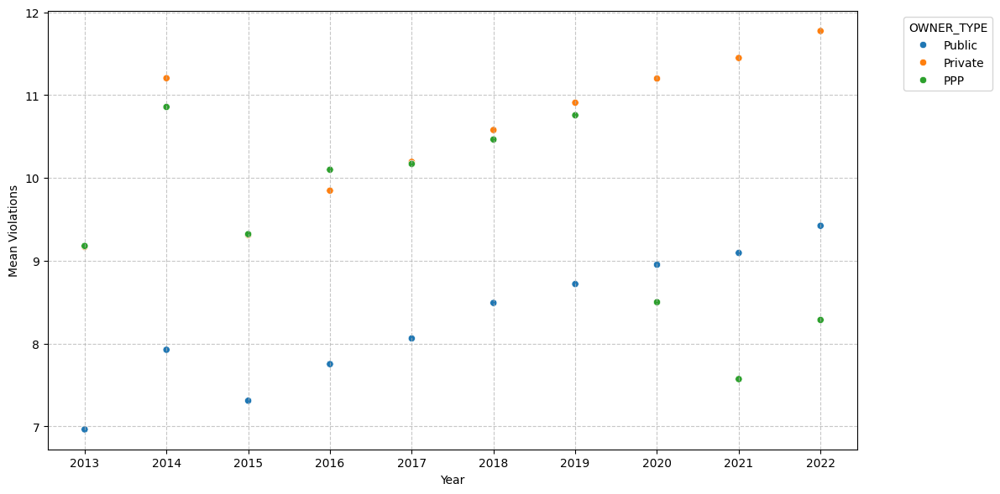

In [148]:
# Use the function
plot_spatial_distribution(data, 'VIOLATIONS', 'OWNER_TYPE')

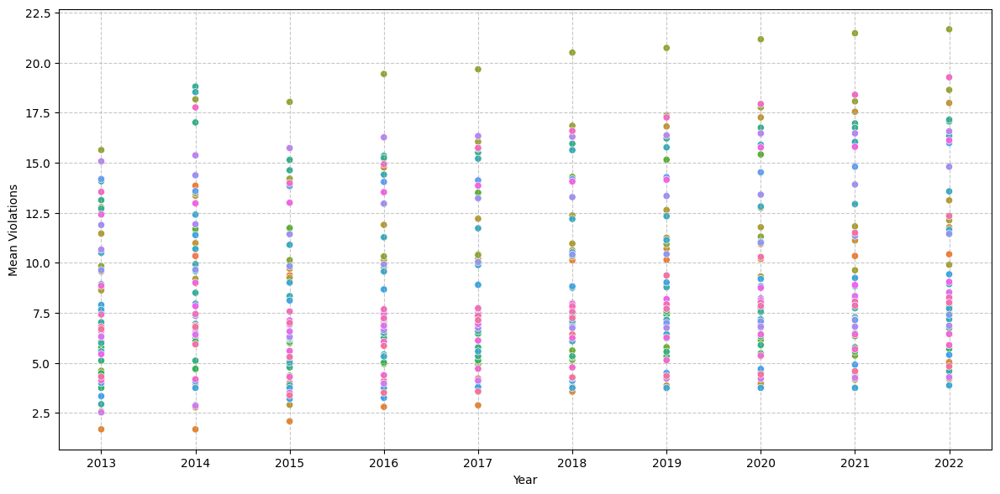

In [149]:
# Use the function
plot_spatial_distribution(data, 'VIOLATIONS', 'COUNTY')

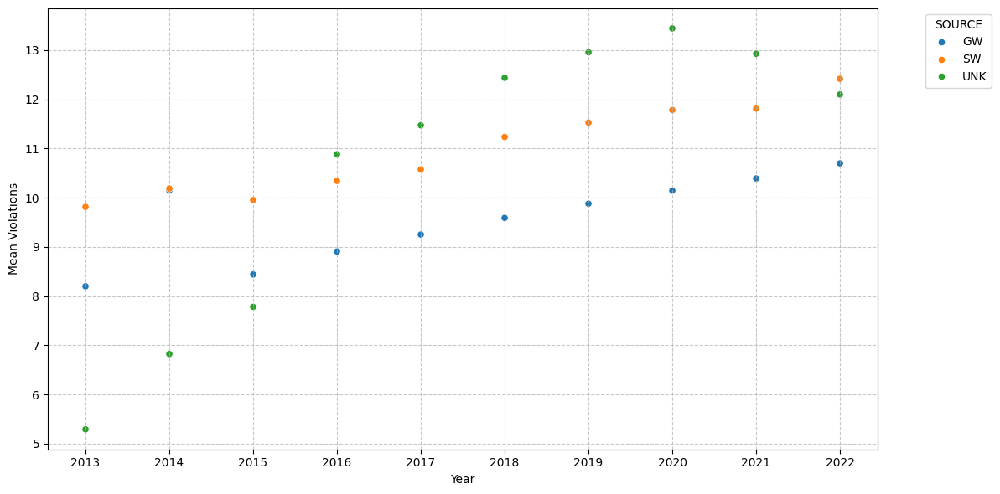

In [150]:
# Use the function
plot_spatial_distribution(data, 'VIOLATIONS', 'SOURCE')

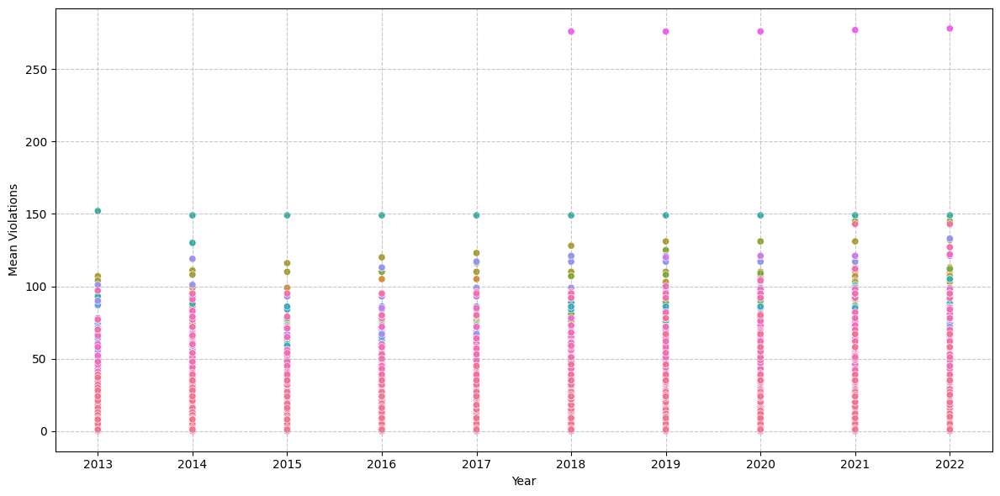

In [151]:
# Use the function
plot_spatial_distribution(data, 'VIOLATIONS', 'PWS_ID')

# Multicollinearity Check

In [152]:
# Function to check for multicollinearity
def check_multicollinearity(data, threshold=0.7):
    # Select the numeric columns
    numeric_cols = data.select_dtypes(include=[np.number]).columns

    # Create a correlation matrix
    corr_matrix = data[numeric_cols].corr()

    # Get the upper triangle of the correlation matrix (excluding the diagonal)
    upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

    # Find the columns with high correlations above the threshold
    high_corr_cols = [column for column in upper_tri.columns if any(upper_tri[column] > threshold)]

    if len(high_corr_cols) > 0:
        print("Columns with high multicollinearity:")
        for column in high_corr_cols:
            corr_cols = upper_tri.index[upper_tri[column] > threshold].tolist()
            print(f" - {column}: {', '.join(corr_cols)}")
    else:
        print("No multicollinearity detected.")

In [160]:
# Use the function
columns_to_drop = ['YEAR_FULL', 'YEAR', 'YEAR_NEW']
existing_columns_to_drop = [col for col in columns_to_drop if col in data.columns]

check_multicollinearity(data.drop(columns=existing_columns_to_drop))

Columns with high multicollinearity:
 - SERV_CON: POPULATION


In [161]:
from statsmodels.tools.tools import add_constant
from statsmodels.regression.linear_model import OLS

# Function to calculate the Variance Inflation Factor
def calculate_vif(data):
    # Select the numeric columns
    numeric_cols = data.select_dtypes(include=[np.number]).columns

    # Add a constant term to the data
    data_with_constant = add_constant(data[numeric_cols])

    # Create an empty DataFrame to store the VIF values
    vif_df = pd.DataFrame()

    for col in numeric_cols:
        # Fit a linear regression model with the current column as the dependent variable
        # and all other columns as independent variables
        model = OLS(data_with_constant[col], data_with_constant.drop(columns=[col])).fit()

        # Calculate the VIF for the current column
        vif = 1 / (1 - model.rsquared)

        # Store the VIF value in the DataFrame
        vif_df.loc[col, 'VIF'] = vif

    return vif_df

In [162]:
# Use the function
columns_to_drop = ['YEAR_FULL', 'YEAR', 'YEAR_NEW']
existing_columns_to_drop = [col for col in columns_to_drop if col in data.columns]

vif_df = calculate_vif(data.drop(columns=existing_columns_to_drop))
vif_df

,VIF
POPULATION,7.763133e+00
SERV_CON,8.606892e+00
FACILITIES,1.382232e+00
VIOLATIONS,1.029273e+00
SITE_VISITS,1.258599e+00
MED_INCOME,3.203831e+00
POV_RATE,2.733510e+00
AVG_PRECIP,1.578329e+00
AVG_TEMP,1.557806e+00
PERCENT_REP,1.746831e+07


# County Aggregation

In [178]:
# Create county-level dataset
data_county = data.groupby(['COUNTY', 'YEAR_FAC']).agg(
    total_systems=('PWS_ID', 'nunique'),
    private_systems=('OWNER_TYPE', lambda x: (x == 'Private').sum()),
    public_systems=('OWNER_TYPE', lambda x: (x == 'Public').sum()),
    ppp_systems=('OWNER_TYPE', lambda x: (x == 'PPP').sum()),
    gw_systems=('SOURCE', lambda x: (x == 'GW').sum()),
    sw_systems=('SOURCE', lambda x: (x == 'SW').sum()),
    unk_systems=('SOURCE', lambda x: (x == 'UNK').sum()),
    cws_systems=('PWS_TYPE', lambda x: (x == 'CWS').sum()),
    tncws_systems=('PWS_TYPE', lambda x: (x == 'TNCWS').sum()),
    ntncws_systems=('PWS_TYPE', lambda x: (x == 'NTNCWS').sum()),
    total_population=('POPULATION', 'sum'),
    private_population=('POPULATION', lambda x: x[data['OWNER_TYPE'].isin(['Private'])].sum()),
    public_population=('POPULATION', lambda x: x[data['OWNER_TYPE'].isin(['Public'])].sum()),
    ppp_population=('POPULATION', lambda x: x[data['OWNER_TYPE'].isin(['PPP'])].sum()),
    gw_population=('POPULATION', lambda x: x[data['SOURCE'].isin(['GW'])].sum()),
    sw_population=('POPULATION', lambda x: x[data['SOURCE'].isin(['SW'])].sum()),
    unk_population=('POPULATION', lambda x: x[data['SOURCE'].isin(['UNK'])].sum()),
    cws_population=('POPULATION', lambda x: x[data['PWS_TYPE'].isin(['CWS'])].sum()),
    tncws_population=('POPULATION', lambda x: x[data['PWS_TYPE'].isin(['TNCWS'])].sum()),
    ntncws_population=('POPULATION', lambda x: x[data['PWS_TYPE'].isin(['NTNCWS'])].sum()),
    total_connections=('SERV_CON', 'sum'),
    connections_per_capita=('SERV_CON', lambda x: x.sum() / data.loc[x.index, 'POPULATION'].sum()),
    total_site_visits=('SITE_VISITS', 'sum'),
    site_visits_per_capita=('SITE_VISITS', lambda x: x.sum() / data.loc[x.index, 'POPULATION'].sum()),
    total_facilities=('FACILITIES', 'sum'),
    facilities_per_capita=('FACILITIES', lambda x: x.sum() / data.loc[x.index, 'POPULATION'].sum()),
    total_violations=('VIOLATIONS', 'sum'),
    violations_per_capita=('VIOLATIONS', lambda x: x.sum() / data.loc[x.index, 'POPULATION'].sum()),
    median_income=('MED_INCOME', 'first'),
    poverty_rate=('POV_RATE', 'first'),
    avg_precipitation=('AVG_PRECIP', 'first'),
    avg_temperature=('AVG_TEMP', 'first'),
    percent_republican=('PERCENT_REP', 'first'),
    percent_democrat=('PERCENT_DEM', 'first'),
    percent_other=('PERCENT_OTH', 'first'),
).reset_index()

In [179]:
# Calculate proportions
data_county['private_proportion'] = data_county['private_systems'] / data_county['total_systems']
data_county['public_proportion'] = data_county['public_systems'] / data_county['total_systems']
data_county['ppp_proportion'] = data_county['ppp_systems'] / data_county['total_systems']
data_county['gw_proportion'] = data_county['gw_systems'] / data_county['total_systems']
data_county['sw_proportion'] = data_county['sw_systems'] / data_county['total_systems']
data_county['unk_proportion'] = data_county['unk_systems'] / data_county['total_systems']
data_county['cws_proportion'] = data_county['cws_systems'] / data_county['total_systems']
data_county['tncws_proportion'] = data_county['tncws_systems'] / data_county['total_systems']
data_county['ntncws_proportion'] = data_county['ntncws_systems'] / data_county['total_systems']
data_county['private_population_proportion'] = data_county['private_population'] / data_county['total_population']
data_county['public_population_proportion'] = data_county['public_population'] / data_county['total_population']
data_county['ppp_population_proportion'] = data_county['ppp_population'] / data_county['total_population']
data_county['gw_population_proportion'] = data_county['gw_population'] / data_county['total_population']
data_county['sw_population_proportion'] = data_county['sw_population'] / data_county['total_population']
data_county['unk_population_proportion'] = data_county['unk_population'] / data_county['total_population']
data_county['cws_population_proportion'] = data_county['cws_population'] / data_county['total_population']
data_county['tncws_population_proportion'] = data_county['tncws_population'] / data_county['total_population']
data_county['ntncws_population_proportion'] = data_county['ntncws_population'] / data_county['total_population']

In [180]:
# View the county-level dataset
data_county.head(20)

,COUNTY,YEAR_FAC,total_systems,private_systems,public_systems,ppp_systems,gw_systems,sw_systems,unk_systems,cws_systems,tncws_systems,ntncws_systems,total_population,private_population,public_population,ppp_population,gw_population,sw_population,unk_population,cws_population,tncws_population,ntncws_population,total_connections,connections_per_capita,total_site_visits,site_visits_per_capita,total_facilities,facilities_per_capita,total_violations,violations_per_capita,median_income,poverty_rate,avg_precipitation,avg_temperature,percent_republican,percent_democrat,percent_other,private_proportion,public_proportion,ppp_proportion,gw_proportion,sw_proportion,unk_proportion,cws_proportion,tncws_proportion,ntncws_proportion,private_population_proportion,public_population_proportion,ppp_population_proportion,gw_population_proportion,sw_population_proportion,unk_population_proportion,cws_population_proportion,tncws_population_proportion,ntncws_population_proportion
0,Alameda,2013,21,4,15,2,9,12,0,14,5,2,2014064,57790,1956142,132,1316,2012748,0,2003527,10370,167,566149,0.281098,293,0.000145,554,0.000275,83,0.000041,72112,0.125,5.08,59.5,0.1405,0.5643,0.2952,0.190476,0.714286,0.095238,0.428571,0.571429,0.0,0.666667,0.238095,0.095238,0.028693,0.971241,0.000066,0.000653,0.999347,0.0,0.994768,0.005149,0.000083
1,Alameda,2014,21,4,15,2,9,12,0,14,5,2,2106615,56390,2050093,132,1292,2105323,0,2096073,10370,172,569910,0.270534,297,0.000141,255,0.000121,83,0.000039,73775,0.129,19.88,62.0,0.1372,0.5606,0.3022,0.190476,0.714286,0.095238,0.428571,0.571429,0.0,0.666667,0.238095,0.095238,0.026768,0.973169,0.000063,0.000613,0.999387,0.0,0.994996,0.004923,0.000082
2,Alameda,2015,21,4,15,2,9,12,0,14,5,2,2112711,57290,2055289,132,1292,2111419,0,2102169,10370,172,564370,0.267131,301,0.000142,246,0.000116,83,0.000039,75619,0.125,10.39,61.1,0.1336,0.5523,0.3141,0.190476,0.714286,0.095238,0.428571,0.571429,0.0,0.666667,0.238095,0.095238,0.027117,0.972821,0.000062,0.000612,0.999388,0.0,0.995010,0.004908,0.000081
3,Alameda,2016,21,4,15,2,9,12,0,14,5,2,2111311,57290,2053889,132,1292,2110019,0,2100769,10370,172,564090,0.267175,303,0.000144,246,0.000117,84,0.000040,79831,0.120,22.55,60.4,0.1297,0.5626,0.3077,0.190476,0.714286,0.095238,0.428571,0.571429,0.0,0.666667,0.238095,0.095238,0.027135,0.972803,0.000063,0.000612,0.999388,0.0,0.995007,0.004912,0.000081
4,Alameda,2017,21,4,15,2,9,12,0,14,5,2,2116766,57543,2059091,132,1545,2115221,0,2106224,10370,172,564995,0.266914,309,0.000146,246,0.000116,136,0.000064,85743,0.113,24.97,60.5,0.1207,0.5760,0.3033,0.190476,0.714286,0.095238,0.428571,0.571429,0.0,0.666667,0.238095,0.095238,0.027184,0.972753,0.000062,0.000730,0.999270,0.0,0.995020,0.004899,0.000081
5,Alameda,2018,21,4,15,2,9,12,0,14,5,2,2197346,59843,2137371,132,1570,2195776,0,2186804,10370,172,582811,0.265234,322,0.000147,246,0.000112,135,0.000061,92574,0.106,16.57,59.8,0.1173,0.5718,0.3110,0.190476,0.714286,0.095238,0.428571,0.571429,0.0,0.666667,0.238095,0.095238,0.027234,0.972706,0.000060,0.000714,0.999286,0.0,0.995202,0.004719,0.000078
6,Alameda,2019,21,4,15,2,9,12,0,14,5,2,2208248,59843,2148273,132,1570,2206678,0,2197706,10370,172,583731,0.264341,327,0.000148,246,0.000111,135,0.000061,99406,0.099,22.29,59.7,0.1081,0.5541,0.3378,0.190476,0.714286,0.095238,0.428571,0.571429,0.0,0.666667,0.238095,0.095238,0.027100,0.972840,0.000060,0.000711,0.999289,0.0,0.995226,0.004696,0.000078
7,Alameda,2020,21,5,15,1,9,12,0,14,5,2,2208164,59809,2148273,82,1486,2206678,0,2197622,10370,172,586344,0.265535,327,0.000148,247,0.000112,135,0.000061,104888,0.093,8.42,61.7,0.1090,0.5806,0.3104,0.238095,0.714286,0.047619,0.428571,0.571429,0.0,0.666667,0.238095,0.095238,0.027085,0.972877,0.000037,0.000673,0.999327,0.0,0.995226,0.004696,0.000078
8,Alameda,2021,21,5,15,1,9,12,0,14,5,2,2208164,59809,2148273,82,1486,2206678,0,2197622,10370,172,589297,0.266872,328,0.000149,231,0.000105,135,0.000061,112017,0.089,17.96,60.4,0.1101,0.5959,0.2939,0.238095,0.714286,0.047619,0.428571,0.571429,0

In [181]:
# Save county-level dataset
data_county.to_csv('data_agg_county.csv', index=False)

In [182]:
# Load county-level dataset
data_county = pd.read_csv('data_agg_county.csv')

## Temporal Trends

In [183]:
# Function to visualize the counties
def visualize_counties(counties, variable):
    plt.figure(figsize=(12, 6))

    for county in counties:
        county_data = data_county[(data_county['COUNTY'] == county)].sort_values('YEAR_FAC')
        plt.plot(county_data['YEAR_FAC'], county_data[variable], marker='o', label=county)

    plt.xlabel('Year', fontsize=12)
    plt.ylabel(variable.replace('_', ' ').title(), fontsize=12)
    plt.title(f"{variable.replace('_', ' ').title()} Over Time for Selected Counties", fontsize=14)

    plt.xticks(data_county['YEAR_FAC'].unique(), fontsize=10, rotation=45)
    plt.yticks(fontsize=10)

    plt.legend(title='County', fontsize=10, title_fontsize=12, bbox_to_anchor=(1.02, 1), loc='upper left')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.subplots_adjust(right=0.8)
    plt.show()

In [184]:
# Get the unique counties and columns
counties = data_county['COUNTY'].unique()
columns = data_county.columns[2:]

# Create dropdown menus for county selection and variable selection
county_dropdown = widgets.SelectMultiple(options=counties, description='Select Counties (up to 10):', rows=10)
variable_dropdown = widgets.Dropdown(options=columns, description='Select Variable:', value=columns[0])

# Create a button to trigger the visualization
visualize_button = widgets.Button(description='Visualize')

In [185]:
# Define the on_click function for the button
def on_click(button):
    selected_counties = county_dropdown.value
    selected_variable = variable_dropdown.value

    if len(selected_counties) > 10:
        print("Please select up to 10 counties.")
    else:
        visualize_counties(selected_counties, selected_variable)

# Attach the on_click function to the button
visualize_button.on_click(on_click)

SelectMultiple(description='Select Counties (up to 10):', options=('Alameda', 'Alpine', 'Amador', 'Butte', 'Ca…

Dropdown(description='Select Variable:', options=('total_systems', 'private_systems', 'public_systems', 'ppp_s…

Button(description='Visualize', style=ButtonStyle())

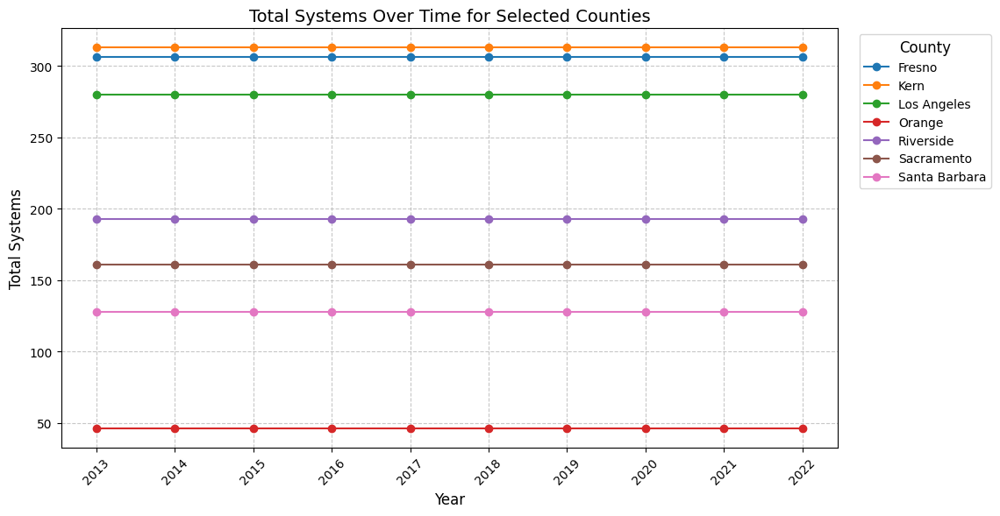

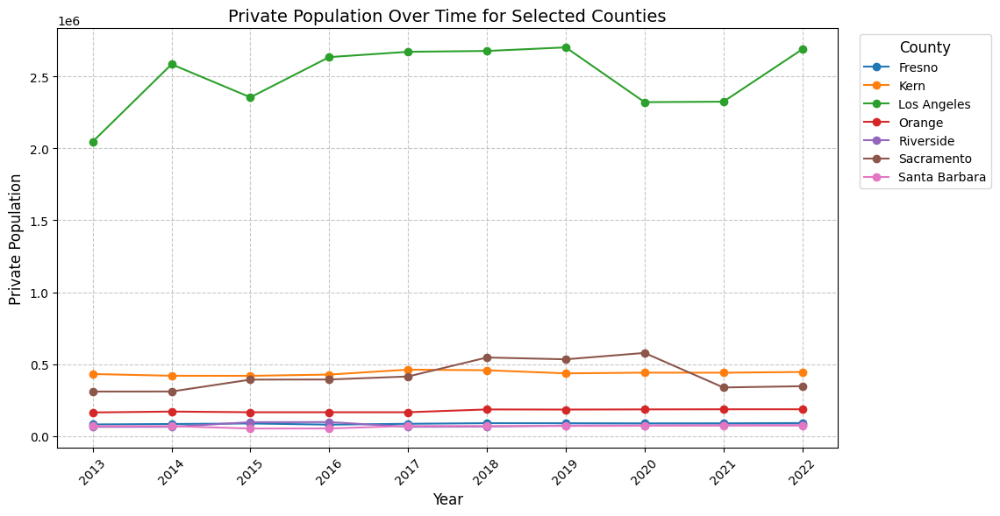

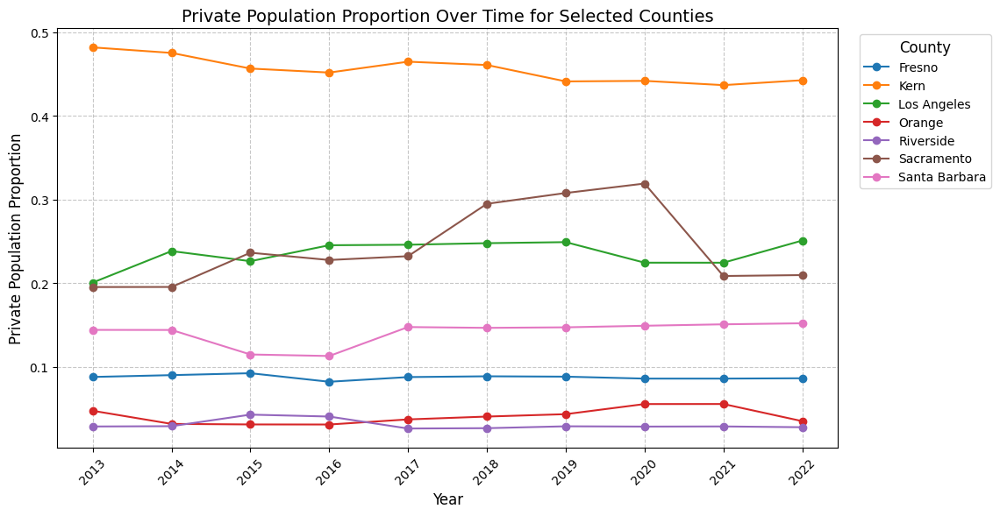

In [186]:
# Display the dropdown menus and button
# CMD + Click to select multiple
display(county_dropdown)
display(variable_dropdown)
display(visualize_button)

## Variable Maps

In [187]:
# Function to load the geo data
def load_data(shapefile_url):
    ca_counties = gpd.read_file(shapefile_url)
    ca_counties['created_at'] = ca_counties['created_at'].astype(str)
    ca_counties['updated_at'] = ca_counties['updated_at'].astype(str)
    ca_counties.rename(columns={'name': 'COUNTY'}, inplace=True)
    return ca_counties

In [188]:
# Use the function to load the shapefile
shapefile_url = 'https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/california-counties.geojson'
ca_counties = load_data(shapefile_url)

In [189]:
# Function to create county variable map
def create_county_var_map(data, ca_counties, year, var_name):
    county_var_data = data[data['YEAR_FAC'] == year].set_index('COUNTY')[var_name].to_dict()
    ca_counties_merged = ca_counties.copy()
    ca_counties_merged[var_name] = ca_counties_merged['COUNTY'].map(county_var_data)

    m = folium.Map(location=[37.7749, -122.4194], zoom_start=6)

    folium.Choropleth(
        geo_data=ca_counties_merged,
        name=f'{var_name}',
        data=ca_counties_merged,
        columns=['COUNTY', var_name],
        key_on='feature.properties.COUNTY',
        fill_color='YlOrRd',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name=f'{var_name}'
    ).add_to(m)

    # Add a legend using FloatImage
    legend_html = '''
    <div style="position: fixed; bottom: 50px; left: 50px; width: 150px; height: 90px;
    border:2px solid grey; z-index:9999; font-size:14px;
    ">&nbsp; {var_name} <br>
    <img src="https://i.imgur.com/1p98DKX.png" style="width: 100%">
    </div>
    '''.format(var_name=var_name)
    FloatImage(legend_html, bottom=50, left=50).add_to(m)

    return m

In [190]:
# Create year dropdown
year_dropdown = widgets.Dropdown(
    options=data_county['YEAR_FAC'].unique(),
    description='Select Year:',
    value=data_county['YEAR_FAC'].astype(int).min()
)

# Create variable dropdown
county_vars = [col for col in data_county.columns if col not in ['COUNTY', 'YEAR_FAC']]
var_dropdown = widgets.Dropdown(
    options=county_vars,
    description='Select Variable:',
    value=county_vars[0],
    layout=widgets.Layout(width='250px')
)

# Set output
county_var_map_output = widgets.Output()

In [191]:
# Functions to update county variable map
def update_county_var_map(year, var_name):
    with county_var_map_output:
        county_var_map_output.clear_output()
        m = create_county_var_map(data_county, ca_counties, year, var_name)
        display(m)

def on_update(change):
    update_county_var_map(year_dropdown.value, var_dropdown.value)

year_dropdown.observe(on_update, names='value')
var_dropdown.observe(on_update, names='value')

display(year_dropdown)
display(var_dropdown)
display(county_var_map_output)

update_county_var_map(year_dropdown.value, var_dropdown.value)

Dropdown(description='Select Year:', options=(2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022), val…

Dropdown(description='Select Variable:', layout=Layout(width='250px'), options=('total_systems', 'private_syst…

Output()